In [1]:
import numpy as np
from scipy import linalg
from scipy.spatial.transform import Rotation as R
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import matplotlib.collections
import matplotlib.patches
import pg_fitter_tools as fit
import sk_geo_tools as geo
import cv2
import re
from collections import Counter

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [3]:
%matplotlib notebook

In [4]:
focal_length = [2.760529621789217e+03, 2.767014510543478e+03]
principle_point = [1.914303537872458e+03, 1.596386868474348e+03]
radial_distortion = [-0.2398, 0.1145]
tangential_distortion = [0, 0]
camera_matrix = fit.build_camera_matrix(focal_length, principle_point)
distortion = fit.build_distortion_array(radial_distortion, tangential_distortion)

In [5]:
# rotate about z so that light injectors are in +y dir and tank axis remains +z dir
theta = np.pi/2-np.arctan(768.14 / 1490.73)
rot2 = np.array([[np.cos(theta), -np.sin(theta), 0], [np.sin(theta), np.cos(theta), 0], [0, 0, 1]])
# rotate about x so that light injectors are in +z dir and tank axis is -y dir
# (in image coords, +y is directed down)
rot1 = np.array([[1, 0, 0], [0, 0, -1], [0, 1, 0]])
rot = np.matmul(rot1, rot2)
camera_rotation = cv2.Rodrigues(rot)[0]
camera_r = 1100.
camera_spacing = 120.
n_cameras = 10
camera_translations = np.array([[0., 424.+camera_spacing*i, -camera_r] for i in range(n_cameras)])
camera_rotations = np.repeat(camera_rotation[None, :, :], n_cameras, axis=0)

In [6]:
pmt_locations = fit.read_3d_feature_locations("parameters/SK_simtest_PMT_locations.txt", delimiter=" ")
bolt_count = 24
bolt_locations = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = {k: np.mean([bolt_locations[re.sub(r"-00$", "-" + str(i + 1).zfill(2), k)] for i in range(0, 24, 24//bolt_count)], axis=0)
                           for k in pmt_locations.keys()}

In [7]:
def get_ring_positions(bolt_locations, pmt_keys, bolt_count):
    return {k: np.mean([bolt_locations[re.sub(r"-00$", "-" + str(i + 1).zfill(2), k)] for i in range(0, 24, 24//bolt_count)], axis=0)
                           for k in pmt_keys}

In [8]:
def get_ring_orientations(bolt_positions, pmt_keys, bolt_count):
    ring_orientations = {}
    for k in pmt_keys:
        c, n = geo.fit_plane(np.array([bolt_positions[re.sub(r"-00$", "-" + str(b + 1).zfill(2), k)] for b in range(0, 24, 24//bolt_count)]))
        # flip normal if it is directed away from tank centre
        if np.dot(n,c) > 0:
            n = -n
        ring_orientations[k] = n
    return ring_orientations

In [9]:
def get_image_feature_locations(feature_positions, camera_matrix, distortion, camera_rotations, camera_translations):
    image_feature_locations = {
        i : {list(feature_positions.keys())[f]:v for f, v in enumerate(cv2.projectPoints(np.array(list(feature_positions.values())), r, t, camera_matrix, distortion)[0].reshape((-1,2)))
             if v[0] > 0 and v[0] < 4000 and v[1] > 0 and v[1] < 3000}
        for i, (r, t) in enumerate(zip(camera_rotations, camera_translations))}
    feature_counts = Counter([f for i in image_feature_locations.values() for f in i.keys()])
    print("Feature in image counts:", Counter(feature_counts.values()))
    return image_feature_locations

In [10]:
def get_smeared_feature_locations(image_feature_locations, pixel_error):
    smeared_feature_locations = {}
    for k, i in image_feature_locations.items():
        smeared_feature_locations[k] = {}
        for j, f in i.items():
            smeared = np.random.normal(f, pixel_error/np.sqrt(2.)) # divide by sqrt(2) because it's being smeared in 2D
            if(smeared[0] > 0 and smeared[0] < 4000 and smeared[1] > 0 and smeared[1] < 3000):
                smeared_feature_locations[k][j] = smeared
    smeared_feature_counts = Counter([f for i in smeared_feature_locations.values() for f in i.keys()])
    print("Smeared feature in image counts:", Counter(smeared_feature_counts.values()))
    return smeared_feature_locations

In [11]:
def setup_bolt_simulation(feature_positions, image_feature_locations, focal_length, principle_point, radial_distortion, seed_error=1):
    seed_feature_positions = {}
    for i, f in feature_positions.items():
        seed_feature_positions[i] = np.random.normal(f, seed_error)
    fitter = fit.PhotogrammetryFitter(image_feature_locations, seed_feature_positions, focal_length, principle_point, radial_distortion)
    return fitter

In [12]:
def plot_images(image_feature_locations):
    for i in image_feature_locations.values():
        fig, ax = plt.subplots(figsize=(12,9))
        coords = np.rint(np.stack(list(i.values())))
        ax.scatter(coords[:,0], -coords[:,1], marker='s', s=0.2)
        ax.set_xlim((0, 4000))
        ax.set_ylim((-3000, 0))
        ax.axes.xaxis.set_visible(False)
        ax.axes.yaxis.set_visible(False)
        fig.tight_layout()

In [13]:
def run_bolt_fit(fitter, bolt_positions):
    reco_cam_rotations, reco_cam_translations, reprojected_points = fitter.estimate_camera_poses()
    reco_cam_rotations, reco_cam_translations, reco_locations = fitter.bundle_adjustment(reco_cam_rotations, reco_cam_translations)
    
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_locations)
    print("mean reconstruction error:", linalg.norm(reco_errors, axis=1).mean())
    print("max reconstruction error:", linalg.norm(reco_errors, axis=1).max())

    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(reco_cam_rotations, reco_cam_translations)
    cam_orientations_transformed = np.matmul(R, reco_cam_orientations)
    cam_positions_translated = reco_cam_positions - translation
    cam_positions_transformed = scale*R.dot(cam_positions_translated.transpose()).transpose()

    reco_bolt_positions = reco_positions_dict(reco_transformed, fitter.feature_index)
    position_errors = linalg.norm(reco_errors, axis=1)

    return reco_bolt_positions, position_errors

In [14]:
def reco_positions_dict(reco_positions, feature_index):
    return {f: reco_positions[i] for f, i in feature_index.items()}

In [15]:
def get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count):
    reco_ring_positions = get_ring_positions(reco_bolt_positions, ring_positions.keys(), bolt_count)
    errors = np.array([linalg.norm(reco_ring_positions[k] - ring_positions[k]) for k in ring_positions.keys()])
    return errors

In [16]:
def get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count):
    reco_orientations = get_ring_orientations(reco_bolt_positions, ring_orientations.keys(), bolt_count)
    errors = np.array([np.degrees(np.arccos(np.dot(reco_orientations[k], ring_orientations[k]))) for k in ring_orientations.keys()])
    return errors

In [17]:
def make_fig(title, xlabel, figsize=(8,6)):
    fig, ax = plt.subplots(figsize=figsize)
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    fig.tight_layout()
    return fig, ax

In [18]:
def plot_reconstruction(reco_positions, cam_positions):
    fig = plt.figure(figsize=(12,9))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(reco_positions[:,0], reco_positions[:,1], reco_positions[:,2], marker='^', label="LED", s=1)
    ax.scatter(cam_positions[:,0], cam_positions[:,1], cam_positions[:,2], marker='*', label="Camera", s=60)
    plt.legend(loc=0)
    fig.tight_layout()

# Simulation with 24 bolts

Feature in image counts: Counter({5: 890, 6: 724, 4: 462, 3: 438, 2: 264, 1: 102})


<IPython.core.display.Javascript object>


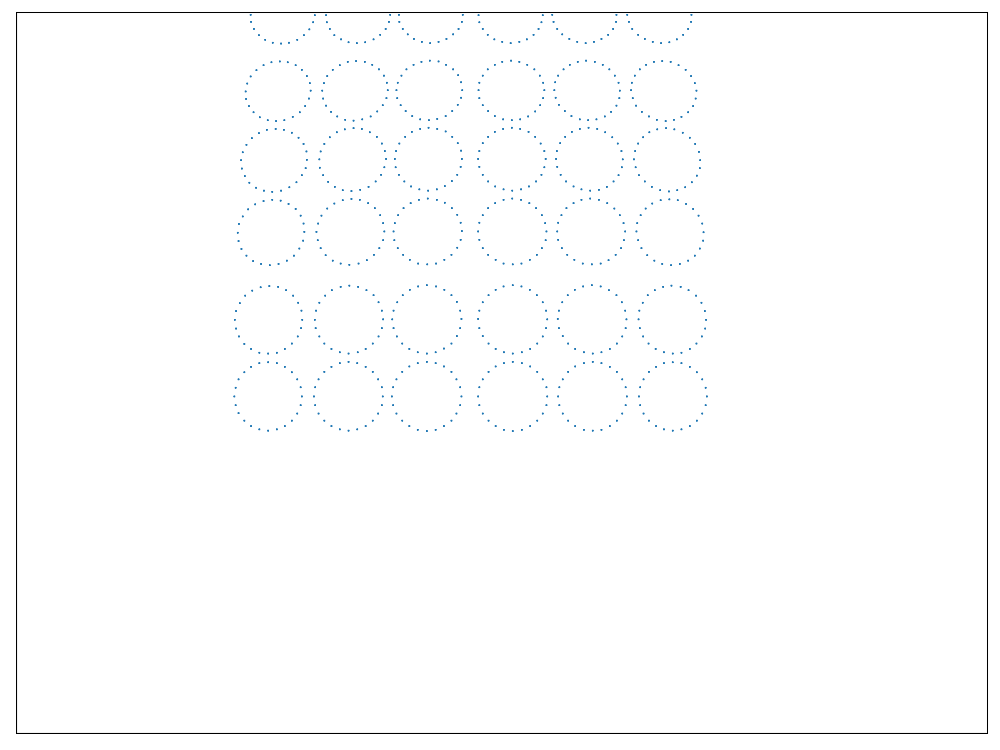

<IPython.core.display.Javascript object>


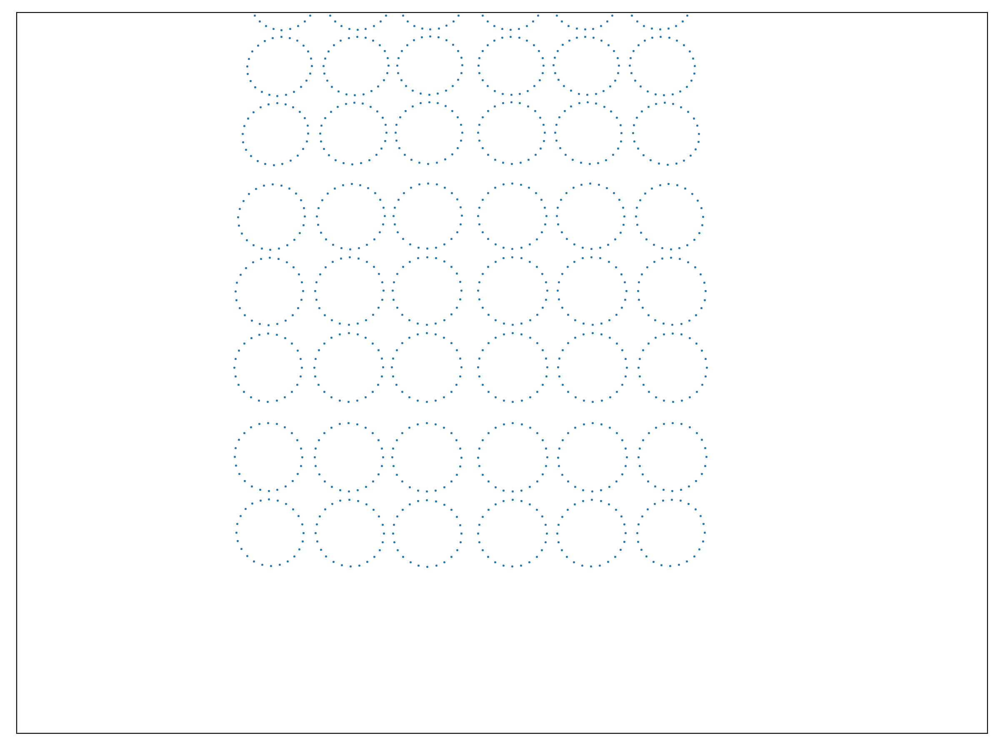

<IPython.core.display.Javascript object>


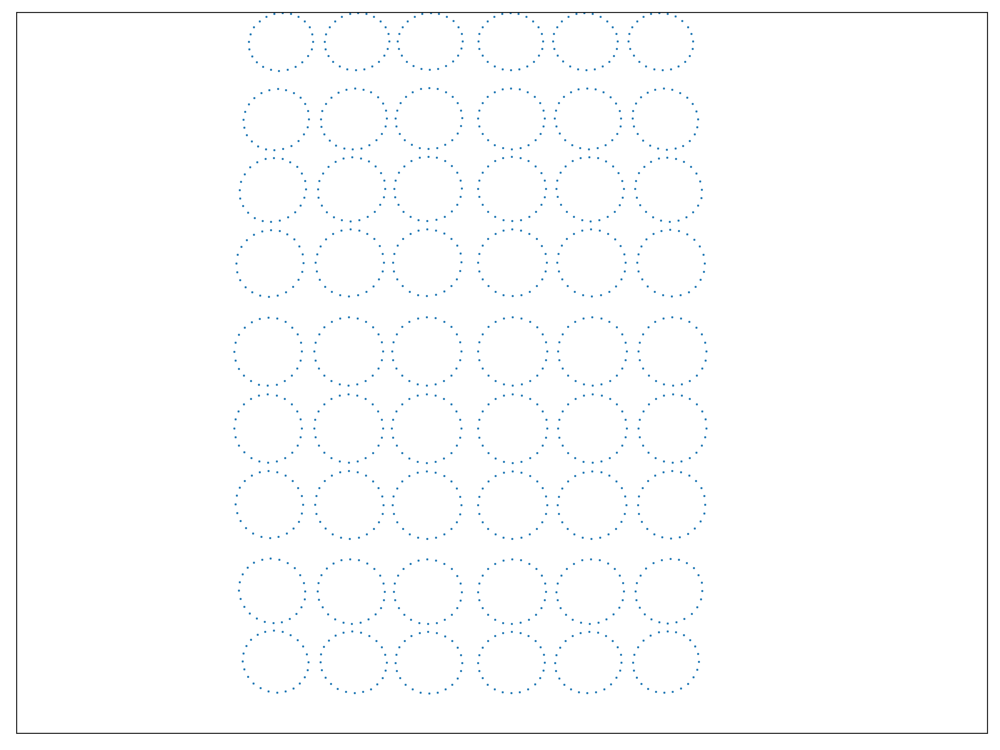

<IPython.core.display.Javascript object>


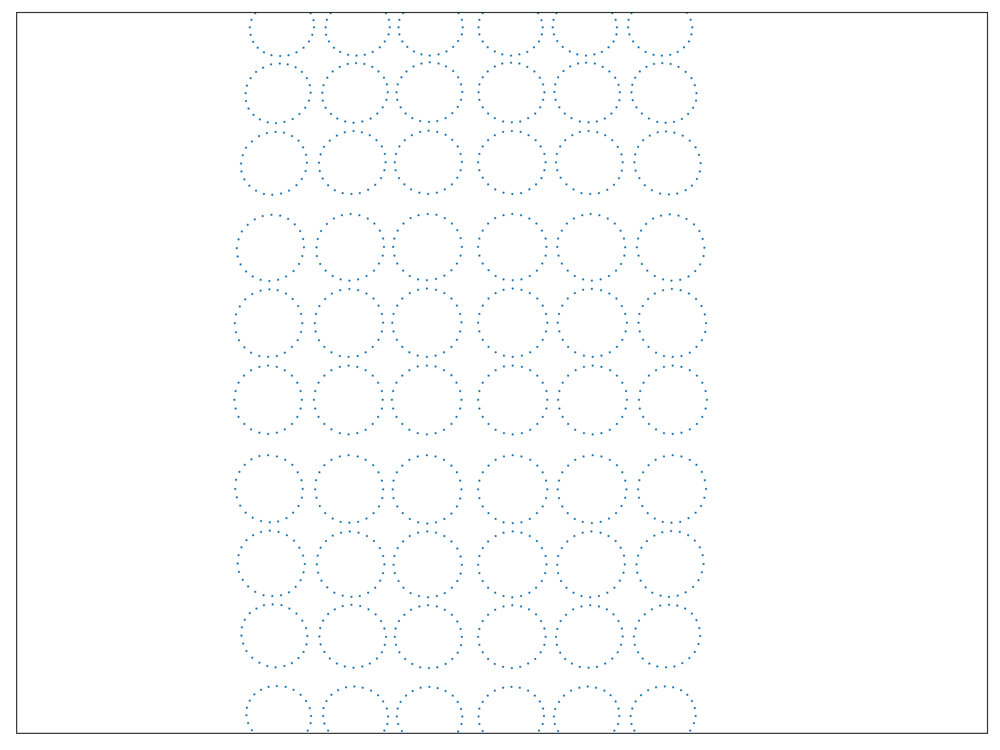

<IPython.core.display.Javascript object>


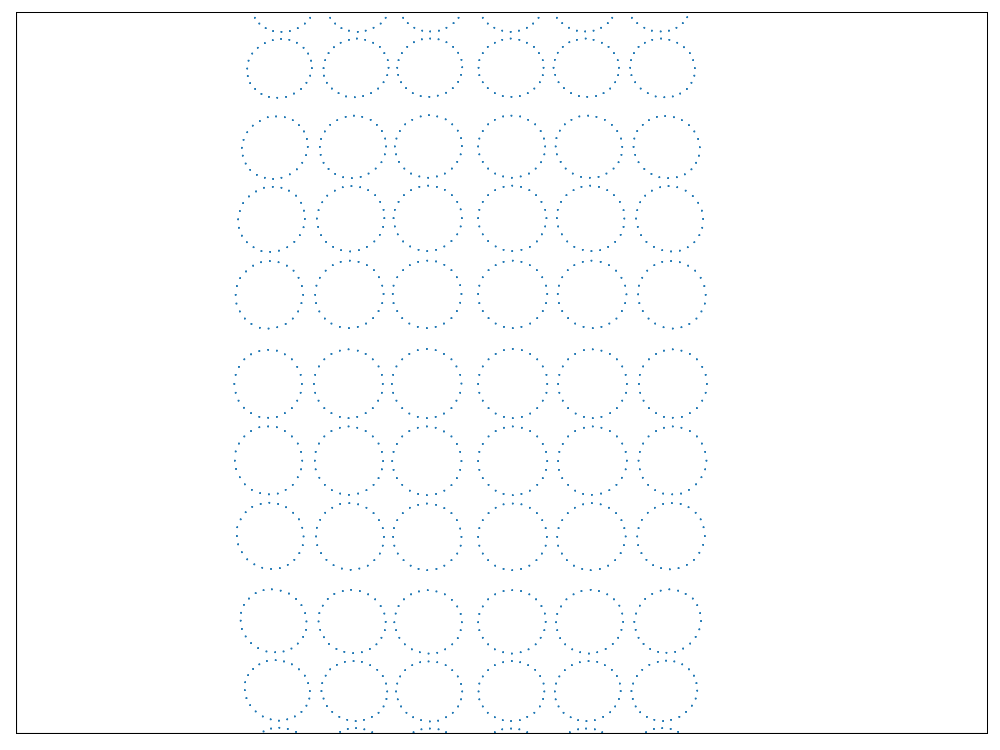

<IPython.core.display.Javascript object>


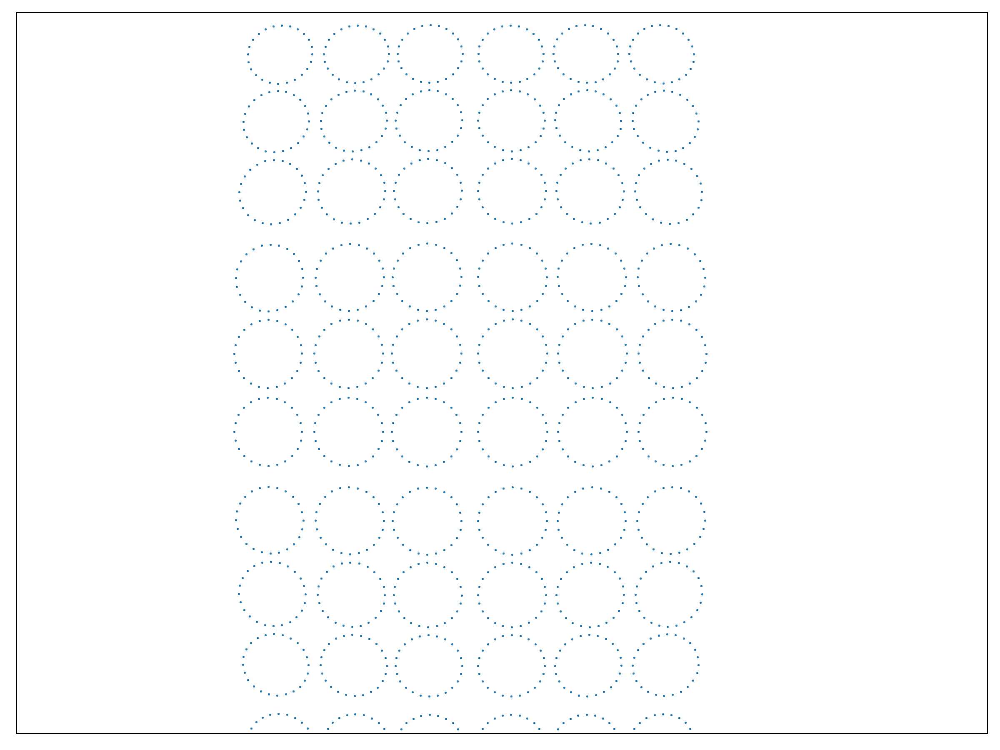

<IPython.core.display.Javascript object>


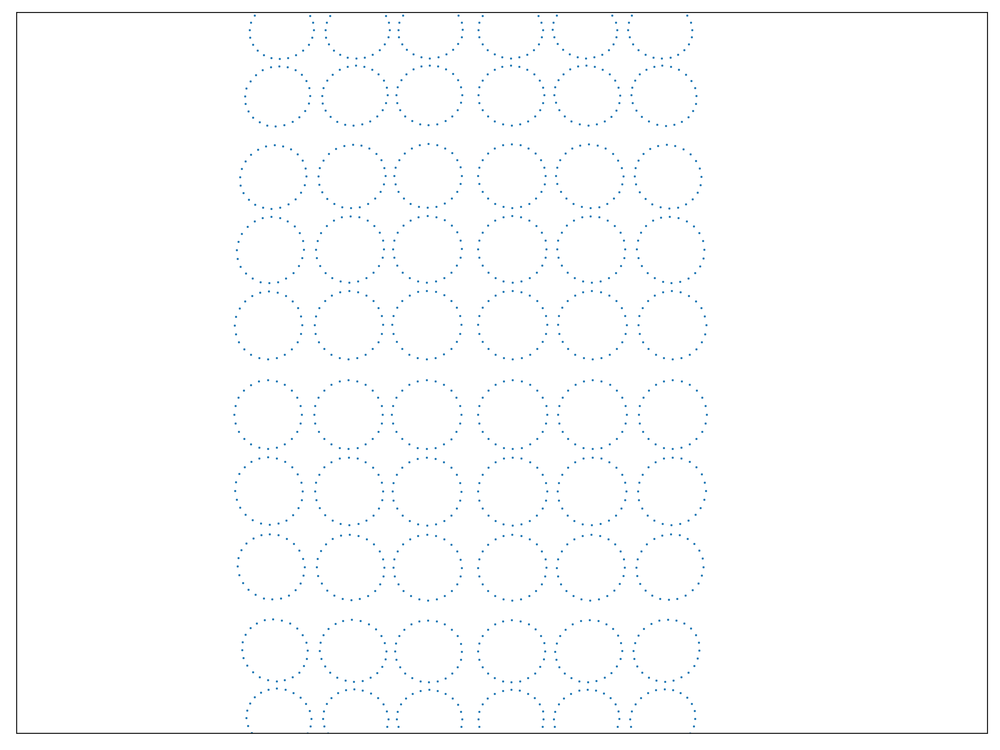

<IPython.core.display.Javascript object>


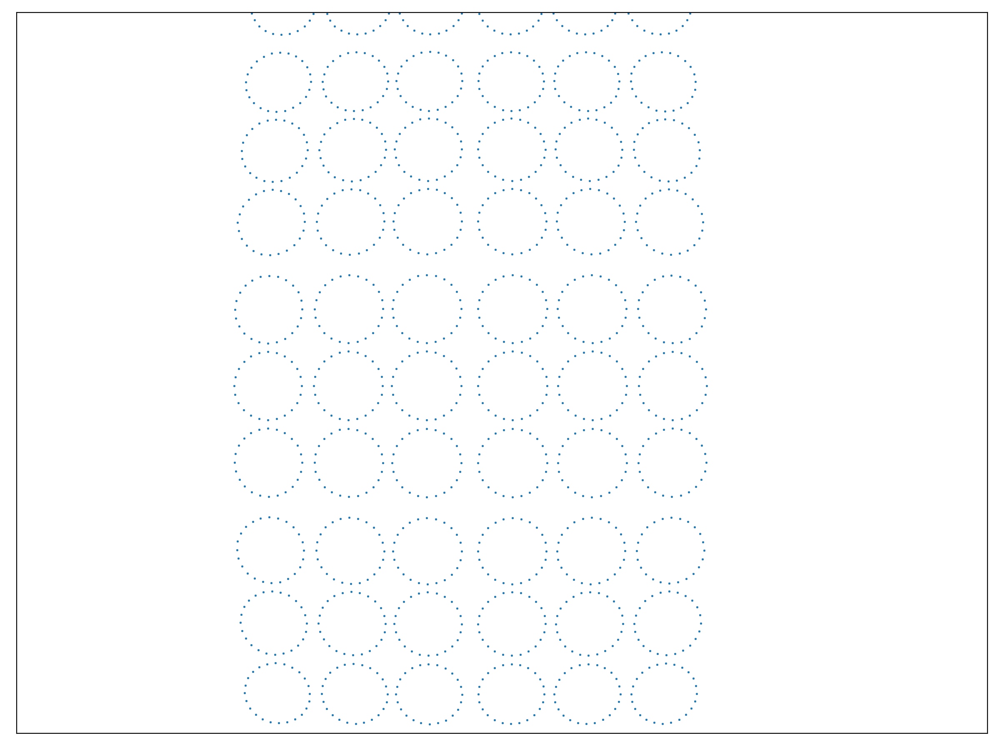

<IPython.core.display.Javascript object>


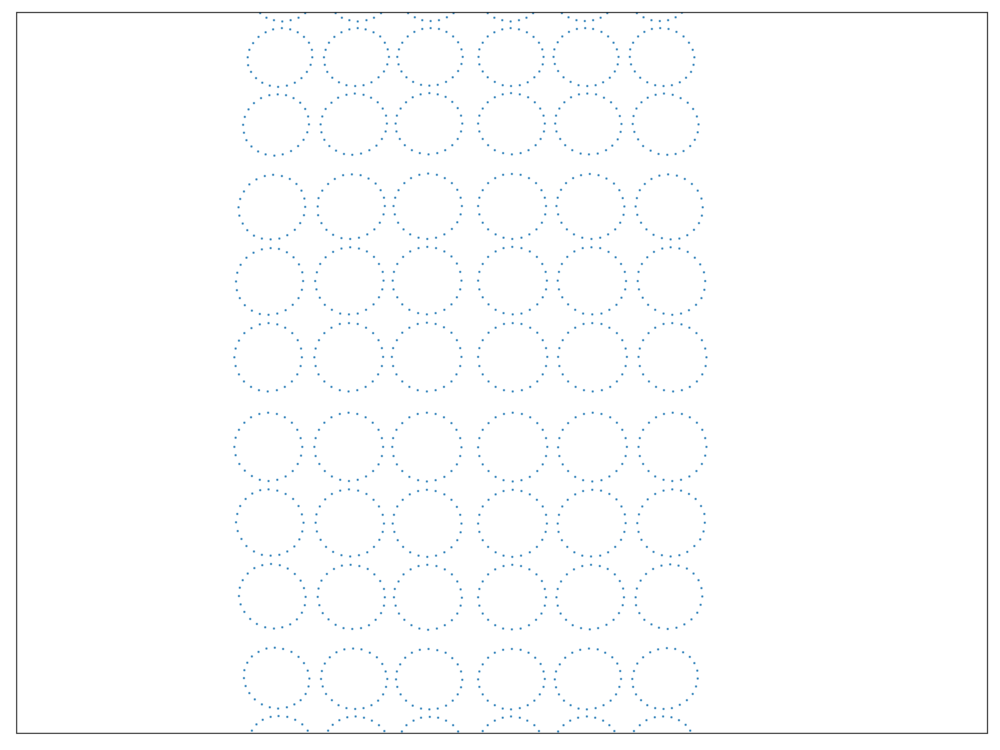

<IPython.core.display.Javascript object>


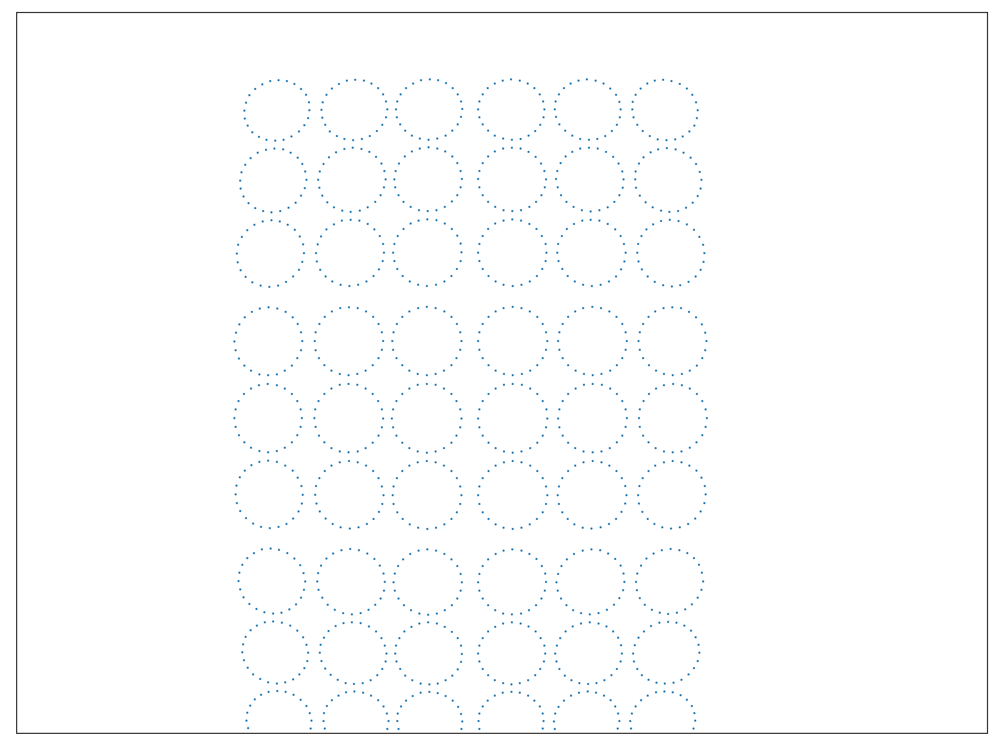

In [19]:
bolt_count = 24
bolt_positions = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = get_ring_positions(bolt_positions, pmt_locations.keys(), bolt_count)
ring_orientations = get_ring_orientations(bolt_positions, pmt_locations.keys(), bolt_count)
image_feature_locations = get_image_feature_locations(bolt_positions, camera_matrix, distortion, camera_rotations, camera_translations)
plot_images(image_feature_locations)

<IPython.core.display.Javascript object>


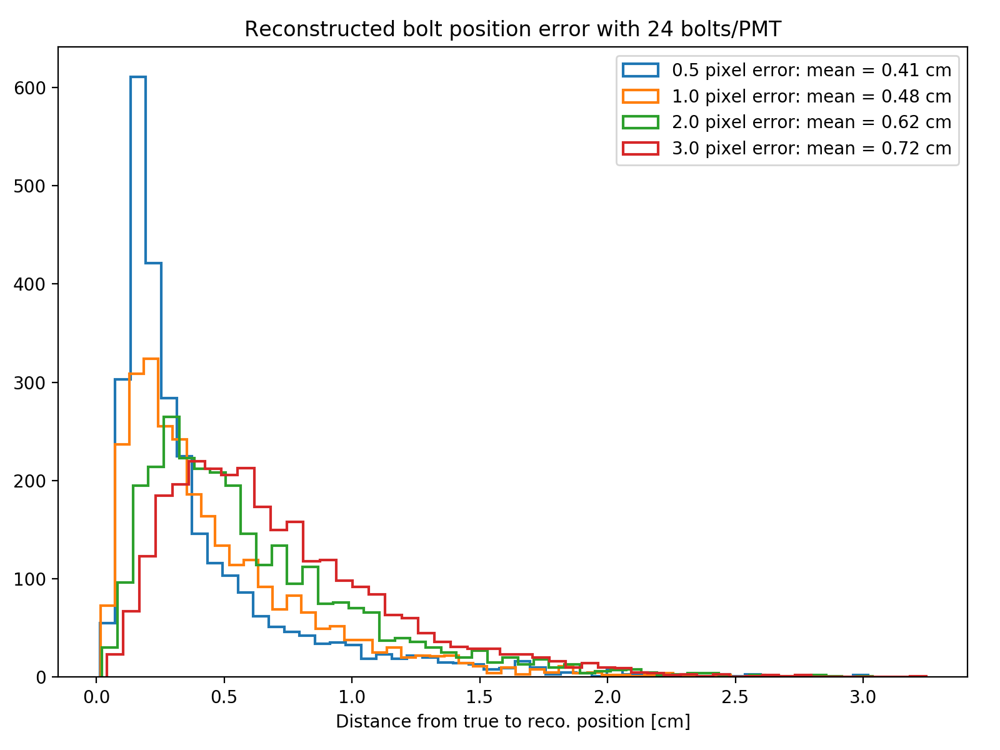

<IPython.core.display.Javascript object>


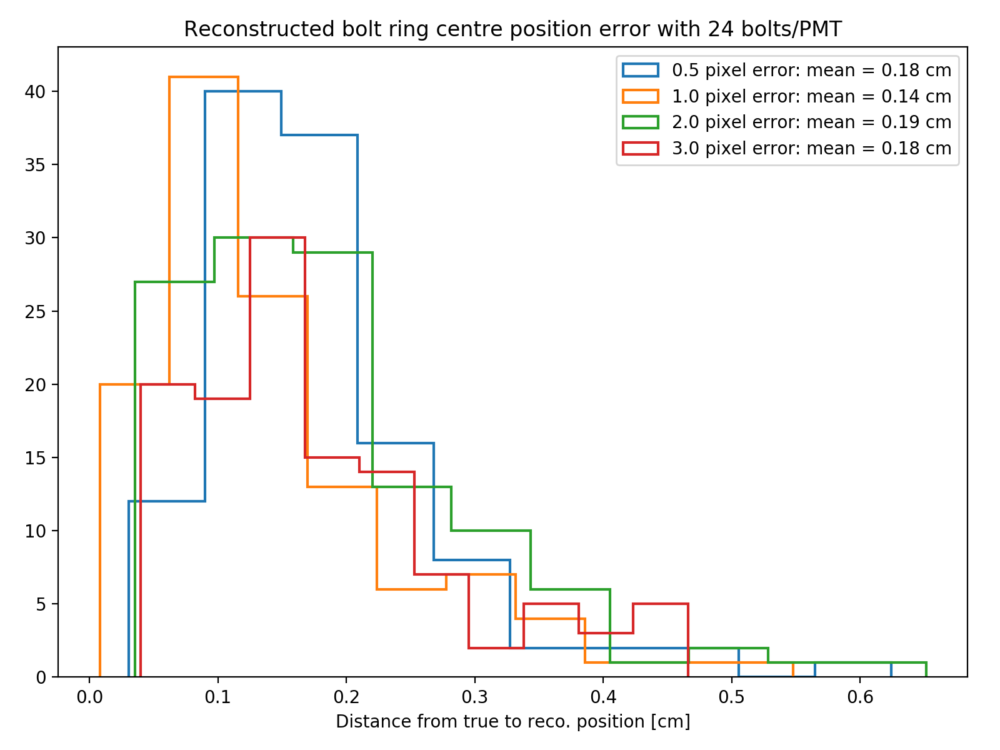

<IPython.core.display.Javascript object>


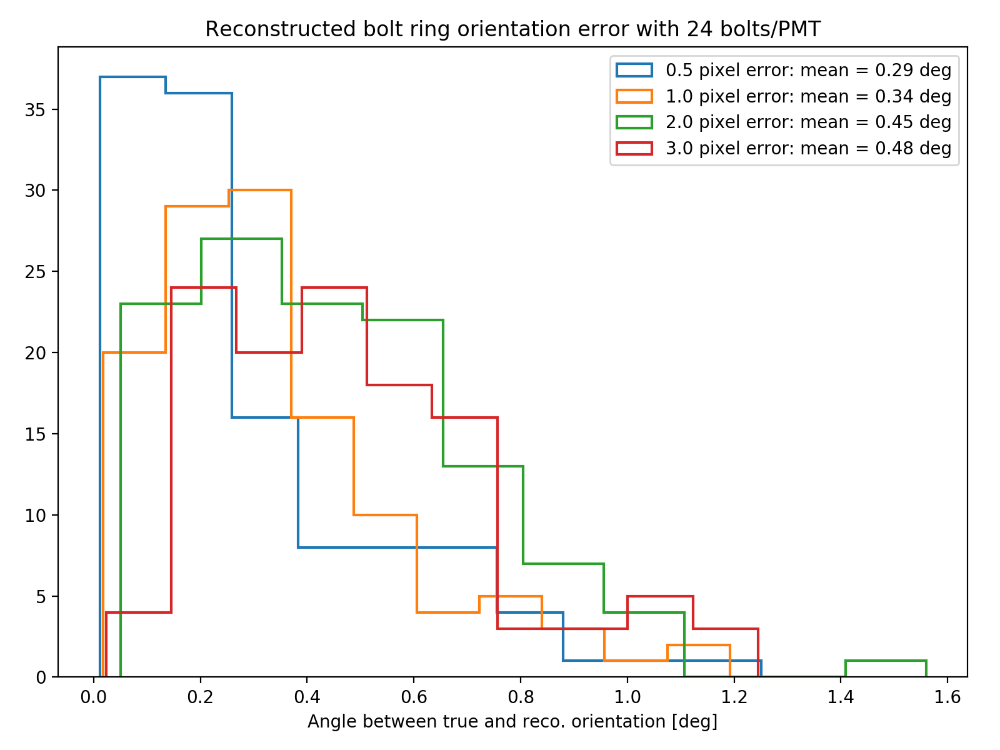

=== Gaussian errors on feature image locations: 0.5 ===
Smeared feature in image counts: Counter({5: 890, 6: 724, 4: 462, 3: 438, 2: 263, 1: 103})
image 0 reprojection errors:    average: 5.786432149469436    max: 17.4909477351861
image 1 reprojection errors:    average: 5.814294298168169    max: 17.770764694653835
image 2 reprojection errors:    average: 5.949397318918555    max: 17.518183091605994
image 3 reprojection errors:    average: 5.937289717832449    max: 18.07577098481157
image 4 reprojection errors:    average: 6.274869681142838    max: 19.8731906007737
image 5 reprojection errors:    average: 6.000672946402296    max: 19.57430984269362
image 6 reprojection errors:    average: 6.042799899809976    max: 19.22187852111117
image 7 reprojection errors:    average: 5.959589978665025    max: 18.63862168874435
image 8 reprojection errors:    average: 5.909989403491617    max: 17.12522990802513
image 9 reprojection errors:    average: 5.7658669497494035    max: 17.511015081978297
 

<IPython.core.display.Javascript object>


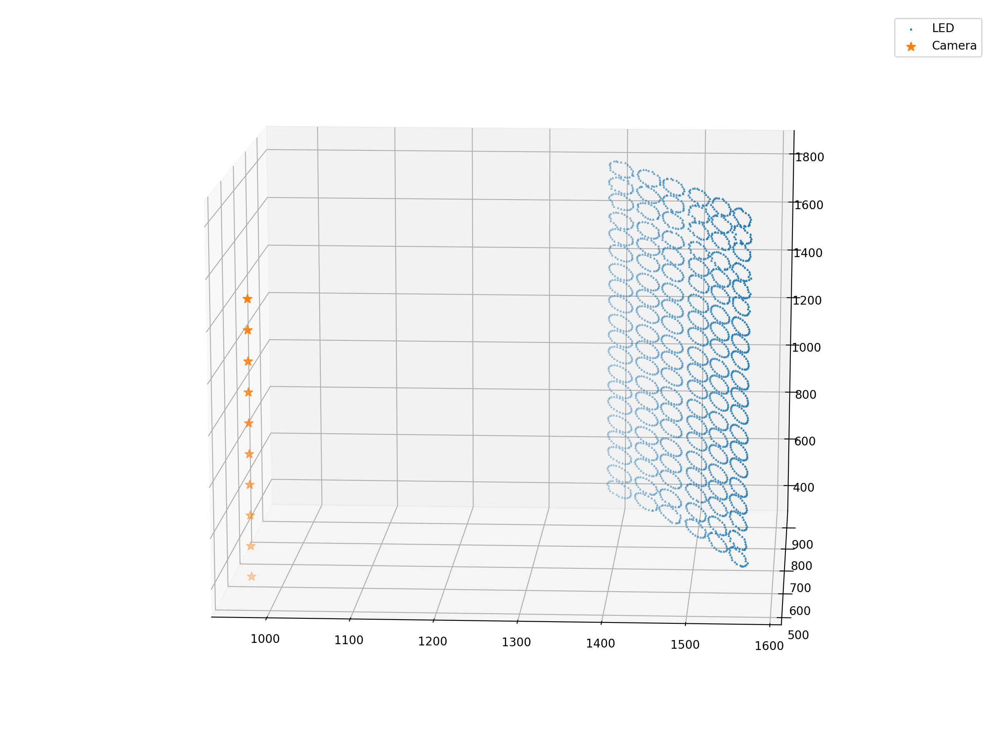

=== Gaussian errors on feature image locations: 1.0 ===
Smeared feature in image counts: Counter({5: 892, 6: 722, 4: 462, 3: 438, 2: 264, 1: 102})
image 0 reprojection errors:    average: 6.029447769878786    max: 20.376822324654857
image 1 reprojection errors:    average: 6.128422224497414    max: 20.305365818058235
image 2 reprojection errors:    average: 6.052581838647015    max: 19.589728582093162
image 3 reprojection errors:    average: 6.005058014472267    max: 20.600035666293923
image 4 reprojection errors:    average: 5.961800052989681    max: 22.295468284698423
image 5 reprojection errors:    average: 6.002958012637308    max: 23.524311890315705
image 6 reprojection errors:    average: 5.958458645739057    max: 21.319475228041767
image 7 reprojection errors:    average: 5.946297691221107    max: 20.304575197475405
image 8 reprojection errors:    average: 6.041175748483037    max: 19.64736261208657
image 9 reprojection errors:    average: 6.081343742761036    max: 19.0890419123

<IPython.core.display.Javascript object>


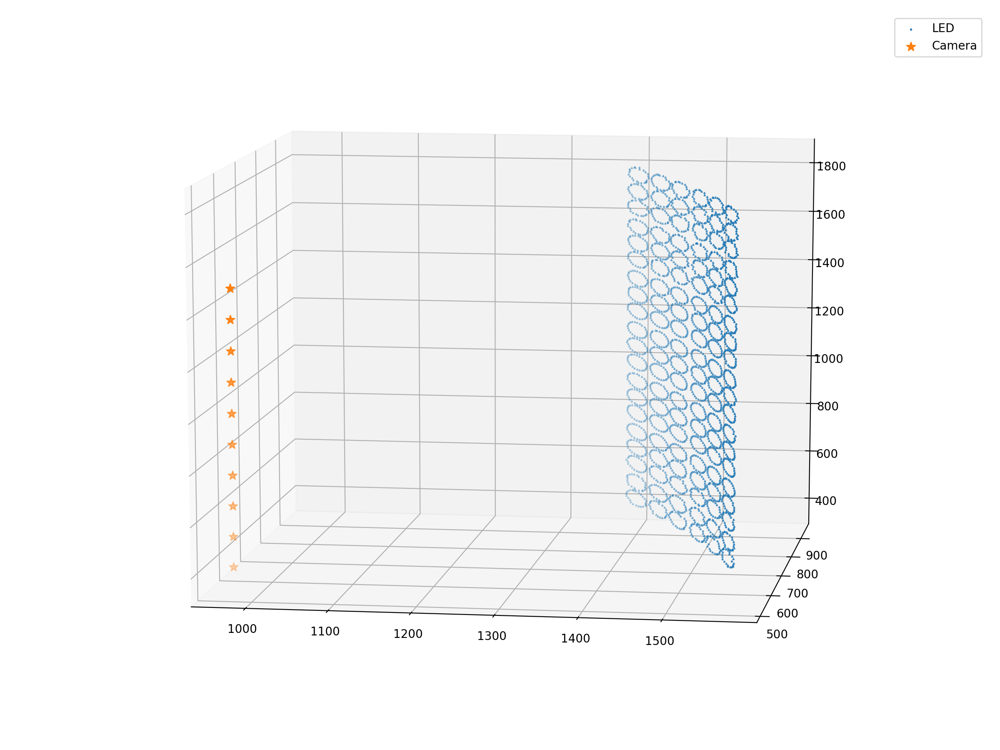

=== Gaussian errors on feature image locations: 2.0 ===
Smeared feature in image counts: Counter({5: 895, 6: 719, 4: 462, 3: 438, 2: 263, 1: 103})
image 0 reprojection errors:    average: 6.126172217432395    max: 20.054350598865614
image 1 reprojection errors:    average: 6.171422295865644    max: 19.717166561106783
image 2 reprojection errors:    average: 6.17948565724316    max: 19.366788500095332
image 3 reprojection errors:    average: 6.173099715073181    max: 19.432664287600613
image 4 reprojection errors:    average: 6.225396219828016    max: 17.569053341931323
image 5 reprojection errors:    average: 6.162177783344164    max: 17.996331223355156
image 6 reprojection errors:    average: 6.167022035723036    max: 18.763011275388614
image 7 reprojection errors:    average: 6.293989577237963    max: 21.20476669424328
image 8 reprojection errors:    average: 6.5111653494009305    max: 18.418921920010348
image 9 reprojection errors:    average: 6.358852841083844    max: 18.7417581198

<IPython.core.display.Javascript object>


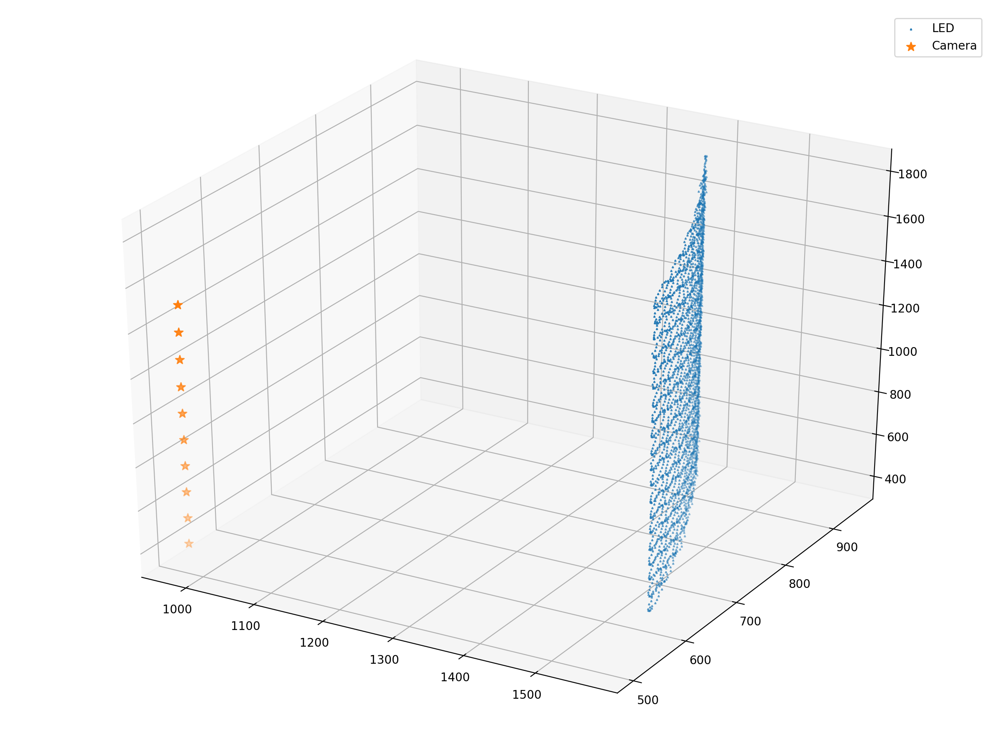

=== Gaussian errors on feature image locations: 3.0 ===
Smeared feature in image counts: Counter({5: 893, 6: 721, 4: 462, 3: 438, 2: 261, 1: 105})
image 0 reprojection errors:    average: 6.481458750286497    max: 18.806316300286475
image 1 reprojection errors:    average: 6.633941329474621    max: 19.308004898898858
image 2 reprojection errors:    average: 6.584413898549879    max: 22.40349082101231
image 3 reprojection errors:    average: 6.687502346370307    max: 18.592039262778
image 4 reprojection errors:    average: 6.432548738834435    max: 17.75863912581428
image 5 reprojection errors:    average: 6.549798454047749    max: 21.391605036656543
image 6 reprojection errors:    average: 6.432006046363006    max: 19.906313696696444
image 7 reprojection errors:    average: 6.5207759546726445    max: 20.90871889468299
image 8 reprojection errors:    average: 6.901005079581163    max: 21.195929252314443
image 9 reprojection errors:    average: 6.4945623074247605    max: 21.5354120133737

<IPython.core.display.Javascript object>


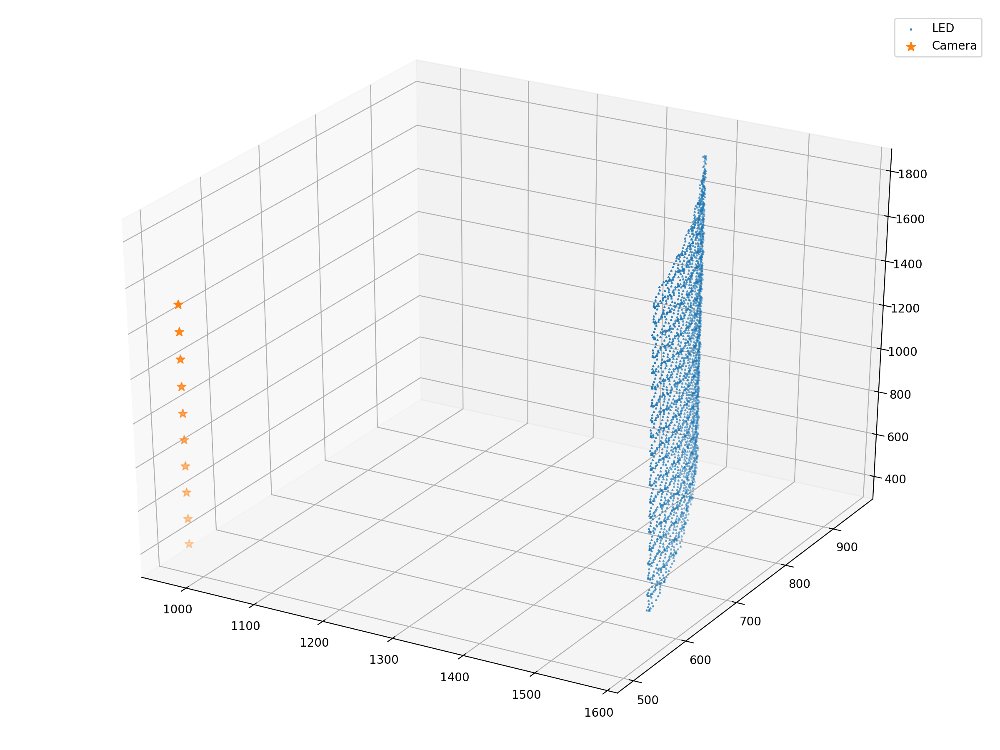

In [20]:
fig_bolt_pos, ax_bolt_pos = make_fig("Reconstructed bolt position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_pos, ax_ring_pos = make_fig("Reconstructed bolt ring centre position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_ang, ax_ring_ang = make_fig("Reconstructed bolt ring orientation error with {} bolts/PMT".format(bolt_count), "Angle between true and reco. orientation [deg]")
for pixel_error in [0.5, 1.0, 2.0, 3.0]:
    print("=== Gaussian errors on feature image locations:", pixel_error, "===")
    smeared_feature_locations = get_smeared_feature_locations(image_feature_locations, pixel_error)
    fitter = setup_bolt_simulation(bolt_positions, smeared_feature_locations, focal_length, principle_point, radial_distortion)    
    reco_bolt_positions, position_errors = run_bolt_fit(fitter, bolt_positions)
    centre_errors = get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count)
    orientation_errors = get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count)
    ax_bolt_pos.hist(position_errors, bins=50, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, position_errors.mean()))
    ax_ring_pos.hist(centre_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, centre_errors.mean()))
    ax_ring_ang.hist(orientation_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} deg".format(pixel_error, orientation_errors.mean()))
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_bolt_positions)
    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(fitter.camera_rotations, fitter.camera_translations)
    plot_reconstruction(reco_transformed, reco_cam_positions)
ax_bolt_pos.legend(loc='upper right')
ax_ring_pos.legend(loc='upper right')
ax_ring_ang.legend(loc='upper right')

# Simulation with 12 bolts

Feature in image counts: Counter({5: 434, 6: 376, 4: 234, 3: 210, 2: 132, 1: 54})


<IPython.core.display.Javascript object>


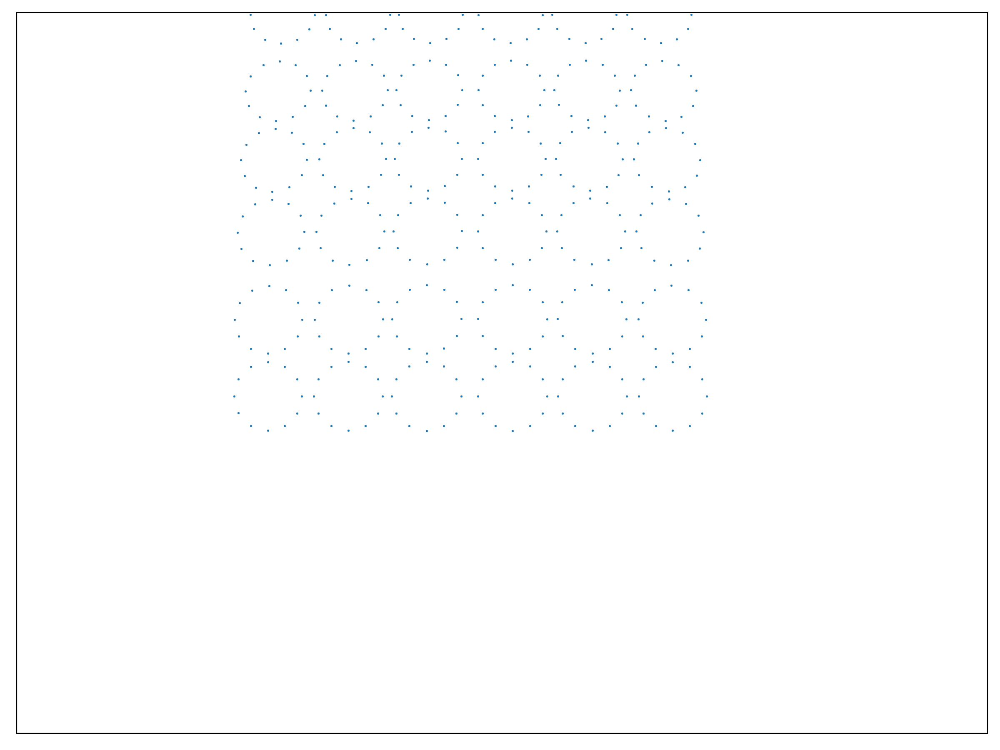

<IPython.core.display.Javascript object>


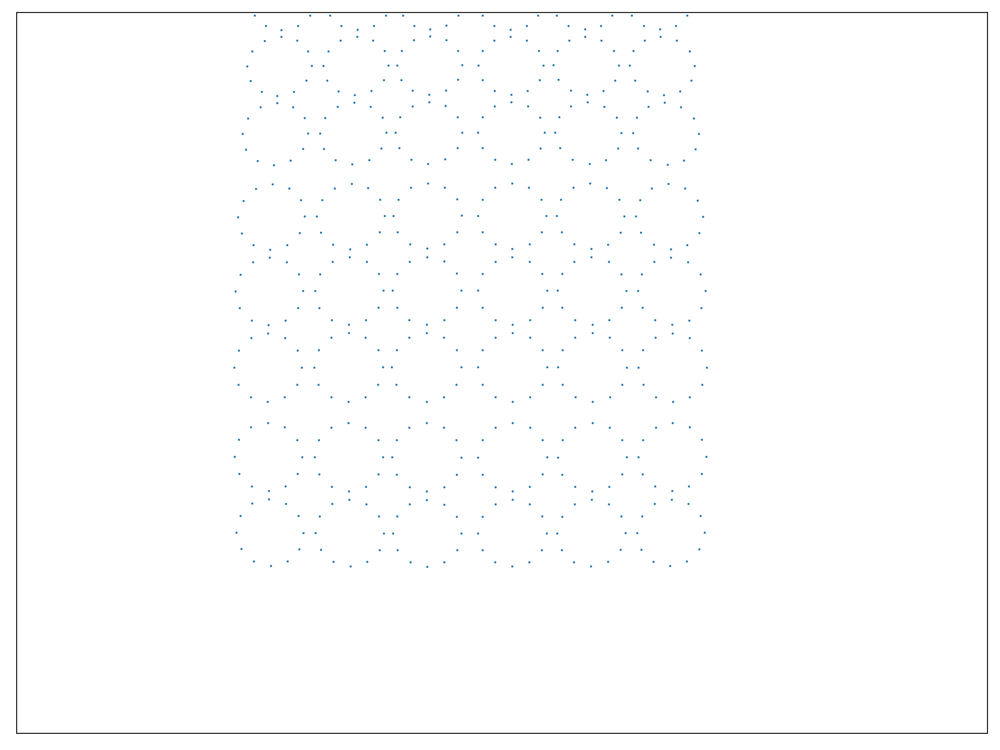

<IPython.core.display.Javascript object>


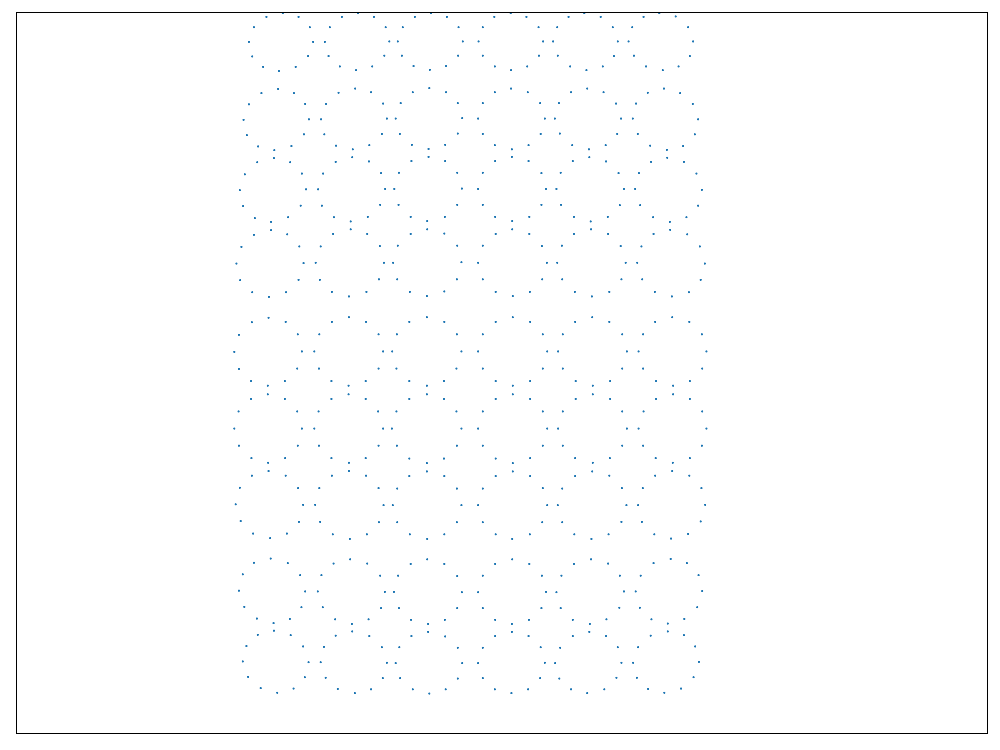

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


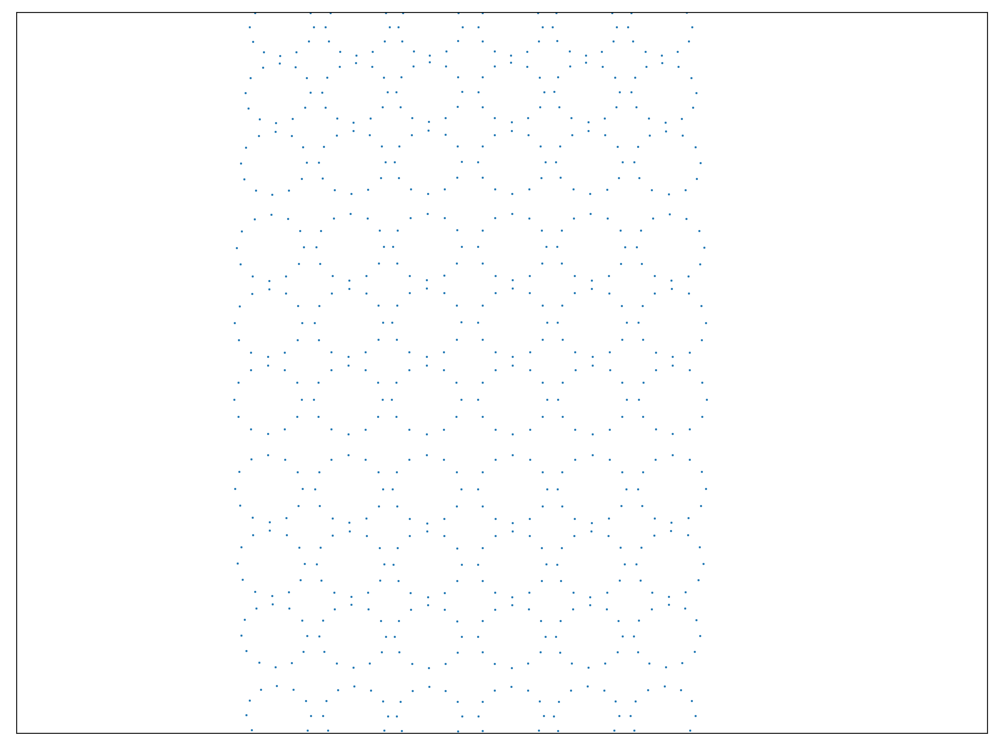

<IPython.core.display.Javascript object>


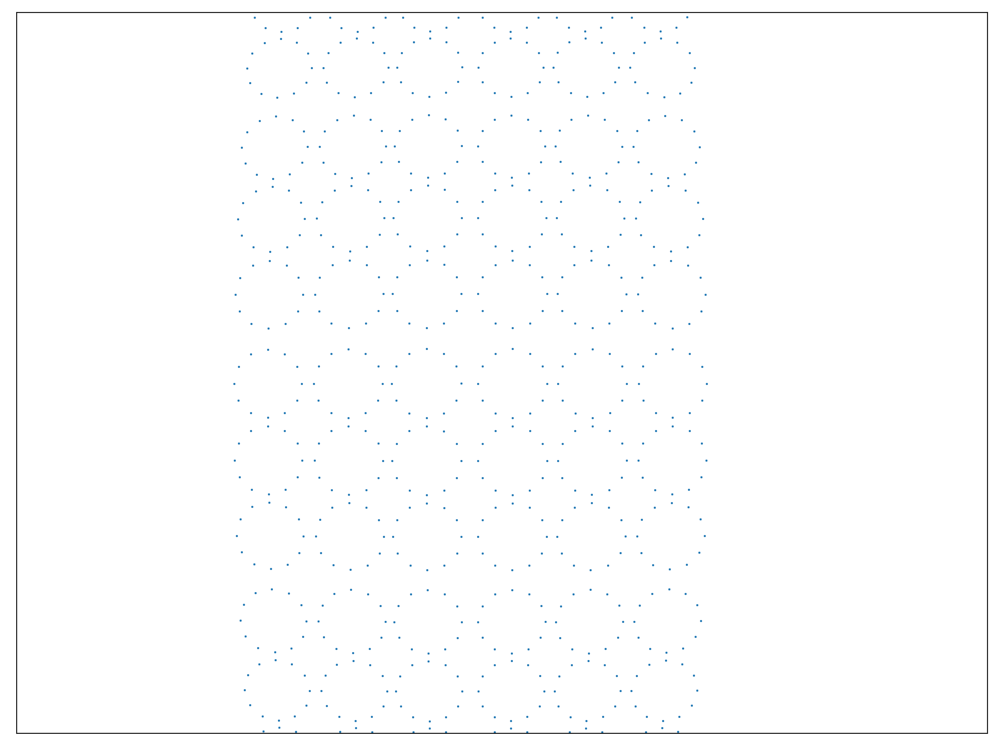

<IPython.core.display.Javascript object>


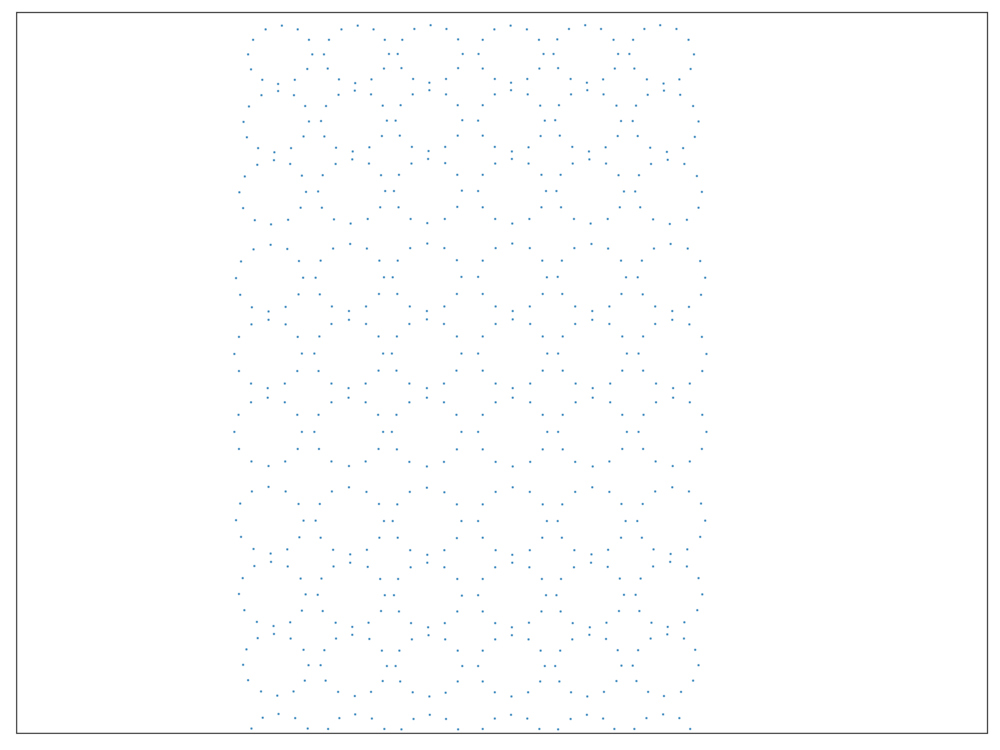

<IPython.core.display.Javascript object>


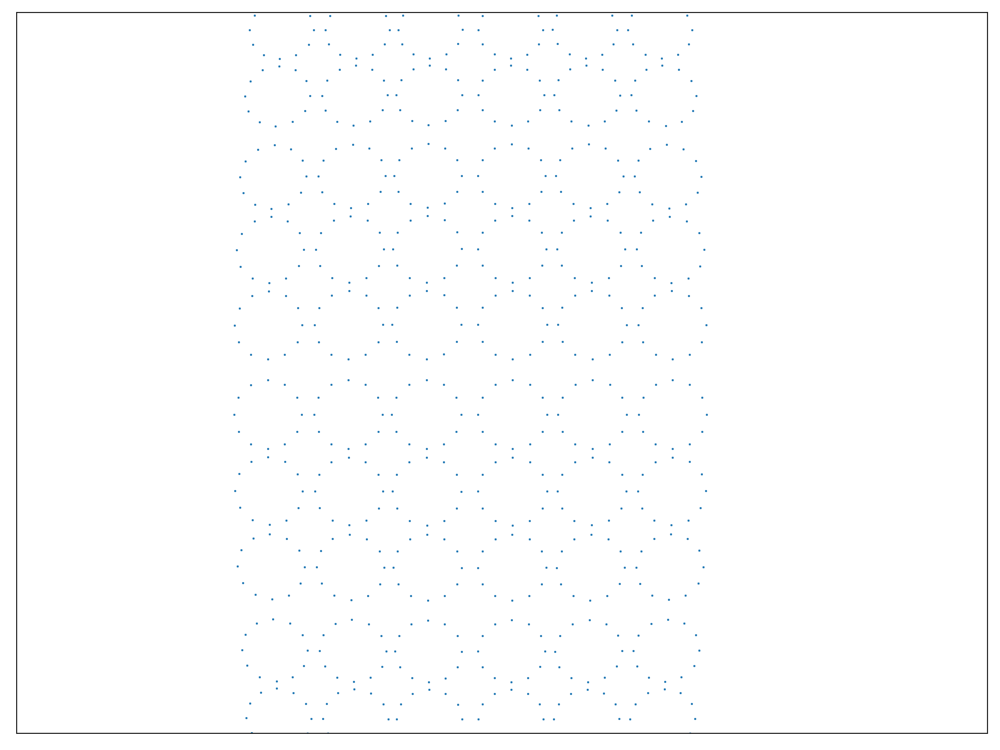

<IPython.core.display.Javascript object>


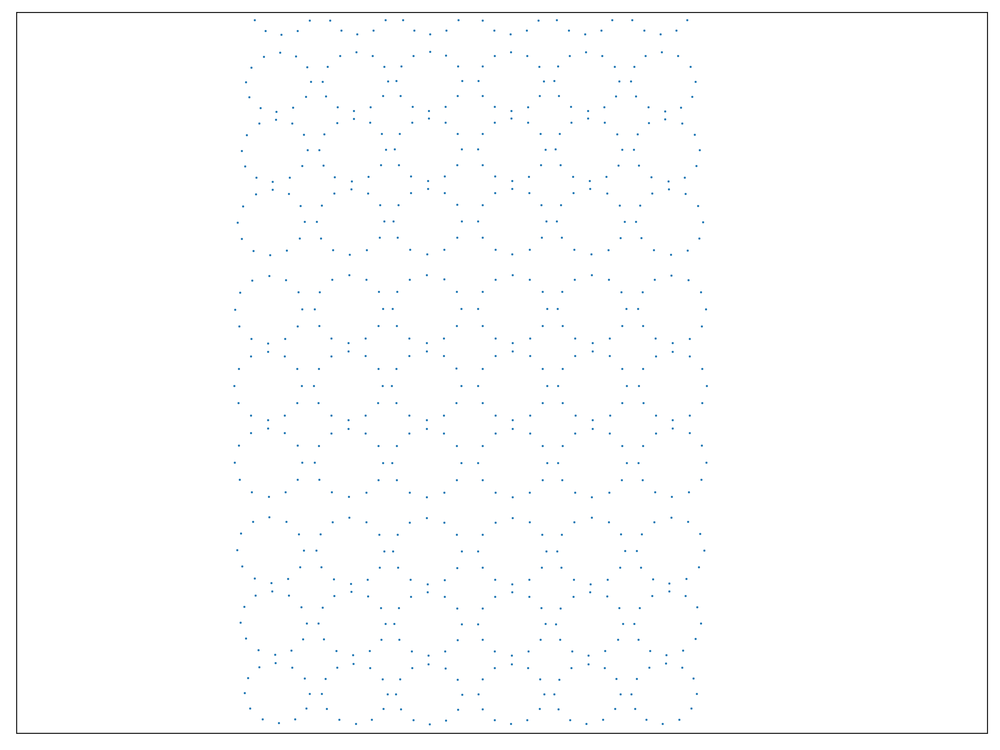

<IPython.core.display.Javascript object>


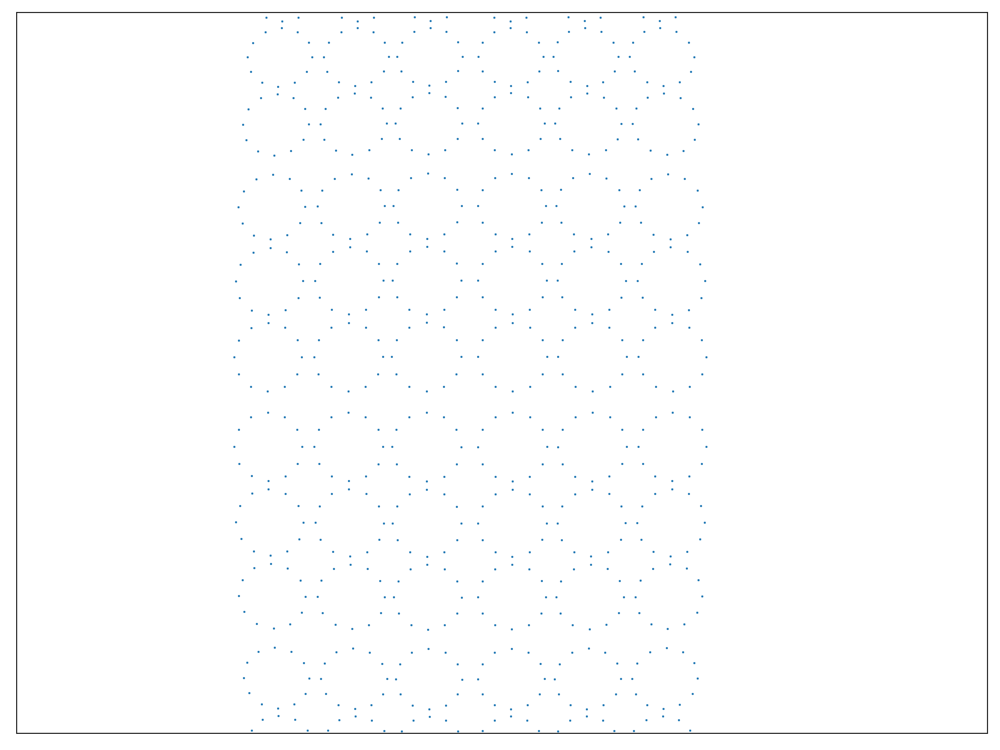

<IPython.core.display.Javascript object>


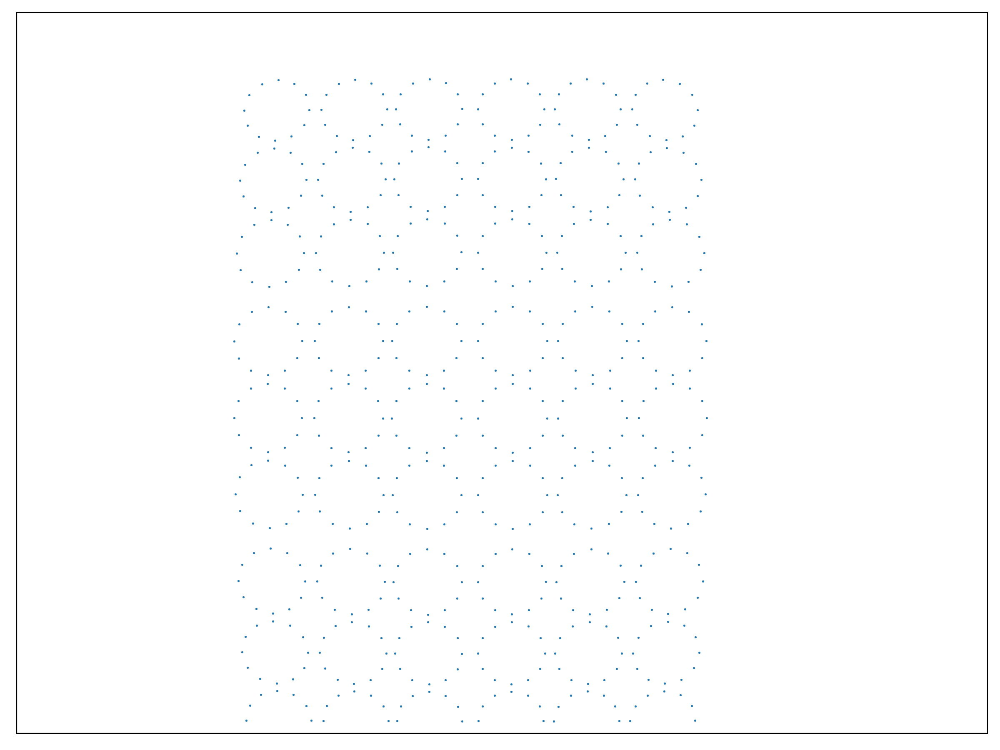

In [21]:
bolt_count = 12
bolt_positions = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = get_ring_positions(bolt_positions, pmt_locations.keys(), bolt_count)
ring_orientations = get_ring_orientations(bolt_positions, pmt_locations.keys(), bolt_count)
image_feature_locations = get_image_feature_locations(bolt_positions, camera_matrix, distortion, camera_rotations, camera_translations)
plot_images(image_feature_locations)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


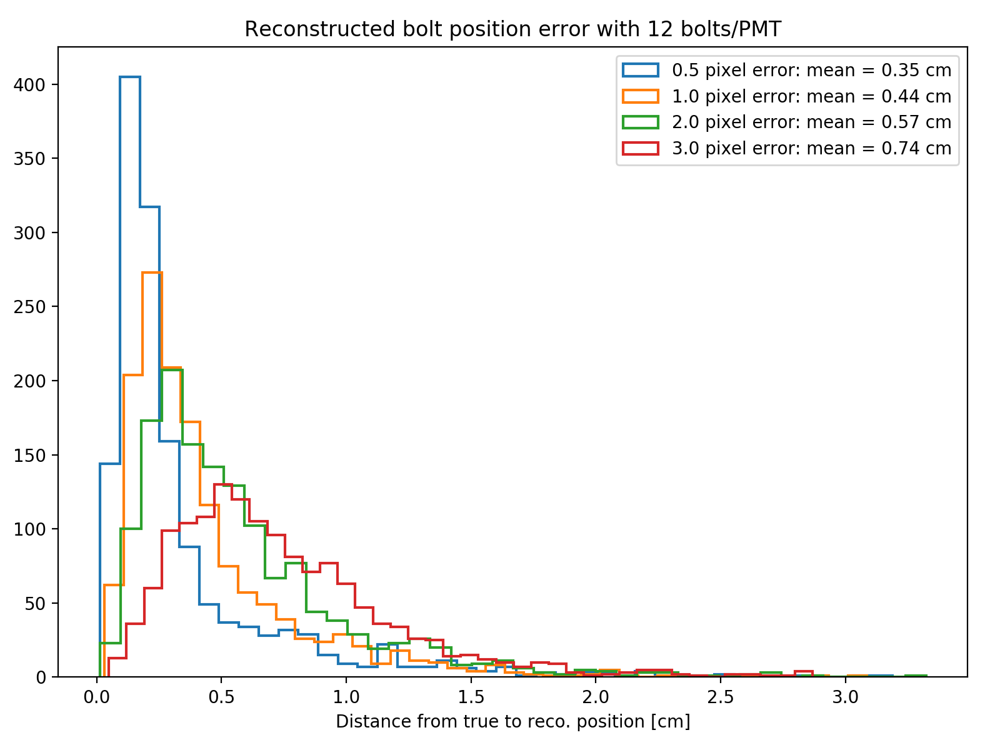

<IPython.core.display.Javascript object>


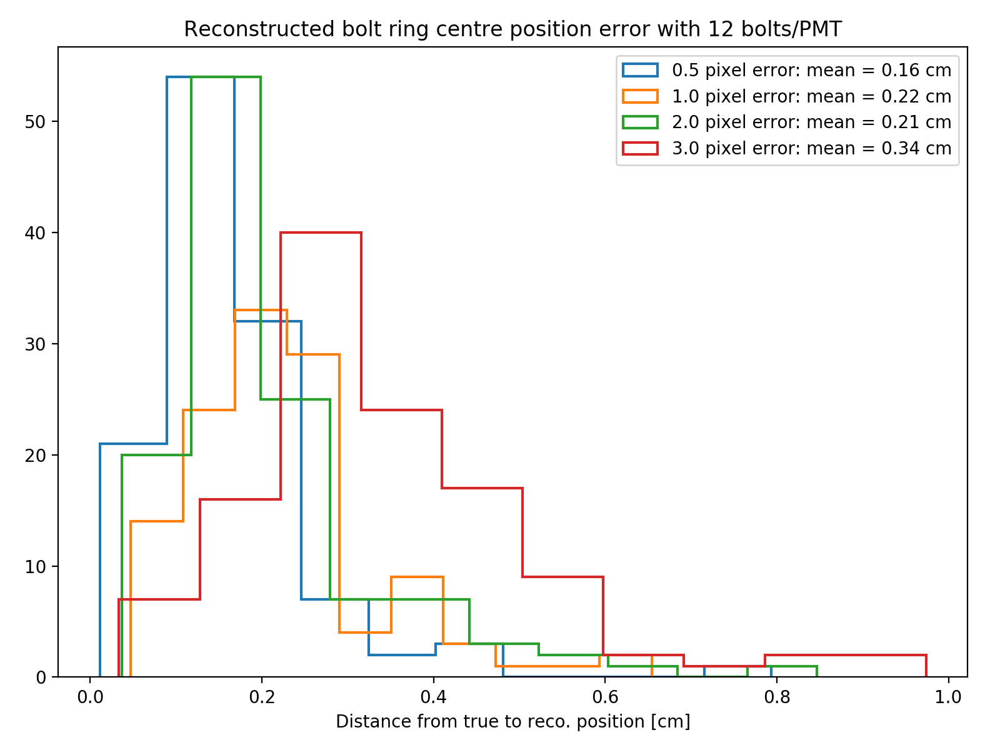

<IPython.core.display.Javascript object>


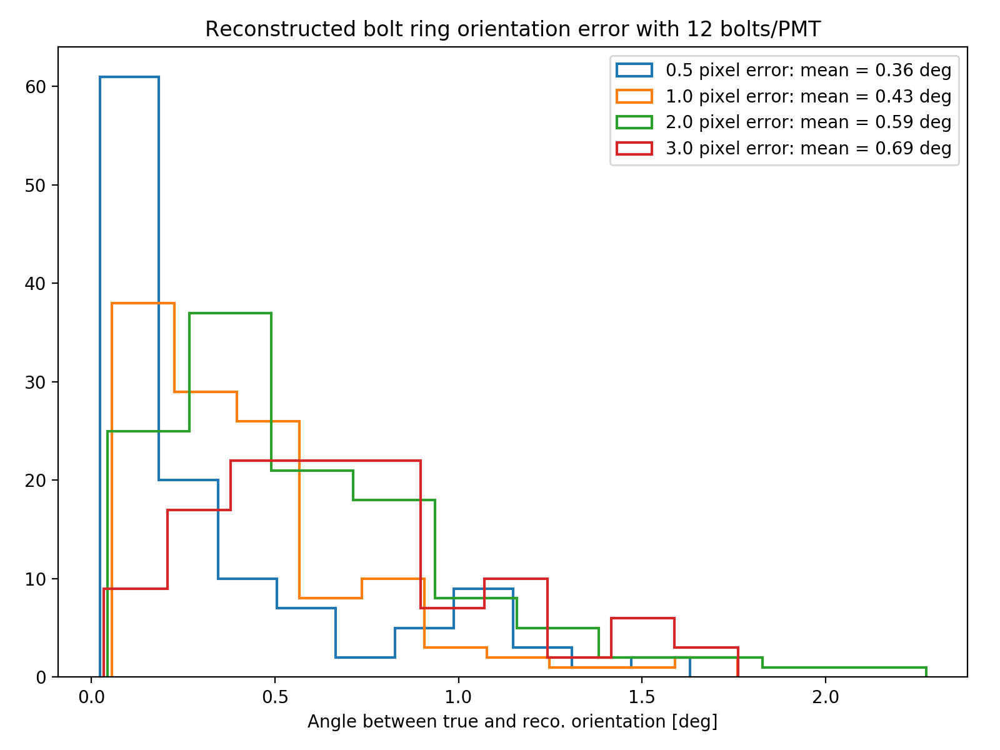

=== Gaussian errors on feature image locations: 0.5 ===
Smeared feature in image counts: Counter({5: 434, 6: 376, 4: 234, 3: 210, 2: 132, 1: 54})
image 0 reprojection errors:    average: 5.970196340208457    max: 19.088756905622464
image 1 reprojection errors:    average: 5.966765541599229    max: 19.039193481912395
image 2 reprojection errors:    average: 6.328533002881292    max: 19.044398593125575
image 3 reprojection errors:    average: 5.9967125497567055    max: 17.908156670294687
image 4 reprojection errors:    average: 5.87609506021649    max: 18.025304599815858
image 5 reprojection errors:    average: 6.02189136218086    max: 17.482630716688764
image 6 reprojection errors:    average: 5.80058667517483    max: 17.540428498385968
image 7 reprojection errors:    average: 5.922622031682509    max: 19.042208057918653
image 8 reprojection errors:    average: 5.9656170740566665    max: 18.52743227136299
image 9 reprojection errors:    average: 5.908381070225372    max: 18.034395774270

<IPython.core.display.Javascript object>


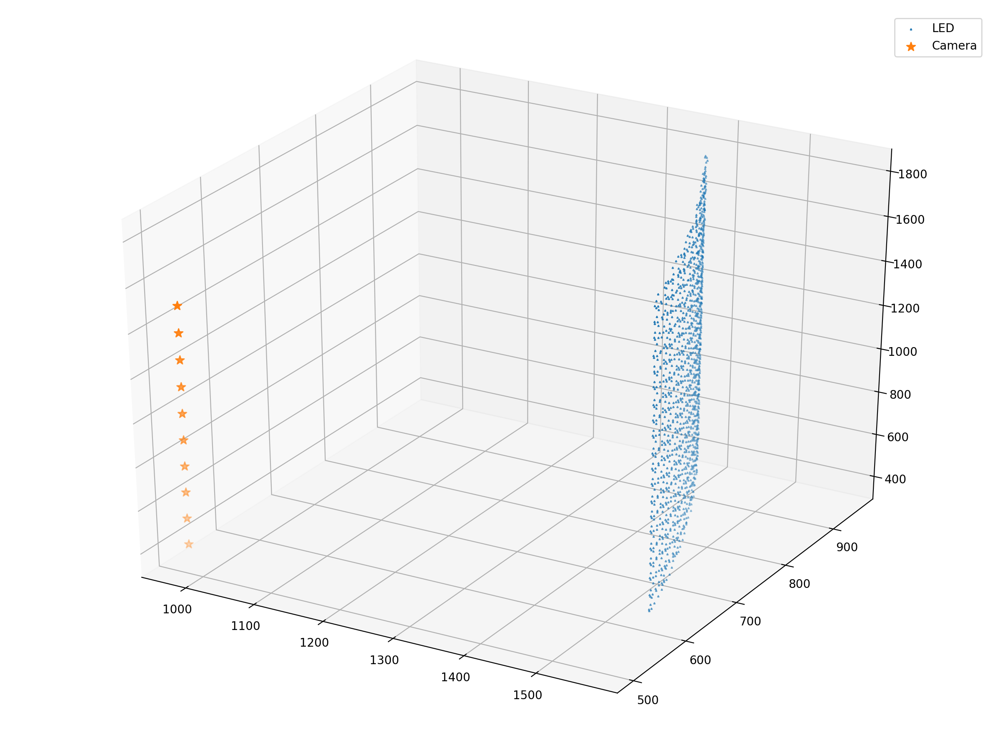

=== Gaussian errors on feature image locations: 1.0 ===
Smeared feature in image counts: Counter({5: 437, 6: 373, 4: 234, 3: 210, 2: 132, 1: 54})
image 0 reprojection errors:    average: 5.968708614916935    max: 19.91928565213856
image 1 reprojection errors:    average: 6.058359567681148    max: 20.962762379342802
image 2 reprojection errors:    average: 6.432403471942875    max: 24.61214246306123
image 3 reprojection errors:    average: 6.220330970761458    max: 22.553016468007094
image 4 reprojection errors:    average: 5.959668633627841    max: 23.457165452744746
image 5 reprojection errors:    average: 5.810781975639654    max: 24.250845581896918
image 6 reprojection errors:    average: 5.889975065181664    max: 23.98118071582368
image 7 reprojection errors:    average: 5.720869783561283    max: 18.587760023823833
image 8 reprojection errors:    average: 6.059898811602494    max: 20.13966609113794
image 9 reprojection errors:    average: 5.688970366939661    max: 15.29625663641504

<IPython.core.display.Javascript object>


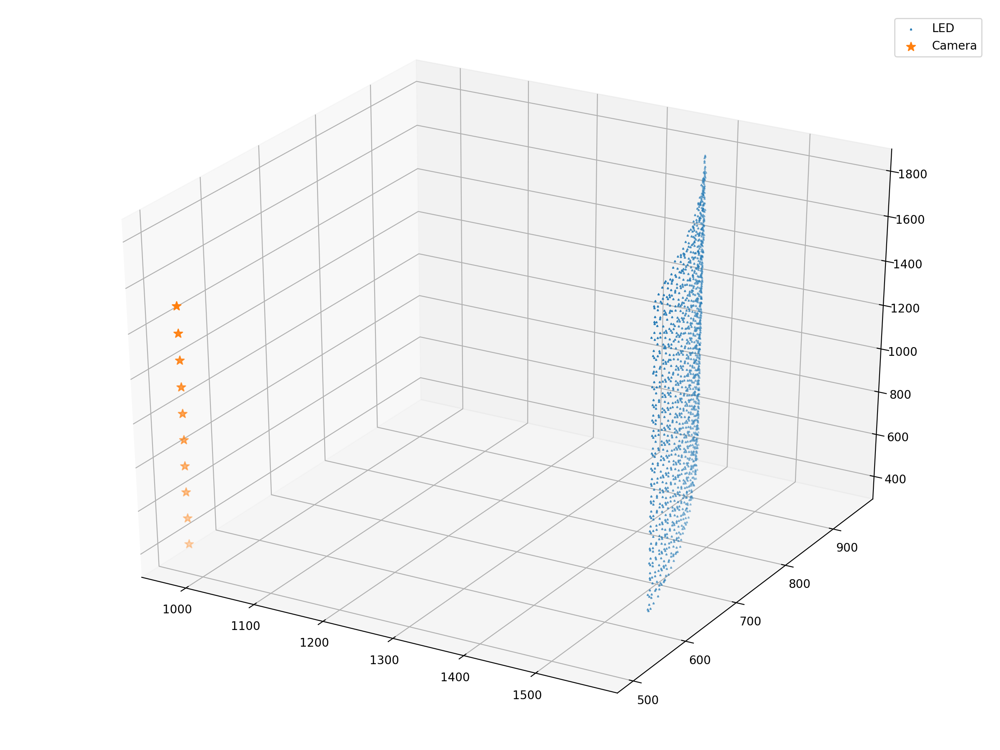

=== Gaussian errors on feature image locations: 2.0 ===
Smeared feature in image counts: Counter({5: 438, 6: 372, 4: 234, 3: 210, 2: 132, 1: 54})
image 0 reprojection errors:    average: 6.021960904793707    max: 16.9668653403141
image 1 reprojection errors:    average: 6.067778987589656    max: 16.91774801389897
image 2 reprojection errors:    average: 6.18141540691882    max: 18.313664988690654
image 3 reprojection errors:    average: 6.180004076043862    max: 18.989247407356473
image 4 reprojection errors:    average: 6.482629729937244    max: 18.663922208277018
image 5 reprojection errors:    average: 6.267355951678918    max: 18.494258886261772
image 6 reprojection errors:    average: 6.008825446419366    max: 17.49626120479967
image 7 reprojection errors:    average: 6.163549479385239    max: 18.51926008015659
image 8 reprojection errors:    average: 6.130857585924266    max: 18.104645834574043
image 9 reprojection errors:    average: 6.207800158505401    max: 16.48241633335472
 

<IPython.core.display.Javascript object>


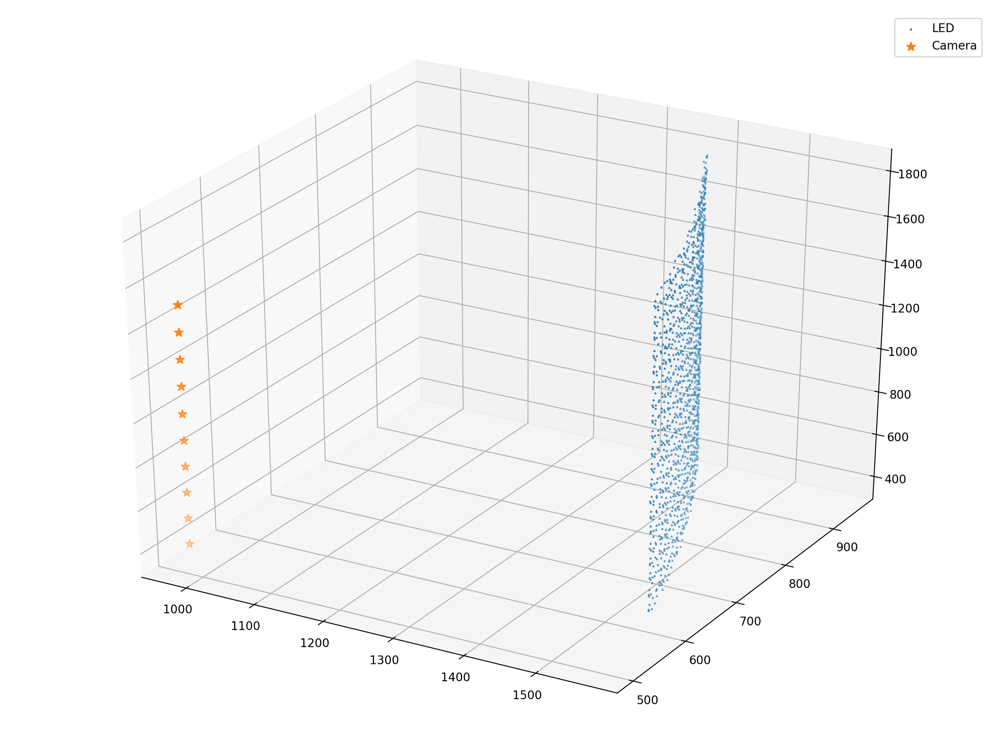

=== Gaussian errors on feature image locations: 3.0 ===
Smeared feature in image counts: Counter({5: 439, 6: 371, 4: 234, 3: 210, 2: 132, 1: 54})
image 0 reprojection errors:    average: 6.516088145510106    max: 19.463961174844194
image 1 reprojection errors:    average: 6.4791824478983395    max: 23.2780470413576
image 2 reprojection errors:    average: 6.928396884388513    max: 20.753813182297414
image 3 reprojection errors:    average: 6.548268310509829    max: 20.183597214427806
image 4 reprojection errors:    average: 6.836797779871335    max: 19.1852890703306
image 5 reprojection errors:    average: 7.376738463992196    max: 19.924347503041528
image 6 reprojection errors:    average: 6.379160306552844    max: 17.290363958907086
image 7 reprojection errors:    average: 6.436590355936116    max: 18.783922061171463
image 8 reprojection errors:    average: 6.684257311955609    max: 19.667924258928693
image 9 reprojection errors:    average: 6.443236140147682    max: 17.6896770918551

<IPython.core.display.Javascript object>


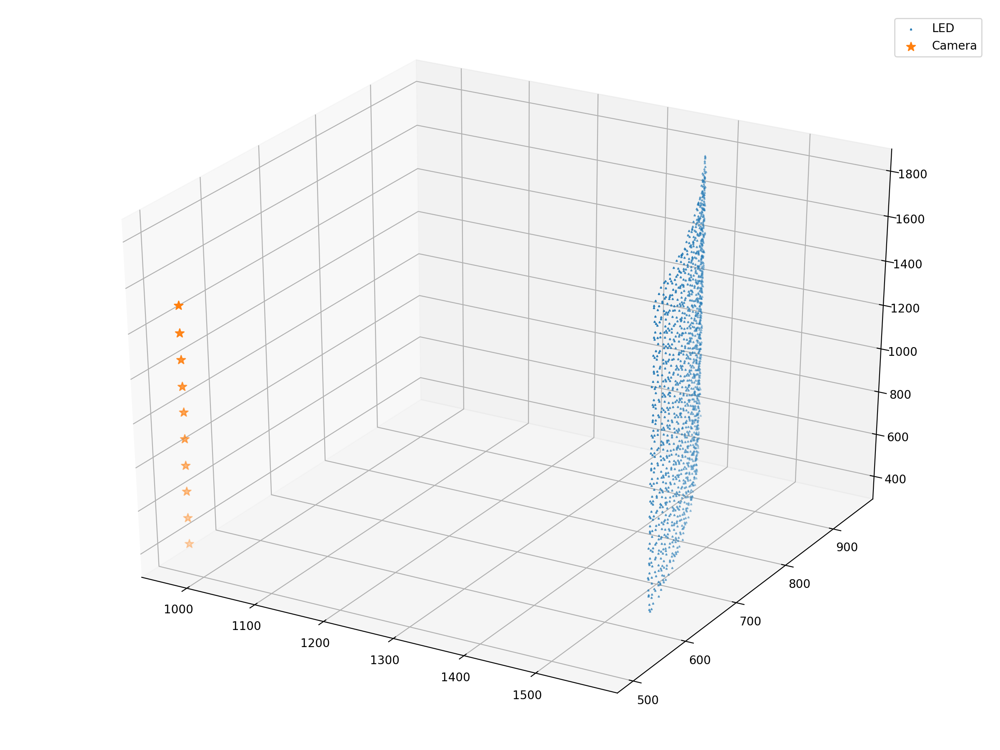

In [22]:
fig_bolt_pos, ax_bolt_pos = make_fig("Reconstructed bolt position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_pos, ax_ring_pos = make_fig("Reconstructed bolt ring centre position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_ang, ax_ring_ang = make_fig("Reconstructed bolt ring orientation error with {} bolts/PMT".format(bolt_count), "Angle between true and reco. orientation [deg]")
for pixel_error in [0.5, 1.0, 2.0, 3.0]:
    print("=== Gaussian errors on feature image locations:", pixel_error, "===")
    smeared_feature_locations = get_smeared_feature_locations(image_feature_locations, pixel_error)
    fitter = setup_bolt_simulation(bolt_positions, smeared_feature_locations, focal_length, principle_point, radial_distortion)    
    reco_bolt_positions, position_errors = run_bolt_fit(fitter, bolt_positions)
    centre_errors = get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count)
    orientation_errors = get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count)
    ax_bolt_pos.hist(position_errors, bins=40, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, position_errors.mean()))
    ax_ring_pos.hist(centre_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, centre_errors.mean()))
    ax_ring_ang.hist(orientation_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} deg".format(pixel_error, orientation_errors.mean()))
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_bolt_positions)
    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(fitter.camera_rotations, fitter.camera_translations)
    plot_reconstruction(reco_transformed, reco_cam_positions)
ax_bolt_pos.legend(loc='upper right')
ax_ring_pos.legend(loc='upper right')
ax_ring_ang.legend(loc='upper right')

# Simulation with 8 bolts

Feature in image counts: Counter({5: 294, 6: 240, 3: 150, 4: 150, 2: 96, 1: 30})


/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


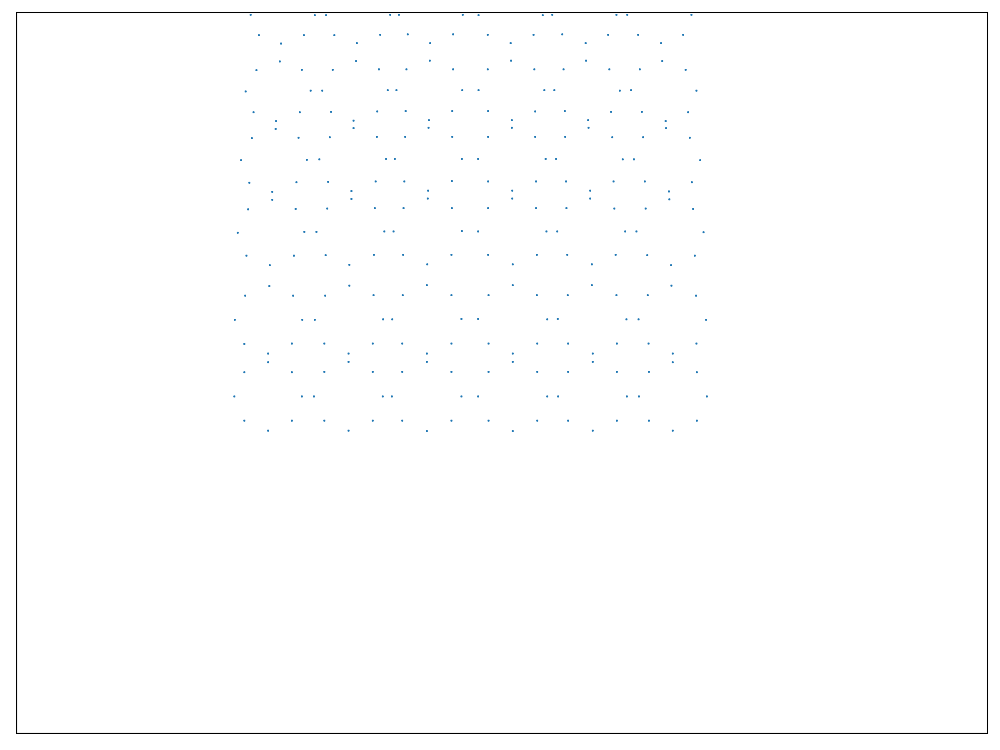

<IPython.core.display.Javascript object>


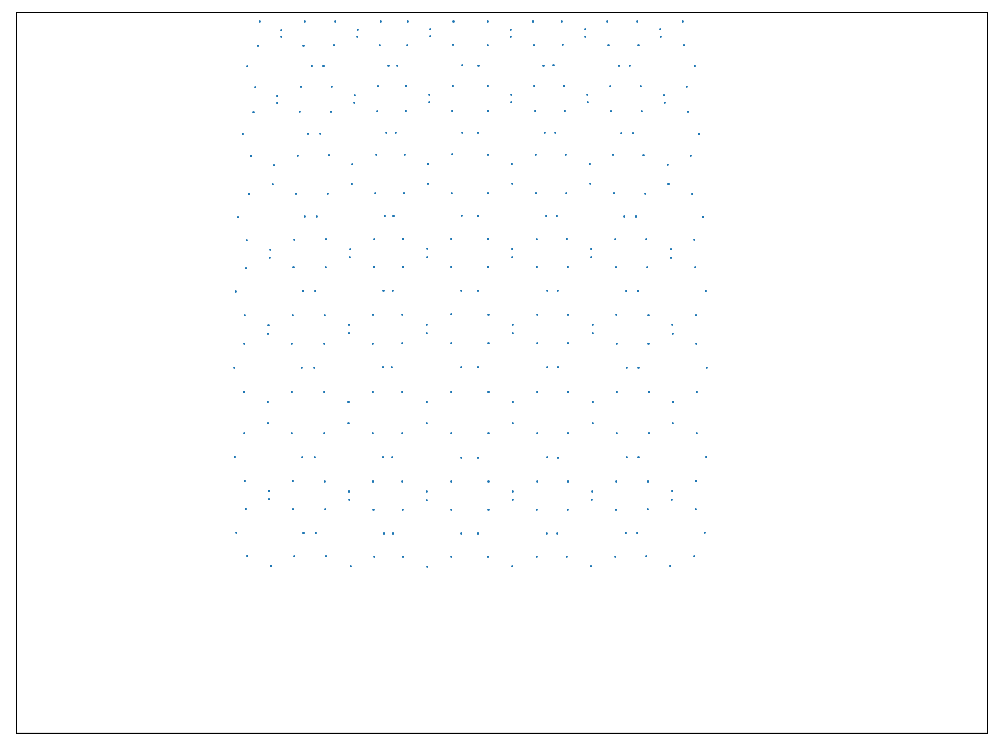

<IPython.core.display.Javascript object>


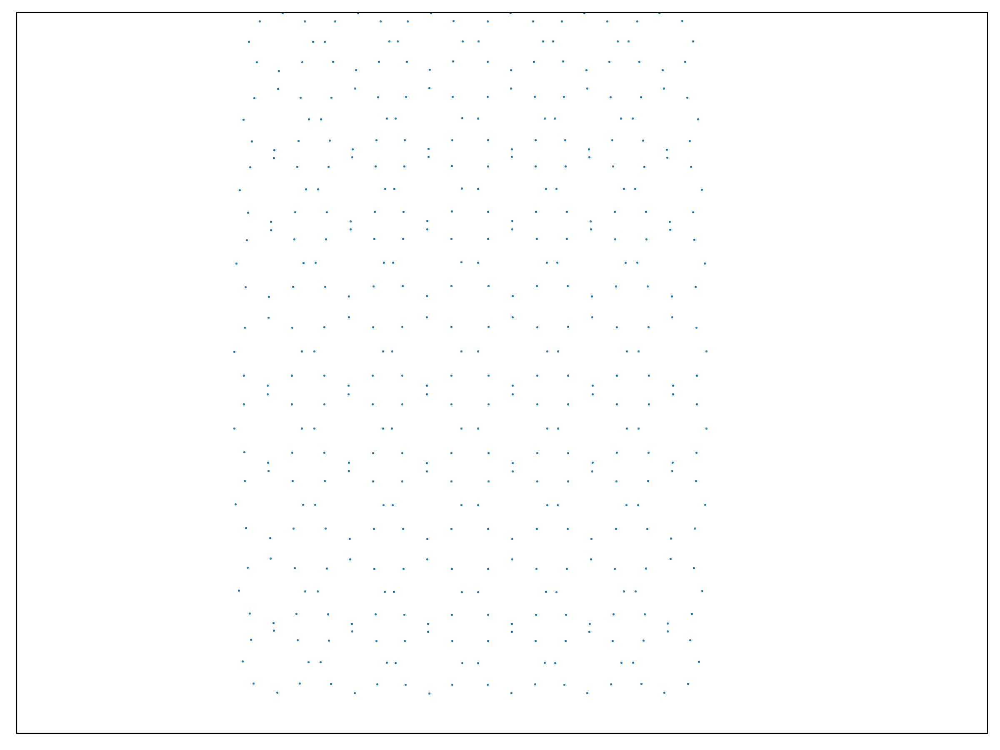

<IPython.core.display.Javascript object>


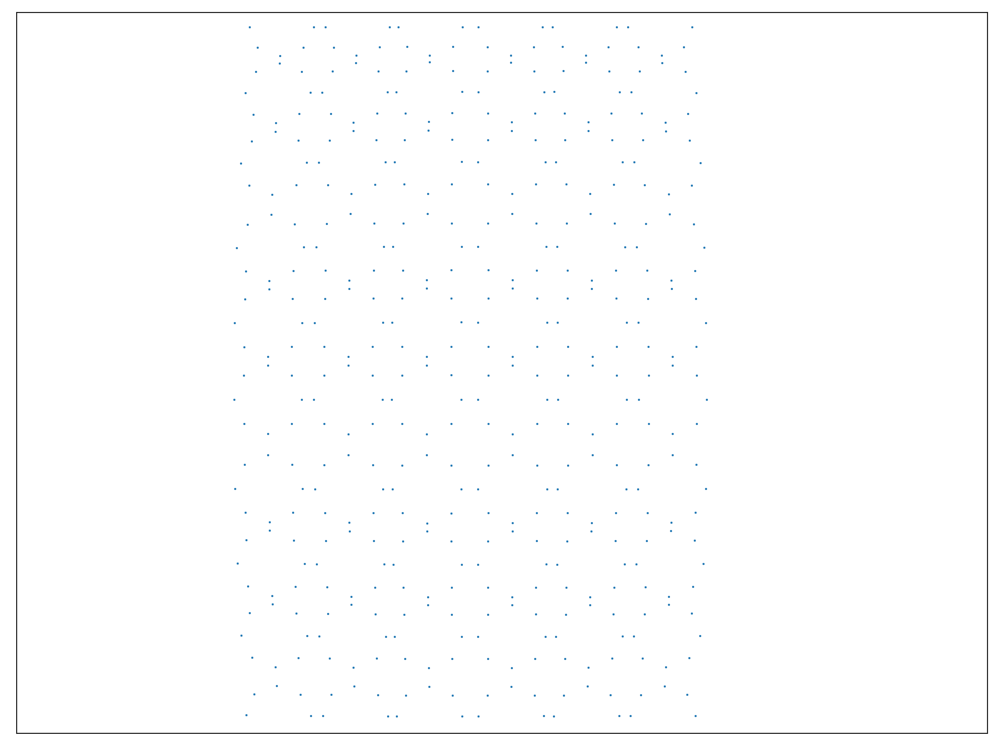

<IPython.core.display.Javascript object>


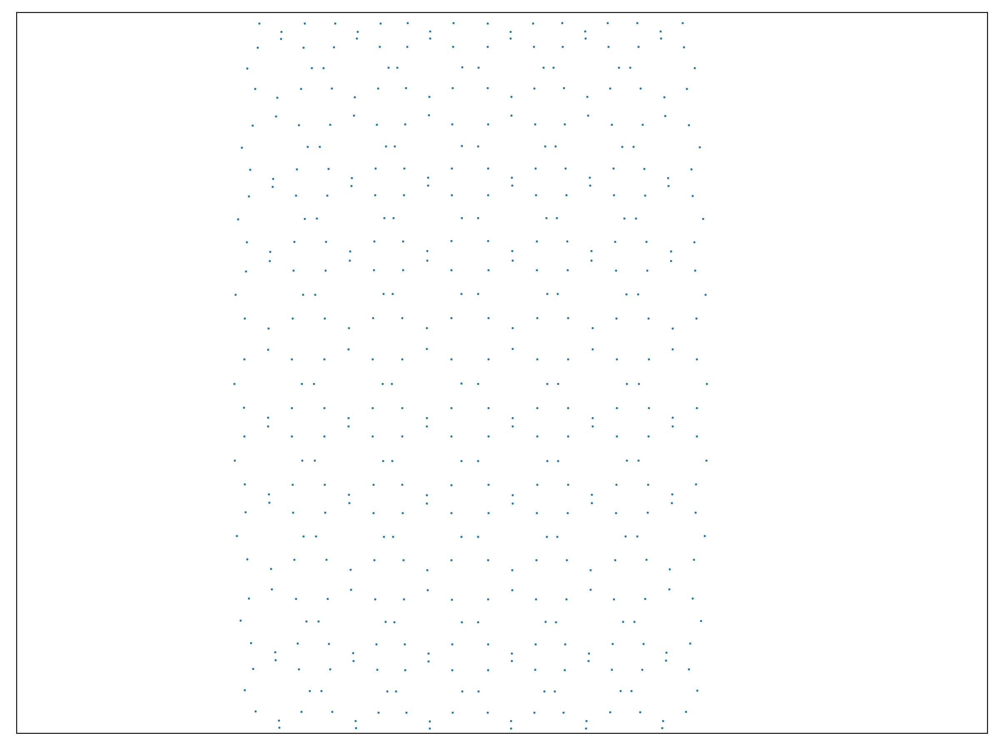

<IPython.core.display.Javascript object>


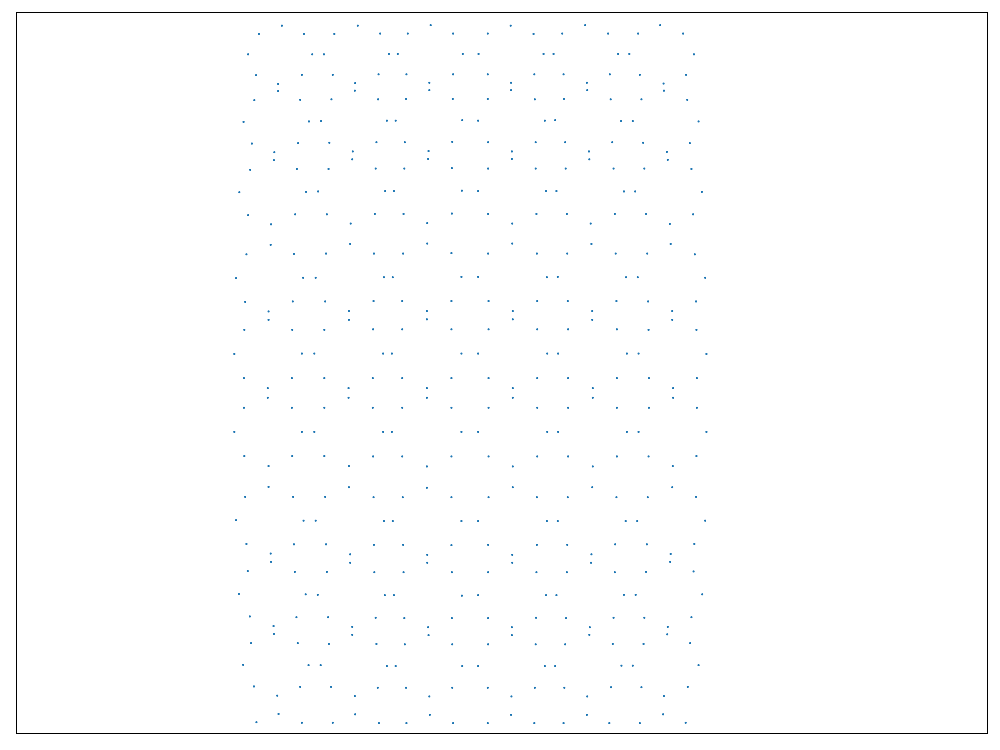

<IPython.core.display.Javascript object>


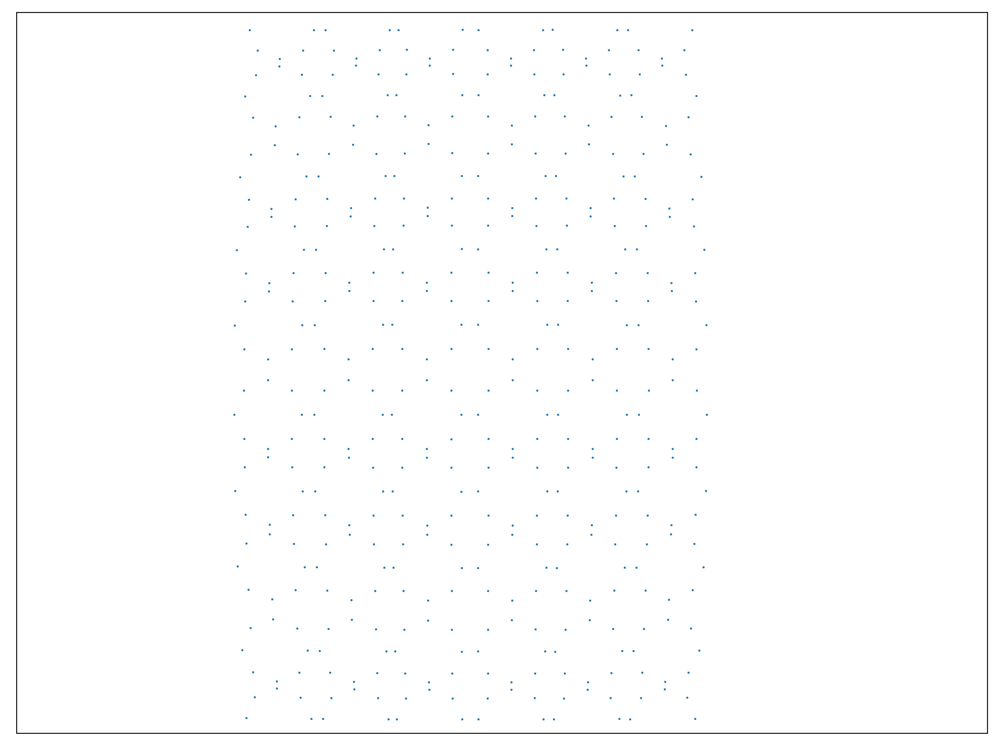

<IPython.core.display.Javascript object>


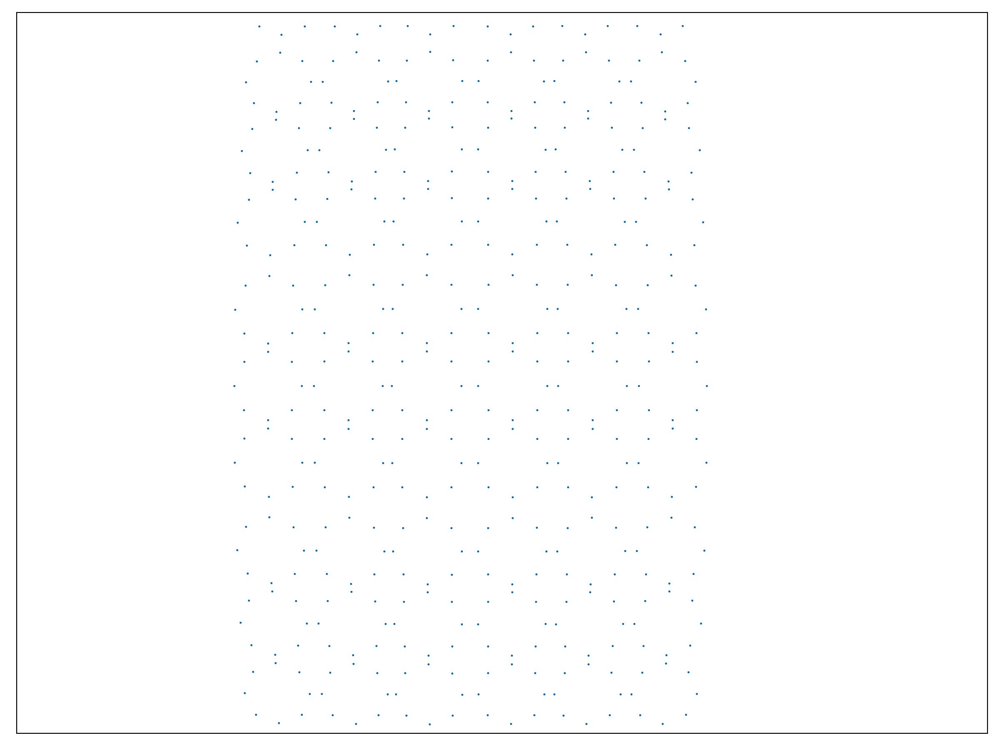

<IPython.core.display.Javascript object>


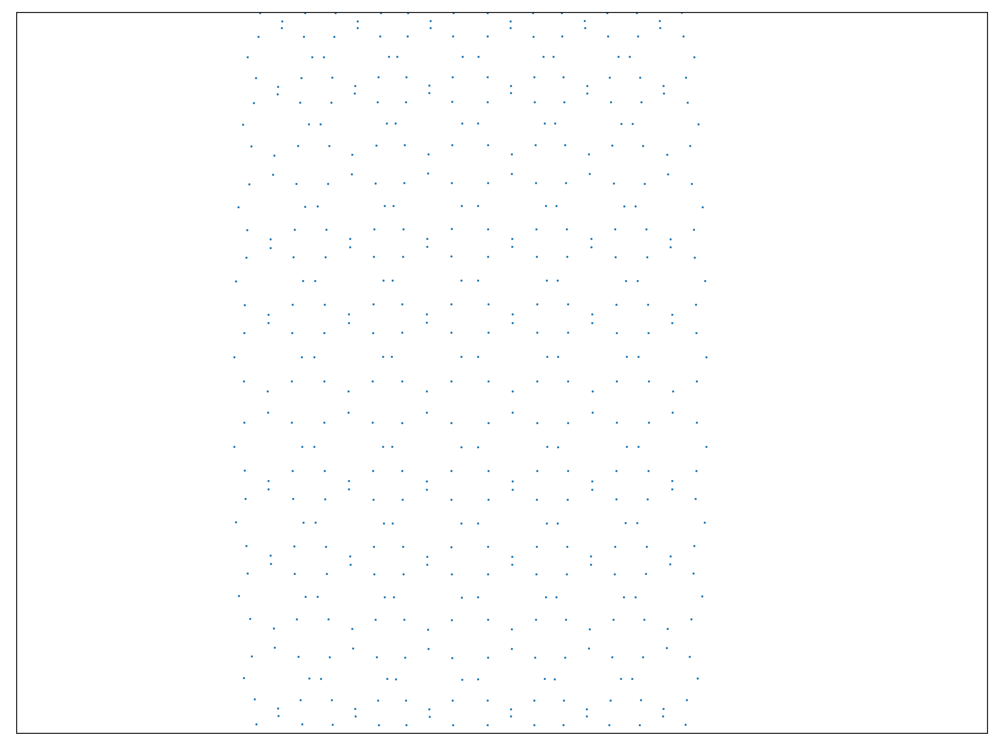

<IPython.core.display.Javascript object>


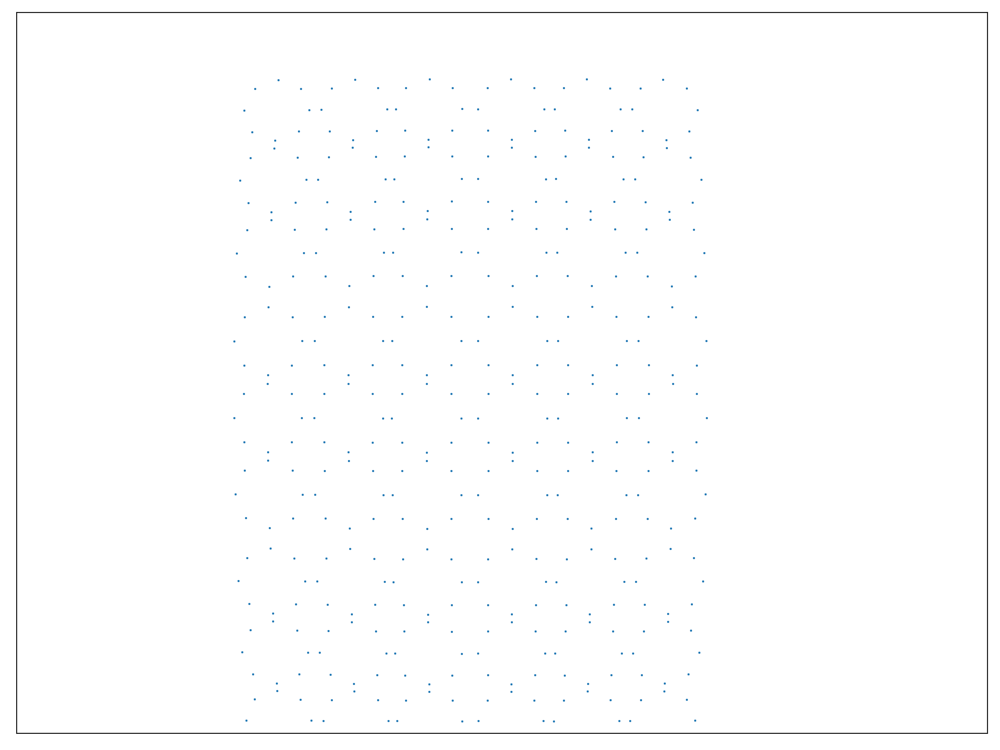

In [23]:
bolt_count = 8
bolt_positions = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = get_ring_positions(bolt_positions, pmt_locations.keys(), bolt_count)
ring_orientations = get_ring_orientations(bolt_positions, pmt_locations.keys(), bolt_count)
image_feature_locations = get_image_feature_locations(bolt_positions, camera_matrix, distortion, camera_rotations, camera_translations)
plot_images(image_feature_locations)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


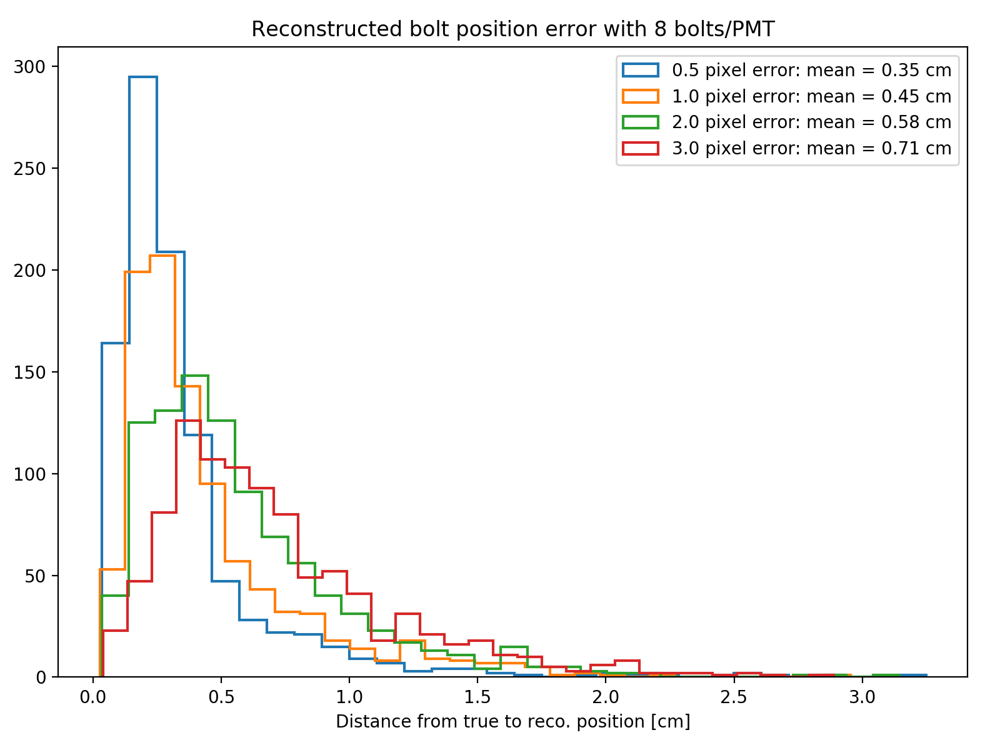

<IPython.core.display.Javascript object>


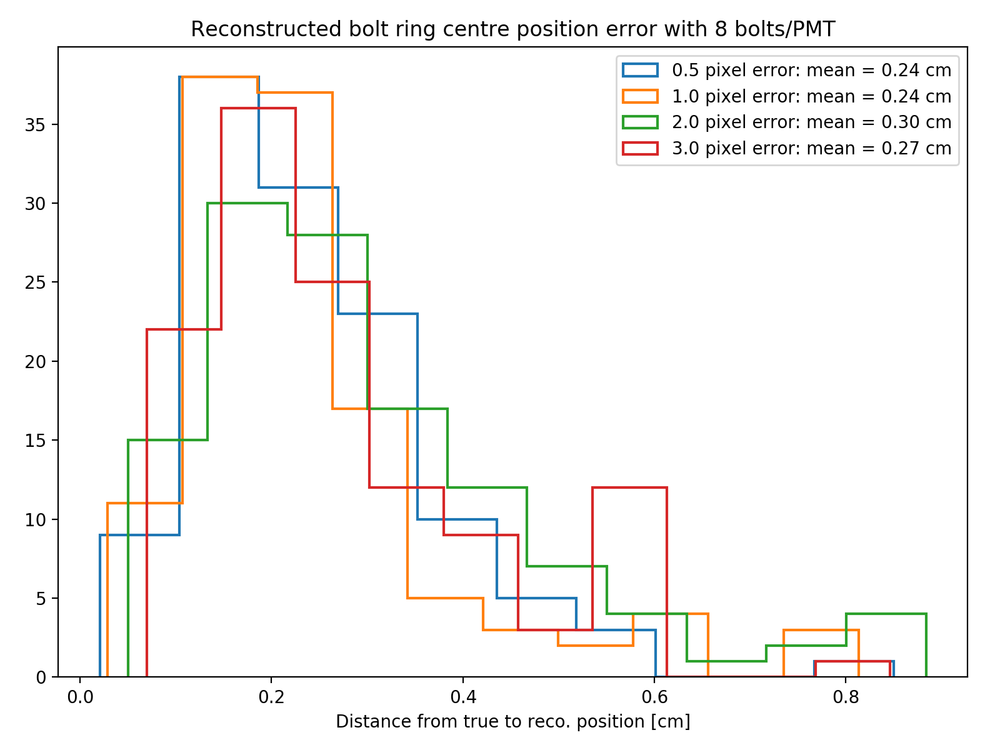

<IPython.core.display.Javascript object>


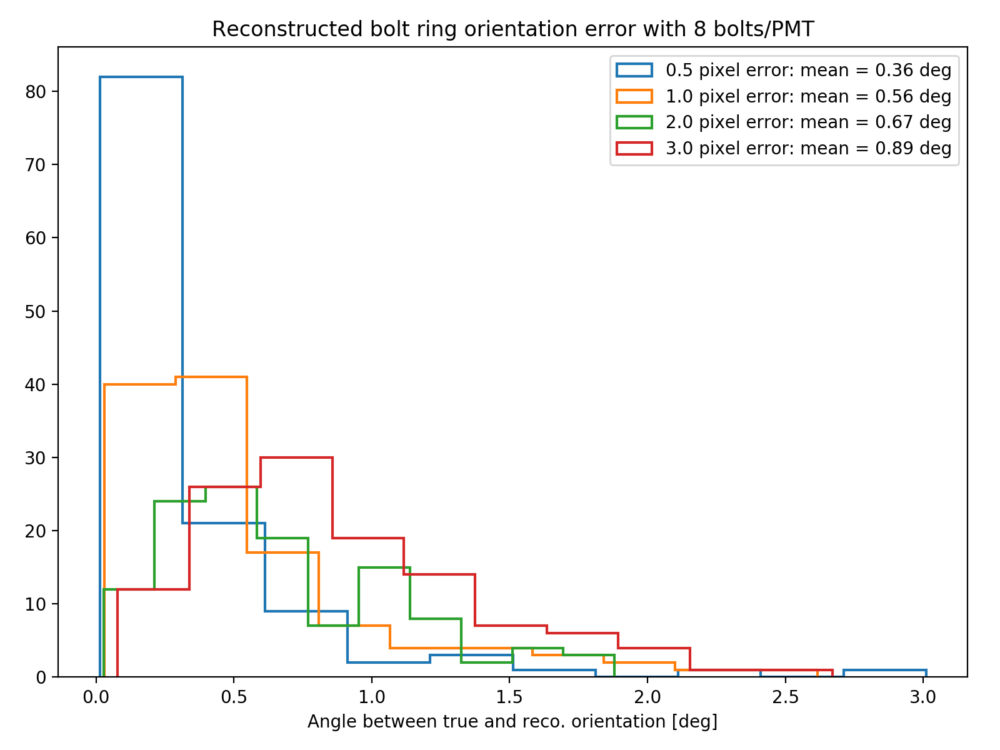

=== Gaussian errors on feature image locations: 0.5 ===
Smeared feature in image counts: Counter({5: 294, 6: 240, 3: 150, 4: 150, 2: 96, 1: 30})
image 0 reprojection errors:    average: 5.844710768884534    max: 15.9975399094623
image 1 reprojection errors:    average: 5.756854273696349    max: 16.49325791252947
image 2 reprojection errors:    average: 5.83151779036748    max: 18.152816511115745
image 3 reprojection errors:    average: 5.704339147324531    max: 16.33913672219954
image 4 reprojection errors:    average: 5.660662564463454    max: 16.166912873416205
image 5 reprojection errors:    average: 5.694241398689157    max: 16.773050063714262
image 6 reprojection errors:    average: 5.591320454771512    max: 18.163606515652905
image 7 reprojection errors:    average: 5.886322650802248    max: 16.991524109875115
image 8 reprojection errors:    average: 5.945878360385318    max: 18.131643792249342
image 9 reprojection errors:    average: 5.945166217660694    max: 17.141921386499575


<IPython.core.display.Javascript object>


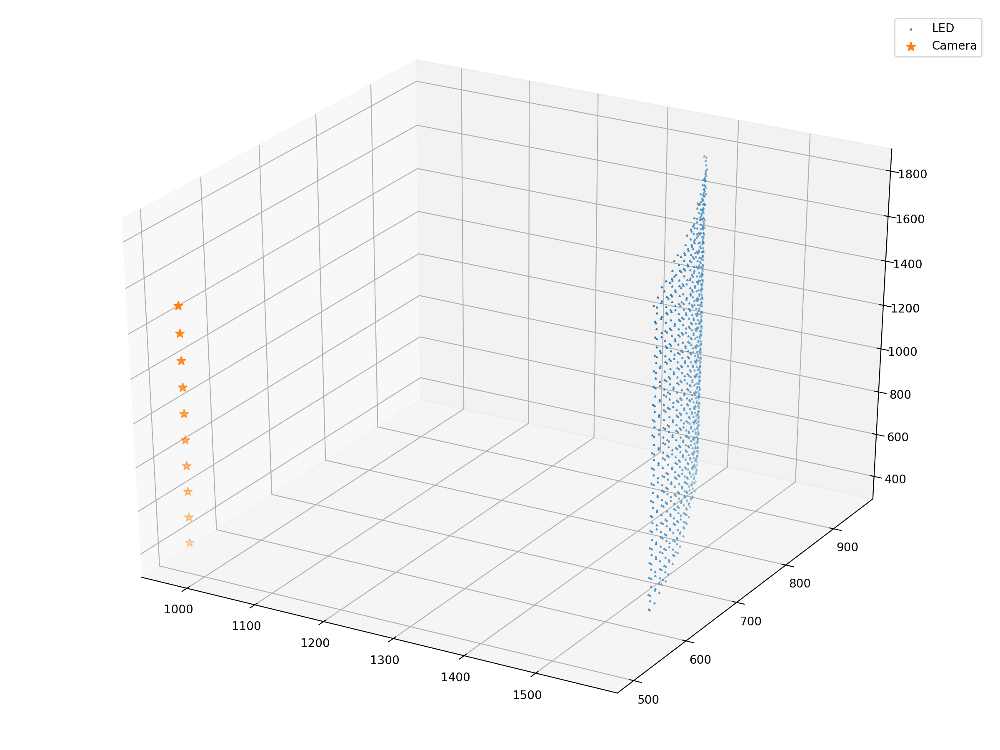

=== Gaussian errors on feature image locations: 1.0 ===
Smeared feature in image counts: Counter({5: 294, 6: 240, 3: 150, 4: 150, 2: 94, 1: 32})
image 0 reprojection errors:    average: 6.026860456020874    max: 15.314141150677864
image 1 reprojection errors:    average: 6.056310917458737    max: 14.79911137077546
image 2 reprojection errors:    average: 6.224300416362347    max: 15.194958177986548
image 3 reprojection errors:    average: 6.066458625051868    max: 15.580836642802883
image 4 reprojection errors:    average: 5.940576943798062    max: 16.67748579823181
image 5 reprojection errors:    average: 6.110802000078429    max: 17.439033499580635
image 6 reprojection errors:    average: 6.066720458781879    max: 17.46534565920263
image 7 reprojection errors:    average: 6.104152486220157    max: 18.452932224514395
image 8 reprojection errors:    average: 6.321013998735185    max: 18.247914453943956
image 9 reprojection errors:    average: 5.8958125799665835    max: 15.4271451596906

<IPython.core.display.Javascript object>


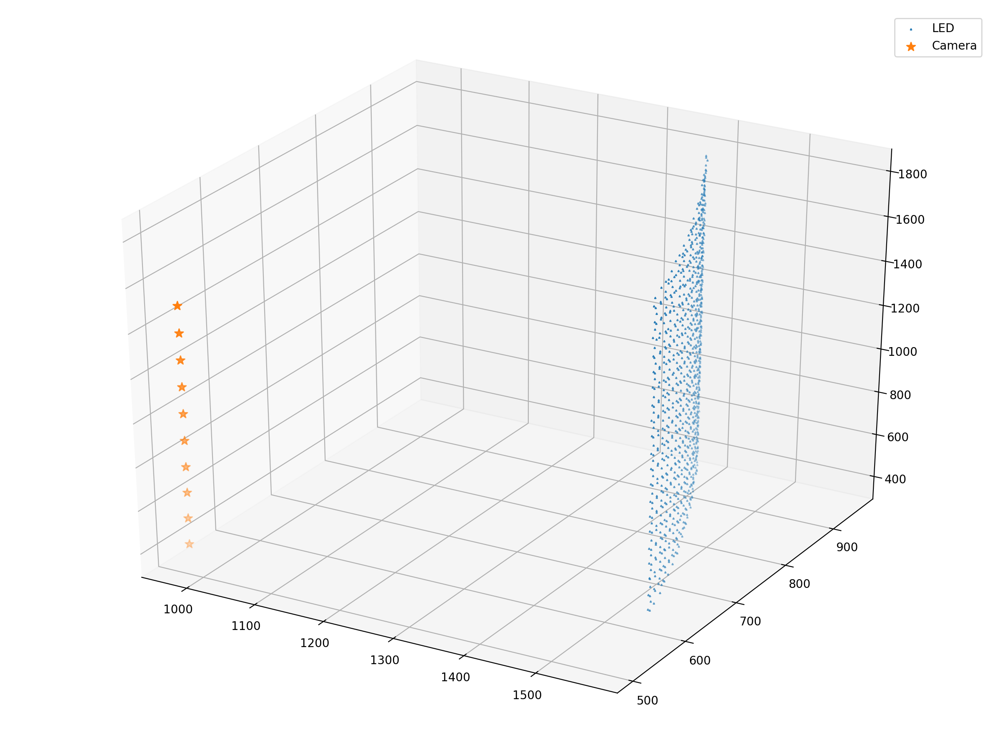

=== Gaussian errors on feature image locations: 2.0 ===
Smeared feature in image counts: Counter({5: 295, 6: 239, 3: 150, 4: 150, 2: 94, 1: 32})
image 0 reprojection errors:    average: 6.200792208025634    max: 17.740846727064916
image 1 reprojection errors:    average: 6.341548339057085    max: 20.931643547415035
image 2 reprojection errors:    average: 6.250691555761801    max: 17.871310720969603
image 3 reprojection errors:    average: 6.440101087565196    max: 17.6188155342815
image 4 reprojection errors:    average: 6.448206075129606    max: 18.588753749309742
image 5 reprojection errors:    average: 6.384403996119196    max: 20.139340833617158
image 6 reprojection errors:    average: 6.210910732767723    max: 18.06465578084095
image 7 reprojection errors:    average: 6.280630678946755    max: 18.669511657209384
image 8 reprojection errors:    average: 6.533234071122093    max: 17.198207253988713
image 9 reprojection errors:    average: 6.471186729261198    max: 18.74705194304888

<IPython.core.display.Javascript object>


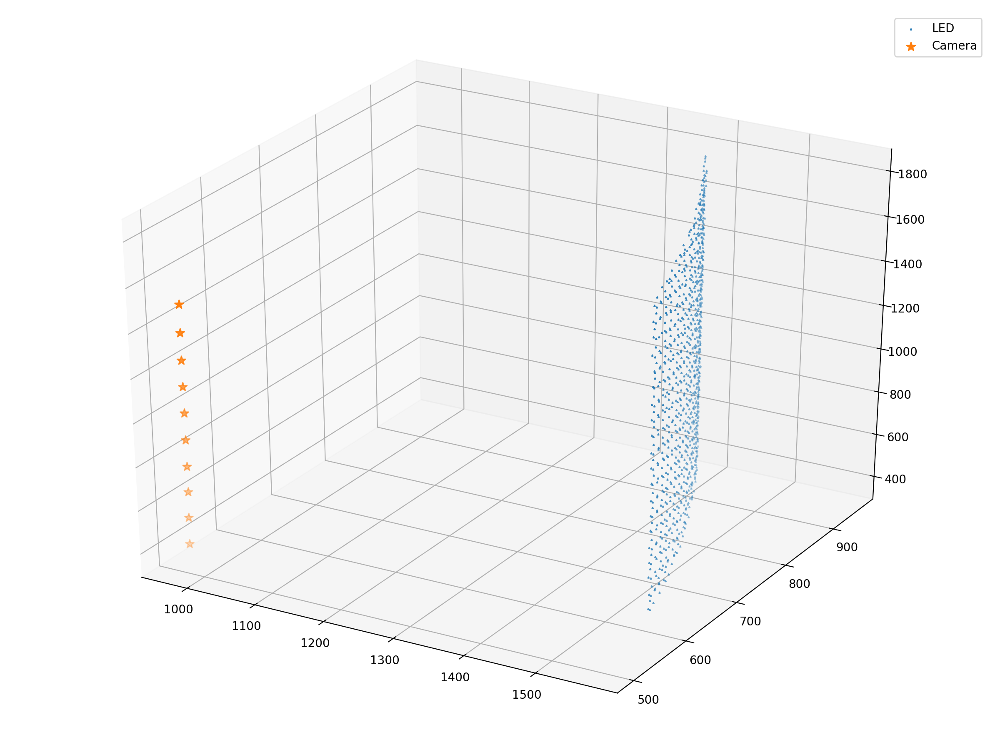

=== Gaussian errors on feature image locations: 3.0 ===
Smeared feature in image counts: Counter({5: 294, 6: 240, 3: 150, 4: 150, 2: 94, 1: 32})
image 0 reprojection errors:    average: 6.48760541340769    max: 16.964040094850425
image 1 reprojection errors:    average: 6.321332995168116    max: 16.354018887608717
image 2 reprojection errors:    average: 6.265466017782106    max: 15.877319694477746
image 3 reprojection errors:    average: 6.458550233032261    max: 19.52936150124605
image 4 reprojection errors:    average: 6.4015364688166265    max: 16.876671506245316
image 5 reprojection errors:    average: 6.146278422823942    max: 16.027771766562775
image 6 reprojection errors:    average: 6.326818951971416    max: 21.35097379872239
image 7 reprojection errors:    average: 6.457874475188441    max: 18.511143217101576
image 8 reprojection errors:    average: 7.04051495130027    max: 21.049041701741487
image 9 reprojection errors:    average: 7.019843808428698    max: 20.54680351669886

<IPython.core.display.Javascript object>


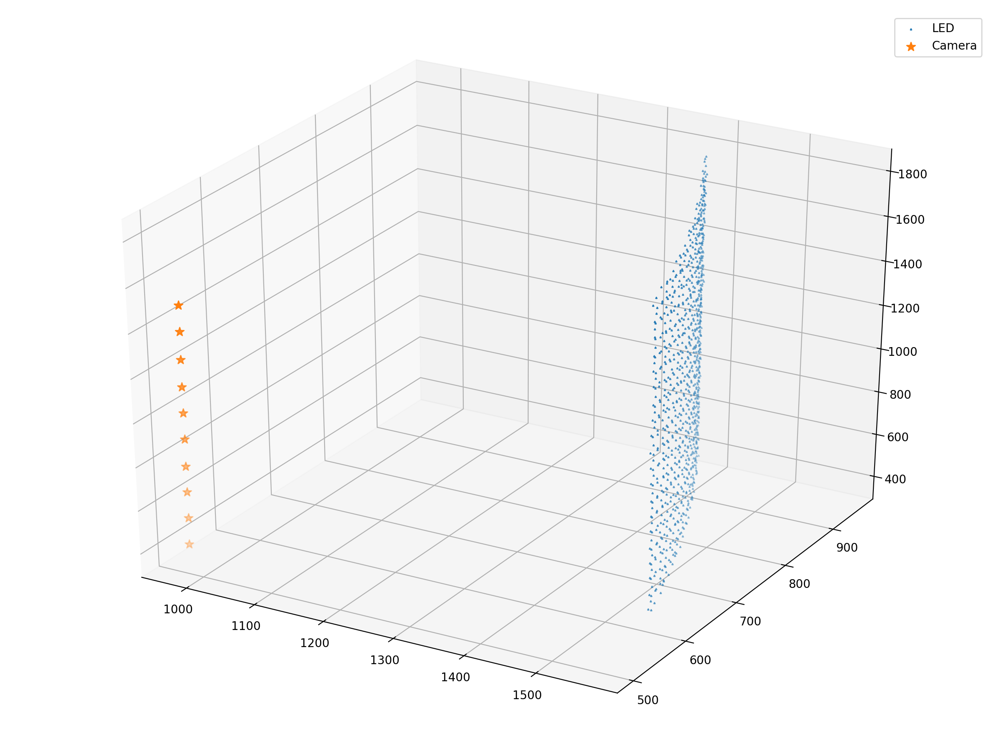

In [24]:
fig_bolt_pos, ax_bolt_pos = make_fig("Reconstructed bolt position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_pos, ax_ring_pos = make_fig("Reconstructed bolt ring centre position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_ang, ax_ring_ang = make_fig("Reconstructed bolt ring orientation error with {} bolts/PMT".format(bolt_count), "Angle between true and reco. orientation [deg]")
for pixel_error in [0.5, 1.0, 2.0, 3.0]:
    print("=== Gaussian errors on feature image locations:", pixel_error, "===")
    smeared_feature_locations = get_smeared_feature_locations(image_feature_locations, pixel_error)
    fitter = setup_bolt_simulation(bolt_positions, smeared_feature_locations, focal_length, principle_point, radial_distortion)    
    reco_bolt_positions, position_errors = run_bolt_fit(fitter, bolt_positions)
    centre_errors = get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count)
    orientation_errors = get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count)
    ax_bolt_pos.hist(position_errors, bins=30, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, position_errors.mean()))
    ax_ring_pos.hist(centre_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, centre_errors.mean()))
    ax_ring_ang.hist(orientation_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} deg".format(pixel_error, orientation_errors.mean()))
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_bolt_positions)
    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(fitter.camera_rotations, fitter.camera_translations)
    plot_reconstruction(reco_transformed, reco_cam_positions)
ax_bolt_pos.legend(loc='upper right')
ax_ring_pos.legend(loc='upper right')
ax_ring_ang.legend(loc='upper right')

# Simulation with 6 bolts

Feature in image counts: Counter({5: 206, 6: 196, 4: 126, 3: 102, 2: 60, 1: 30})


/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


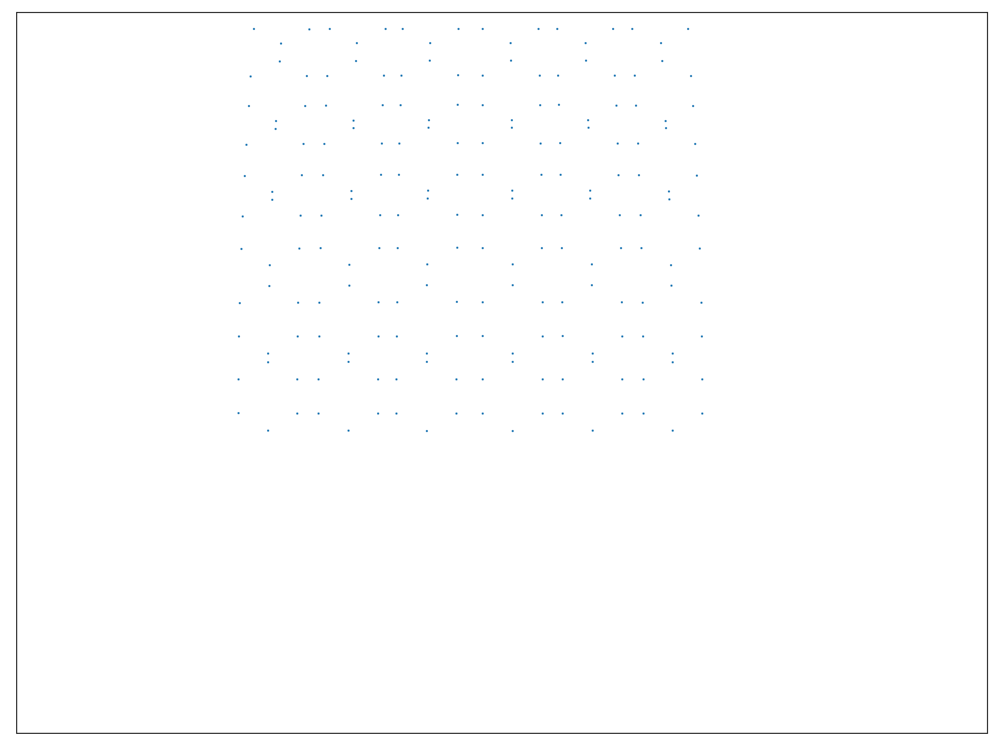

<IPython.core.display.Javascript object>


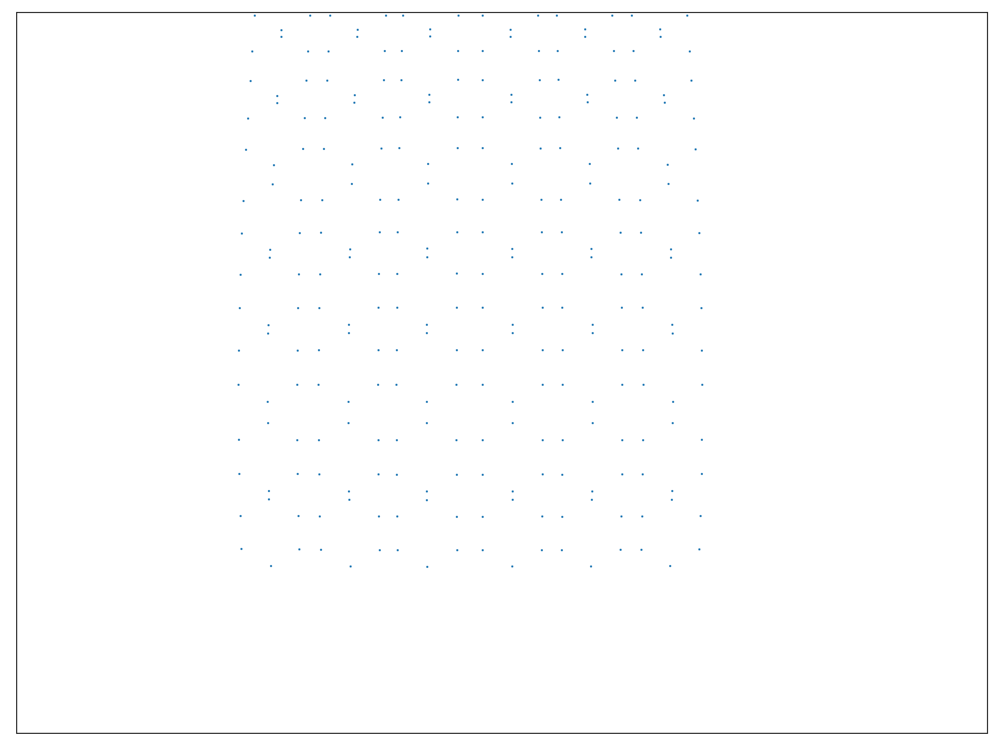

<IPython.core.display.Javascript object>


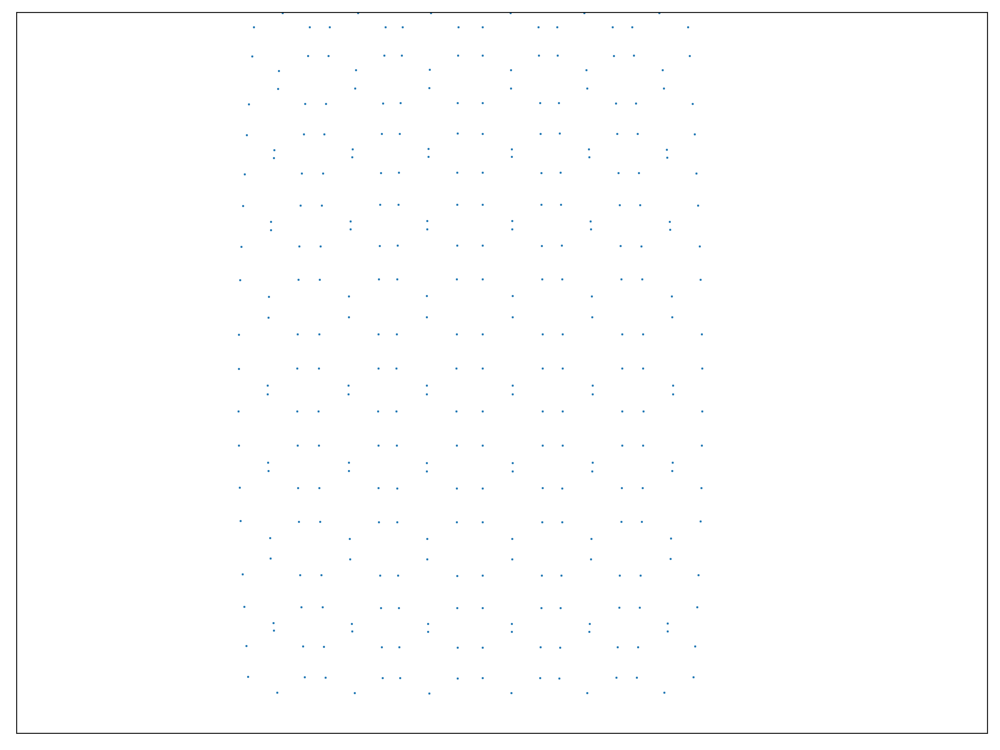

<IPython.core.display.Javascript object>


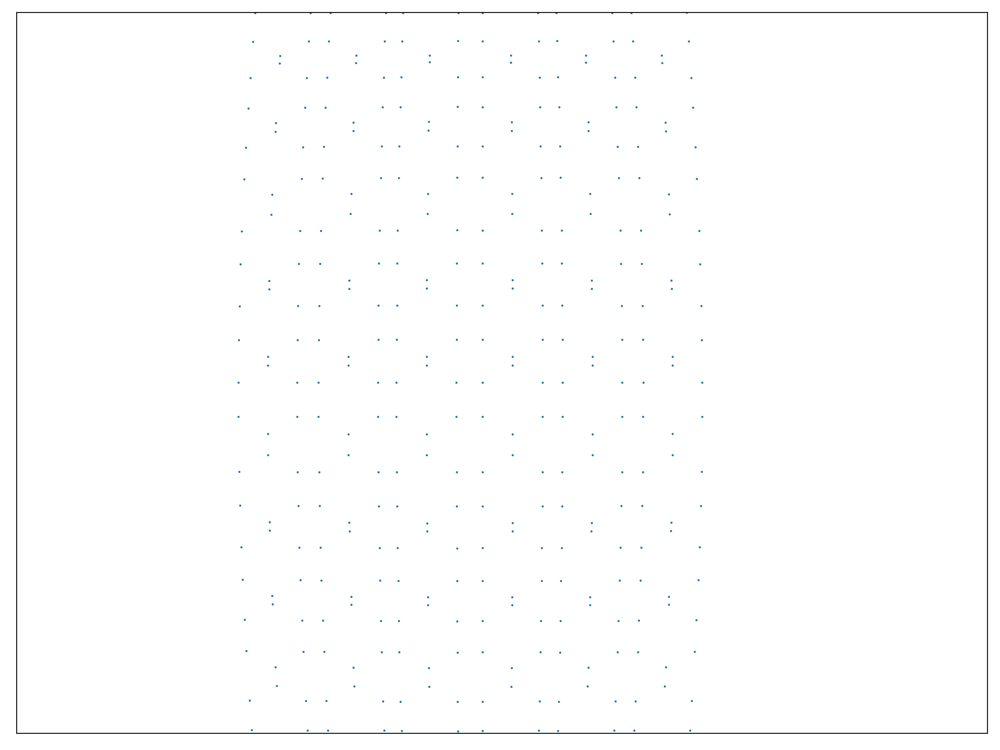

<IPython.core.display.Javascript object>


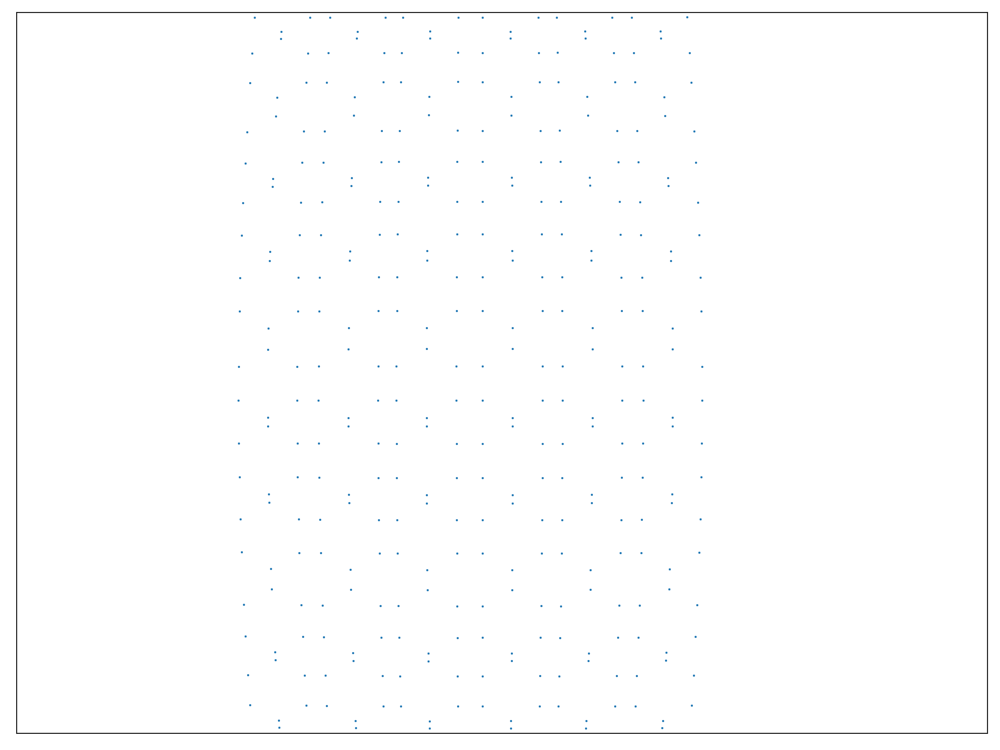

<IPython.core.display.Javascript object>


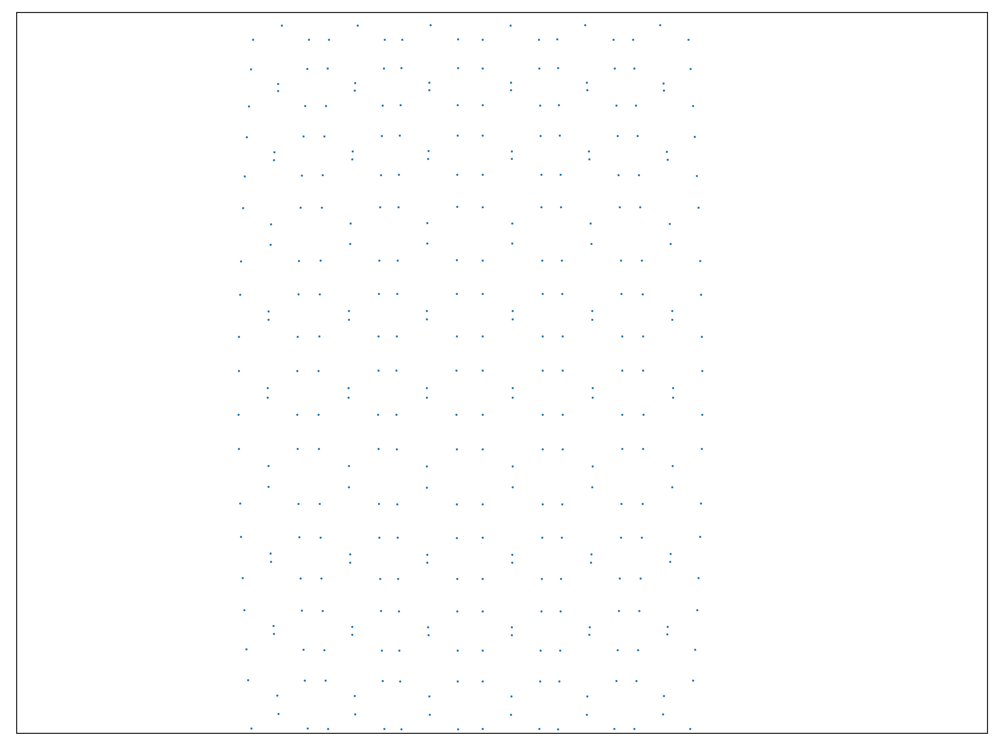

<IPython.core.display.Javascript object>


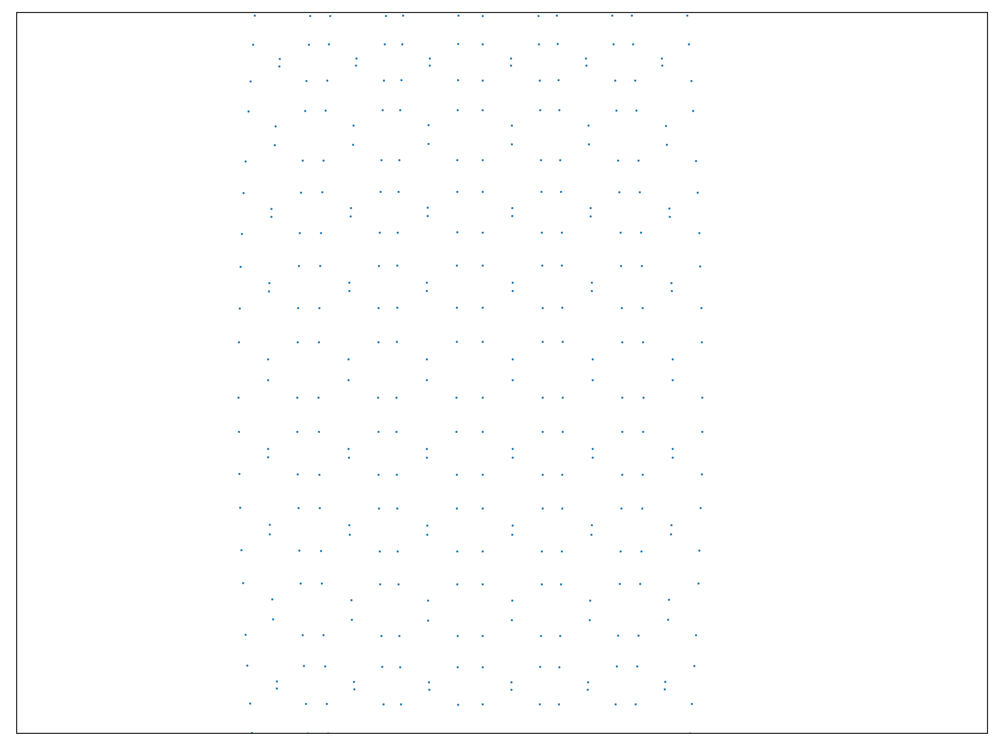

<IPython.core.display.Javascript object>


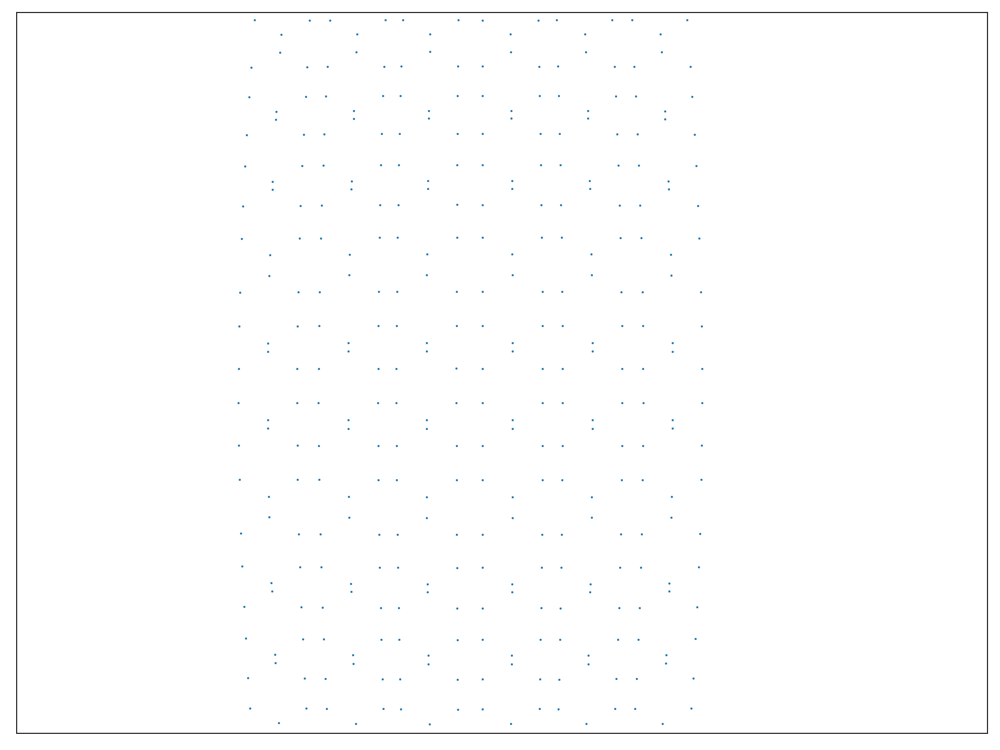

<IPython.core.display.Javascript object>


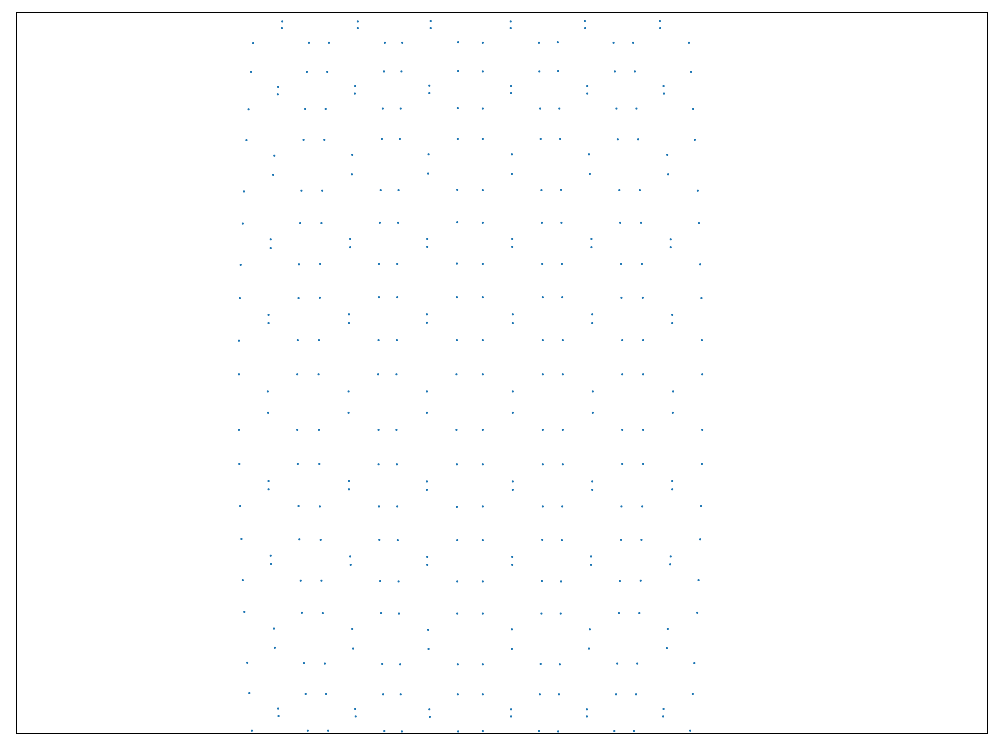

<IPython.core.display.Javascript object>


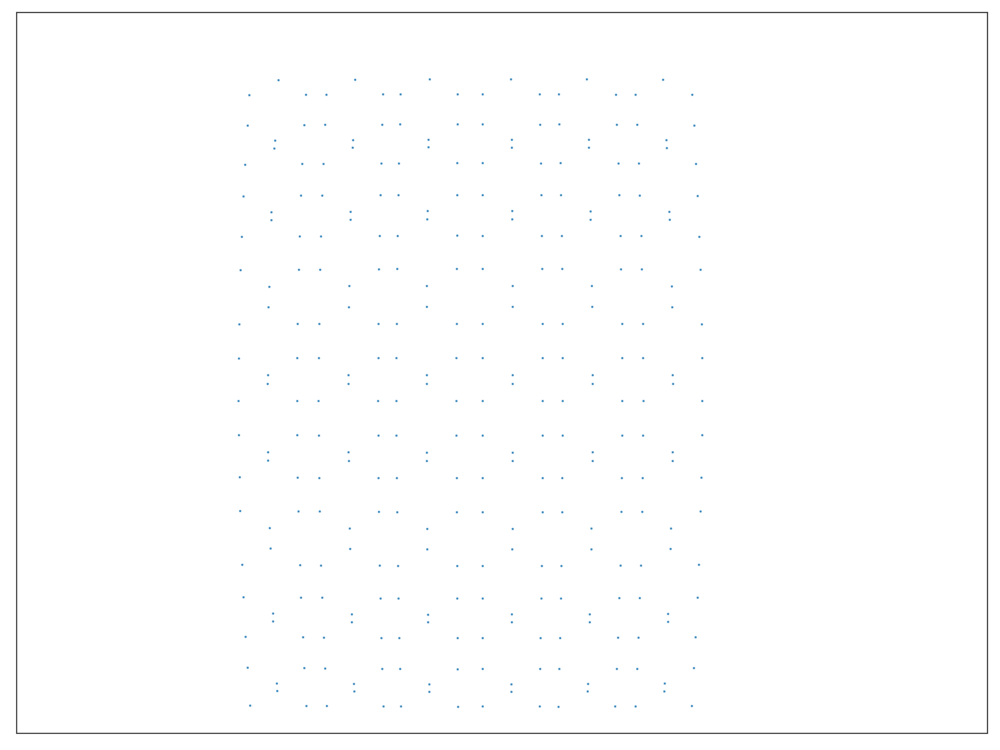

In [25]:
bolt_count = 6
bolt_positions = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = get_ring_positions(bolt_positions, pmt_locations.keys(), bolt_count)
ring_orientations = get_ring_orientations(bolt_positions, pmt_locations.keys(), bolt_count)
image_feature_locations = get_image_feature_locations(bolt_positions, camera_matrix, distortion, camera_rotations, camera_translations)
plot_images(image_feature_locations)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


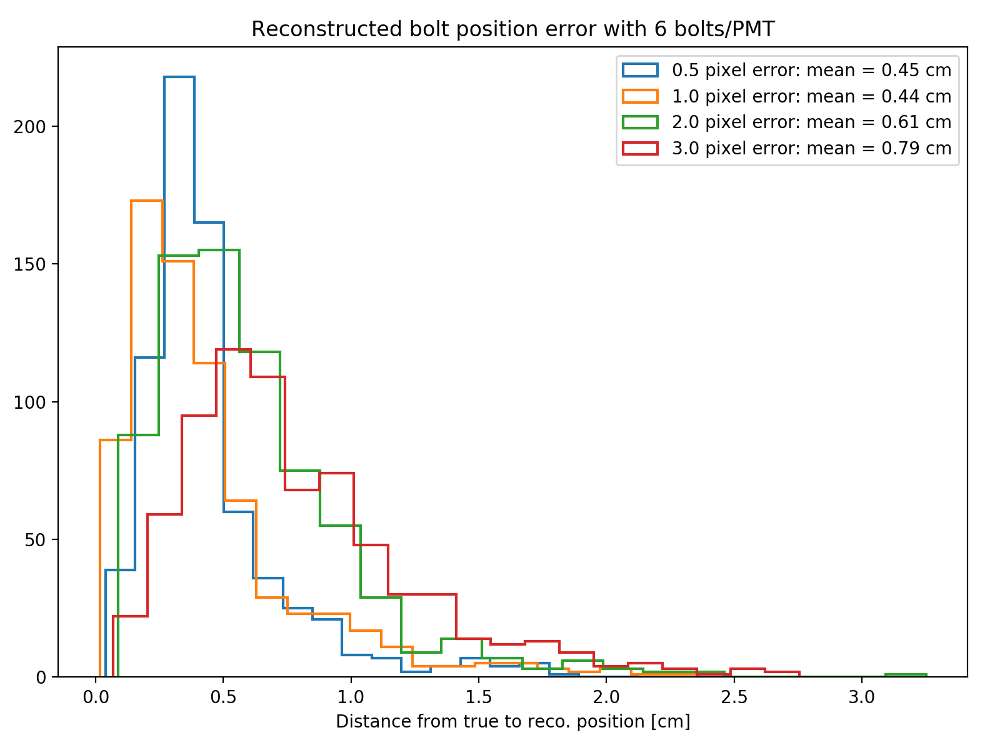

<IPython.core.display.Javascript object>


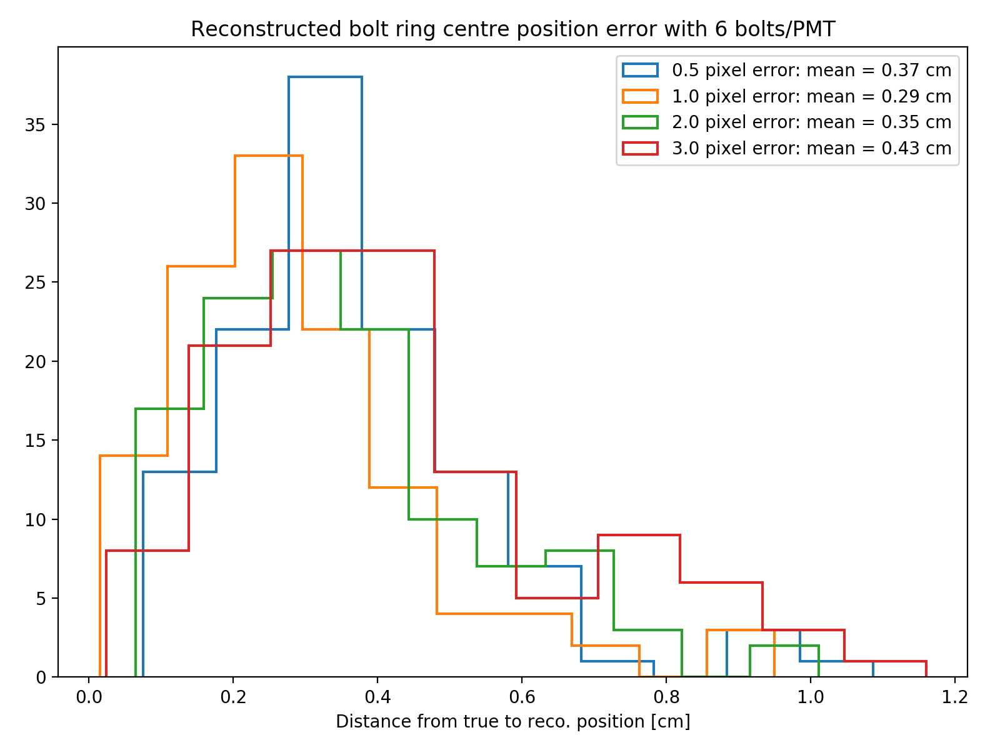

<IPython.core.display.Javascript object>


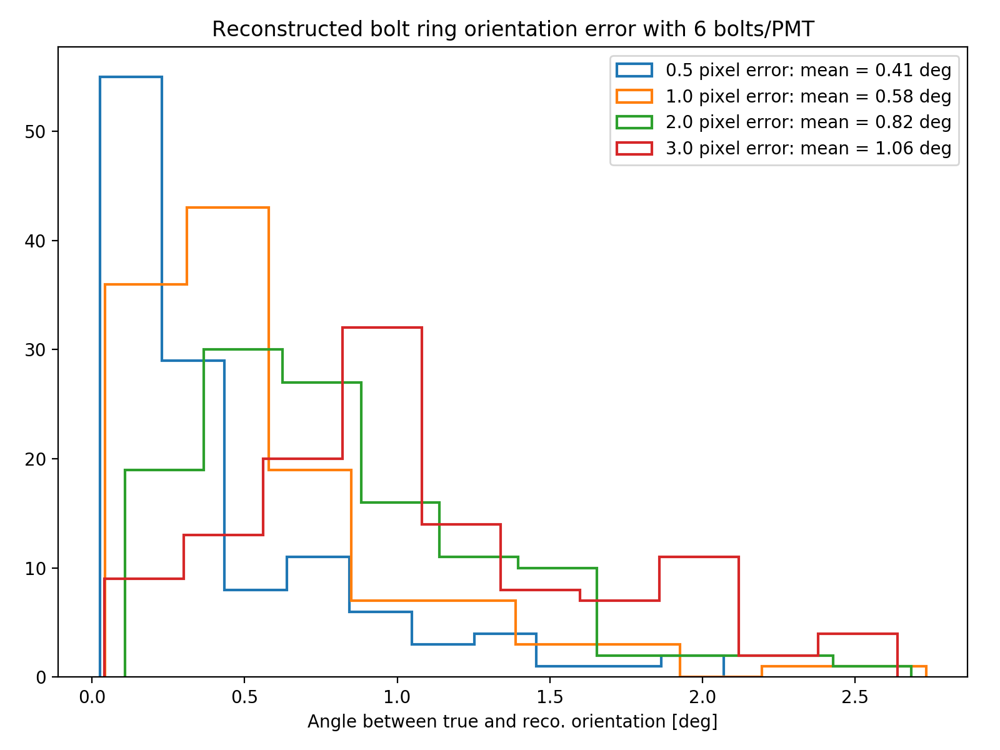

=== Gaussian errors on feature image locations: 0.5 ===
Smeared feature in image counts: Counter({5: 206, 6: 196, 4: 126, 3: 102, 2: 60, 1: 30})
image 0 reprojection errors:    average: 5.608554730817815    max: 15.558625786590373
image 1 reprojection errors:    average: 5.8667364269030875    max: 17.04875681373864
image 2 reprojection errors:    average: 5.937914544543523    max: 16.167553784042795
image 3 reprojection errors:    average: 5.896603830850504    max: 14.197685262788449
image 4 reprojection errors:    average: 6.472622465922375    max: 18.357619093904315
image 5 reprojection errors:    average: 5.939361875656331    max: 16.387705995257736
image 6 reprojection errors:    average: 6.073045527442023    max: 15.802927608552293
image 7 reprojection errors:    average: 6.394617165924544    max: 16.393571425340568
image 8 reprojection errors:    average: 6.13247712660982    max: 15.257773511465706
image 9 reprojection errors:    average: 5.749367065337389    max: 14.963401578287

<IPython.core.display.Javascript object>


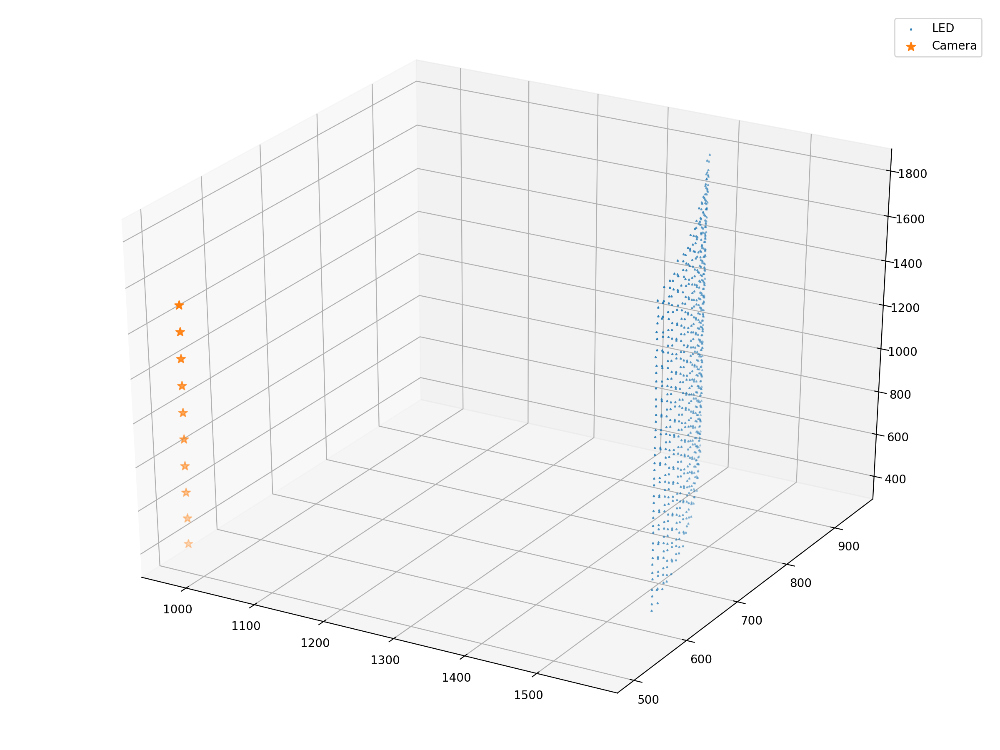

=== Gaussian errors on feature image locations: 1.0 ===
Smeared feature in image counts: Counter({5: 206, 6: 196, 4: 126, 3: 102, 2: 60, 1: 30})
image 0 reprojection errors:    average: 5.971023196109324    max: 16.514073894484323
image 1 reprojection errors:    average: 5.90443751065068    max: 16.386659095196215
image 2 reprojection errors:    average: 6.095435453741269    max: 17.666038994926105
image 3 reprojection errors:    average: 5.934455888965428    max: 17.61709693558395
image 4 reprojection errors:    average: 6.002132618865289    max: 17.3715051891313
image 5 reprojection errors:    average: 5.951388549311032    max: 16.792960684274686
image 6 reprojection errors:    average: 6.26869439771594    max: 16.441822714591343
image 7 reprojection errors:    average: 6.31621161486169    max: 16.943217194531062
image 8 reprojection errors:    average: 6.328129042417858    max: 19.33480212886593
image 9 reprojection errors:    average: 6.293053711577693    max: 16.346127548761093
  

<IPython.core.display.Javascript object>


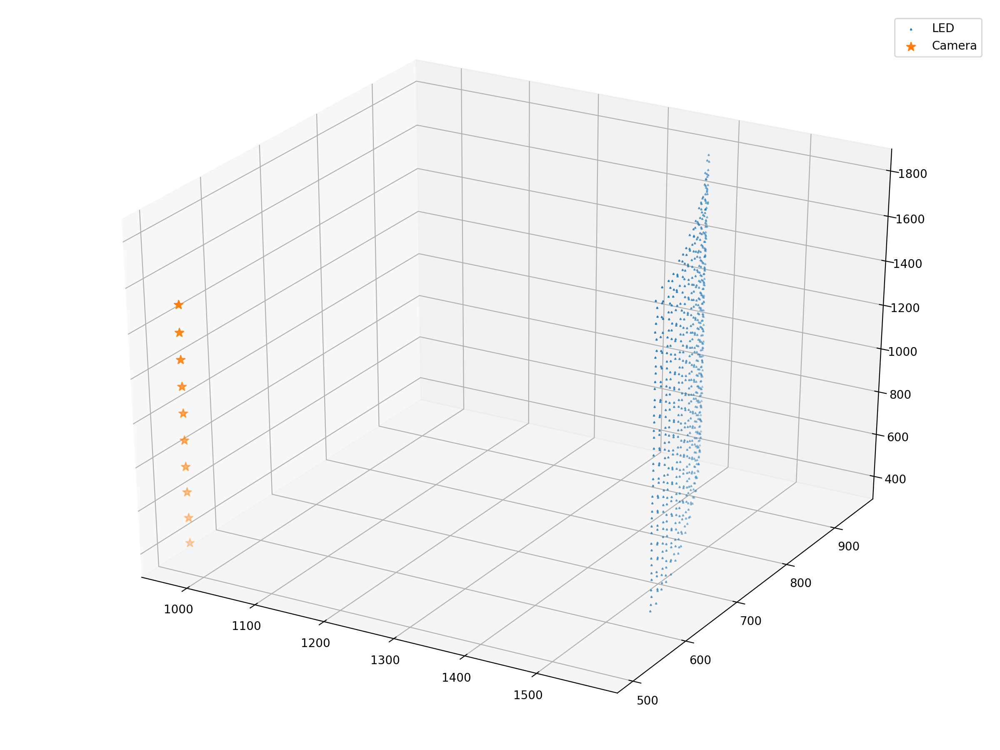

=== Gaussian errors on feature image locations: 2.0 ===
Smeared feature in image counts: Counter({5: 210, 6: 192, 4: 126, 3: 102, 2: 60, 1: 30})
image 0 reprojection errors:    average: 6.257059800204712    max: 16.235910921443303
image 1 reprojection errors:    average: 6.679059860485354    max: 16.84855750905219
image 2 reprojection errors:    average: 6.961183062652467    max: 21.722543774643988
image 3 reprojection errors:    average: 6.07194621895536    max: 15.136771302537978
image 4 reprojection errors:    average: 6.013636753531073    max: 16.909130408864627
image 5 reprojection errors:    average: 5.930726231020311    max: 16.327563848176805
image 6 reprojection errors:    average: 6.118403444356358    max: 17.885934714542536
image 7 reprojection errors:    average: 6.067743472295711    max: 16.063438515188952
image 8 reprojection errors:    average: 6.23270342029    max: 18.64731436605241
image 9 reprojection errors:    average: 6.59933125125506    max: 17.32225177886673
   I

<IPython.core.display.Javascript object>


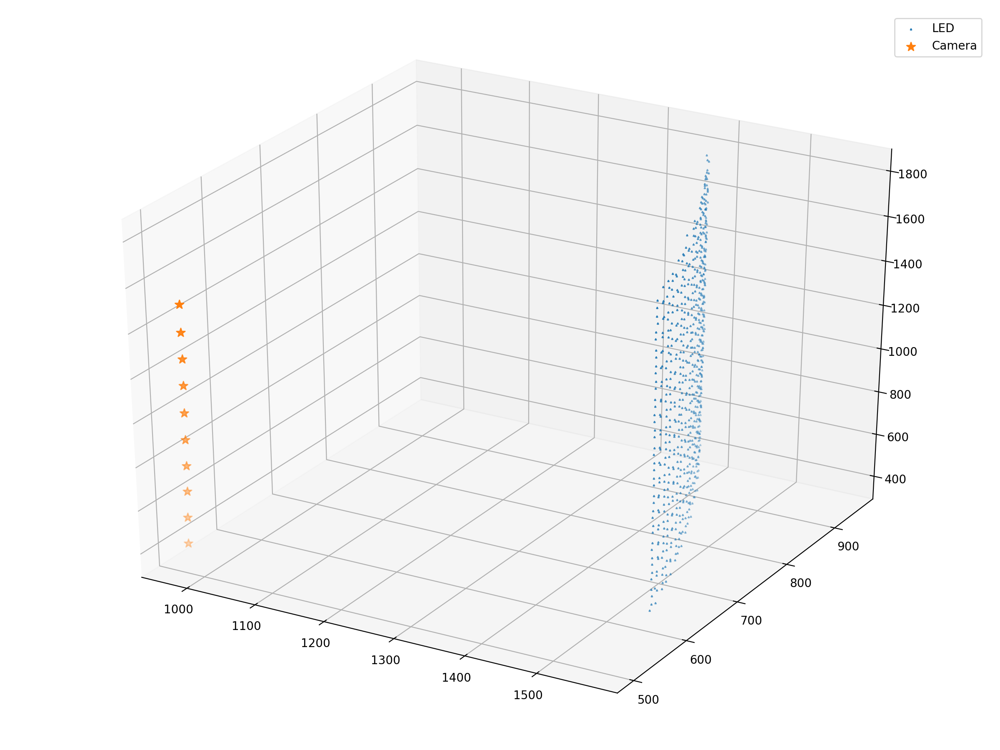

=== Gaussian errors on feature image locations: 3.0 ===
Smeared feature in image counts: Counter({5: 211, 6: 191, 4: 126, 3: 102, 2: 60, 1: 30})
image 0 reprojection errors:    average: 6.587812052330746    max: 18.113201341945857
image 1 reprojection errors:    average: 6.63341901531508    max: 19.136118438876792
image 2 reprojection errors:    average: 7.411855151518297    max: 20.47453570543505
image 3 reprojection errors:    average: 7.097273525587814    max: 20.85815056063469
image 4 reprojection errors:    average: 6.781460164815311    max: 19.489387454552638
image 5 reprojection errors:    average: 6.847414719847542    max: 25.224601493201146
image 6 reprojection errors:    average: 6.546755216640908    max: 20.55219208334153
image 7 reprojection errors:    average: 7.009191372649165    max: 19.9761520181067
image 8 reprojection errors:    average: 6.405709142601699    max: 19.160245358397216
image 9 reprojection errors:    average: 6.4353478631898975    max: 15.983601502411302


<IPython.core.display.Javascript object>


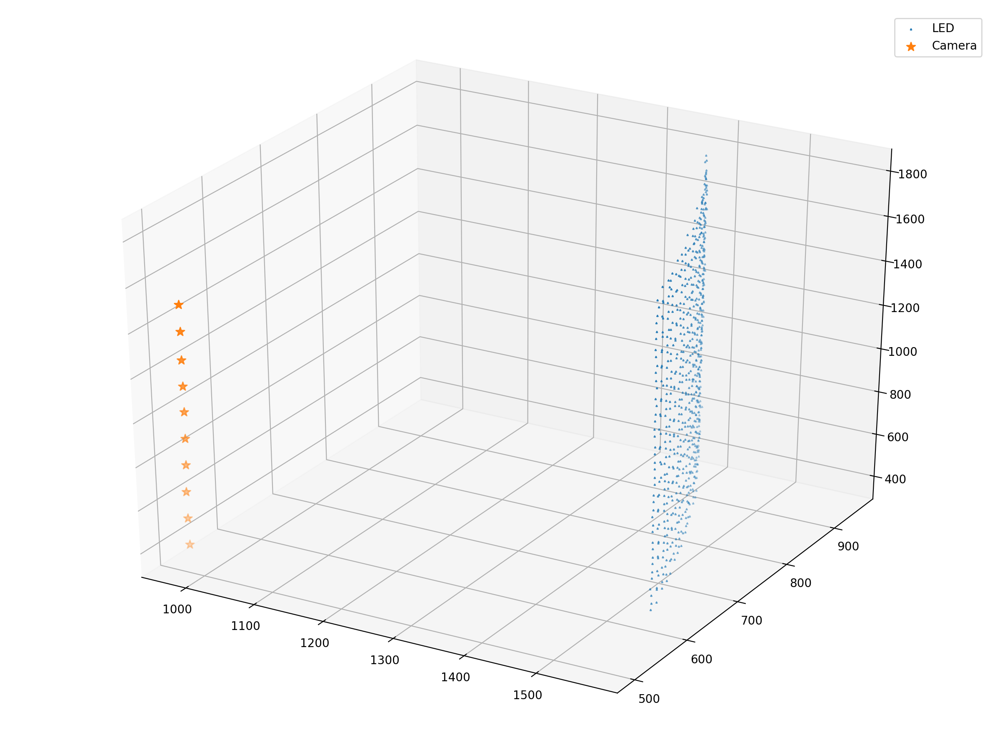

In [26]:
fig_bolt_pos, ax_bolt_pos = make_fig("Reconstructed bolt position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_pos, ax_ring_pos = make_fig("Reconstructed bolt ring centre position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_ang, ax_ring_ang = make_fig("Reconstructed bolt ring orientation error with {} bolts/PMT".format(bolt_count), "Angle between true and reco. orientation [deg]")
for pixel_error in [0.5, 1.0, 2.0, 3.0]:
    print("=== Gaussian errors on feature image locations:", pixel_error, "===")
    smeared_feature_locations = get_smeared_feature_locations(image_feature_locations, pixel_error)
    fitter = setup_bolt_simulation(bolt_positions, smeared_feature_locations, focal_length, principle_point, radial_distortion)    
    reco_bolt_positions, position_errors = run_bolt_fit(fitter, bolt_positions)
    centre_errors = get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count)
    orientation_errors = get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count)
    ax_bolt_pos.hist(position_errors, bins=20, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, position_errors.mean()))
    ax_ring_pos.hist(centre_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, centre_errors.mean()))
    ax_ring_ang.hist(orientation_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} deg".format(pixel_error, orientation_errors.mean()))
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_bolt_positions)
    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(fitter.camera_rotations, fitter.camera_translations)
    plot_reconstruction(reco_transformed, reco_cam_positions)
ax_bolt_pos.legend(loc='upper right')
ax_ring_pos.legend(loc='upper right')
ax_ring_ang.legend(loc='upper right')

# Simulation with 4 bolts

Feature in image counts: Counter({5: 150, 6: 120, 4: 78, 3: 66, 2: 48, 1: 18})


/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


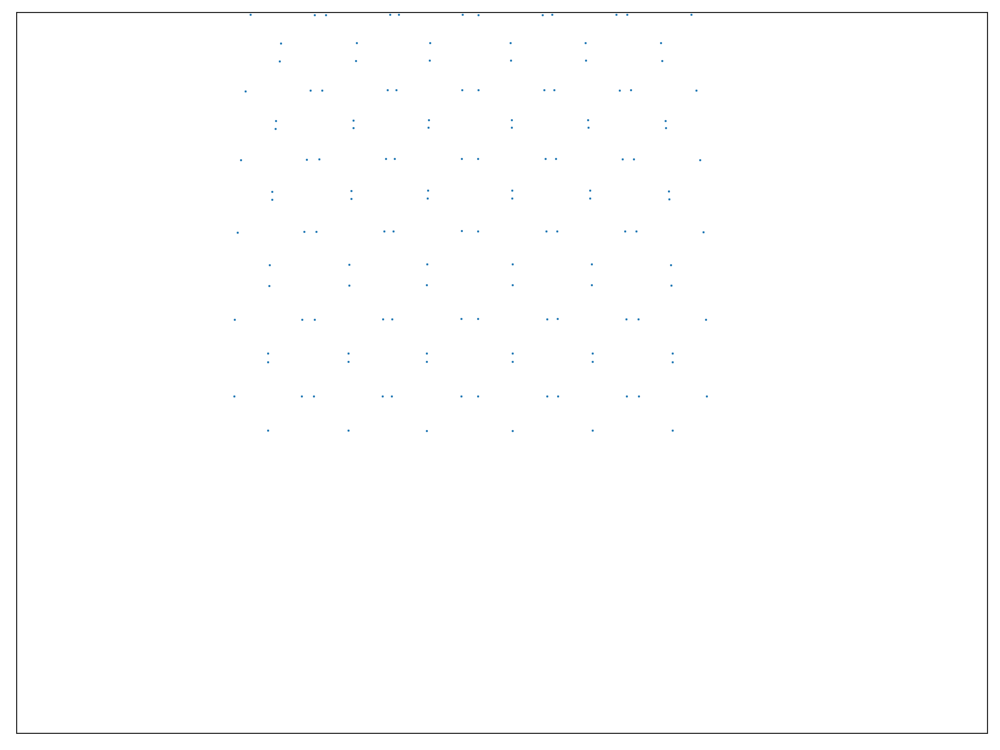

<IPython.core.display.Javascript object>


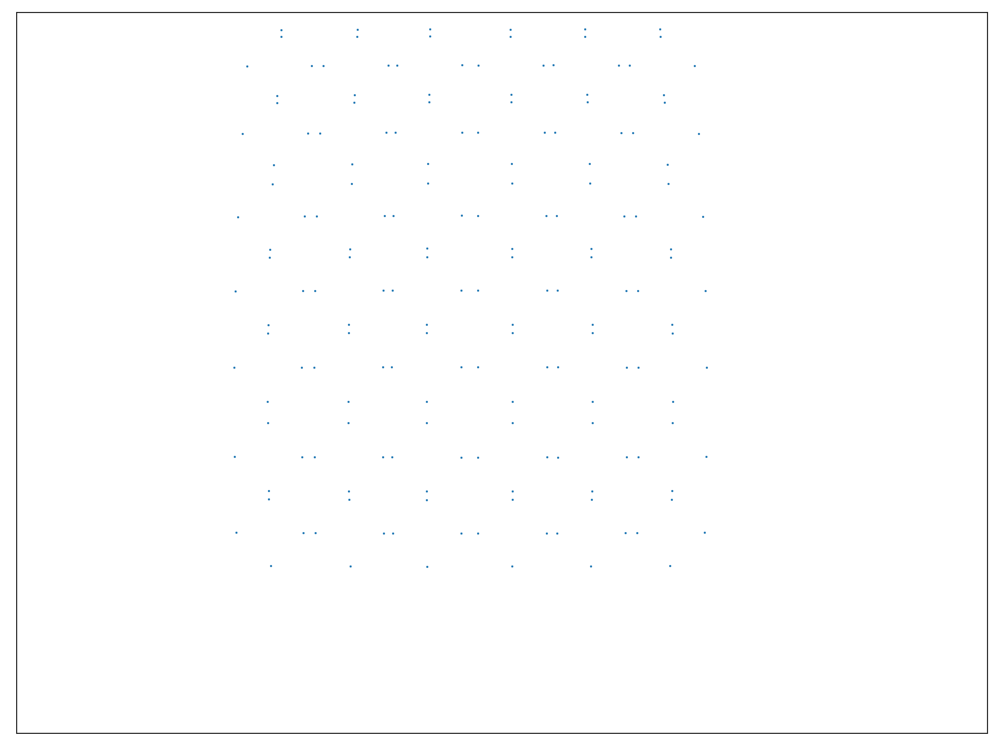

<IPython.core.display.Javascript object>


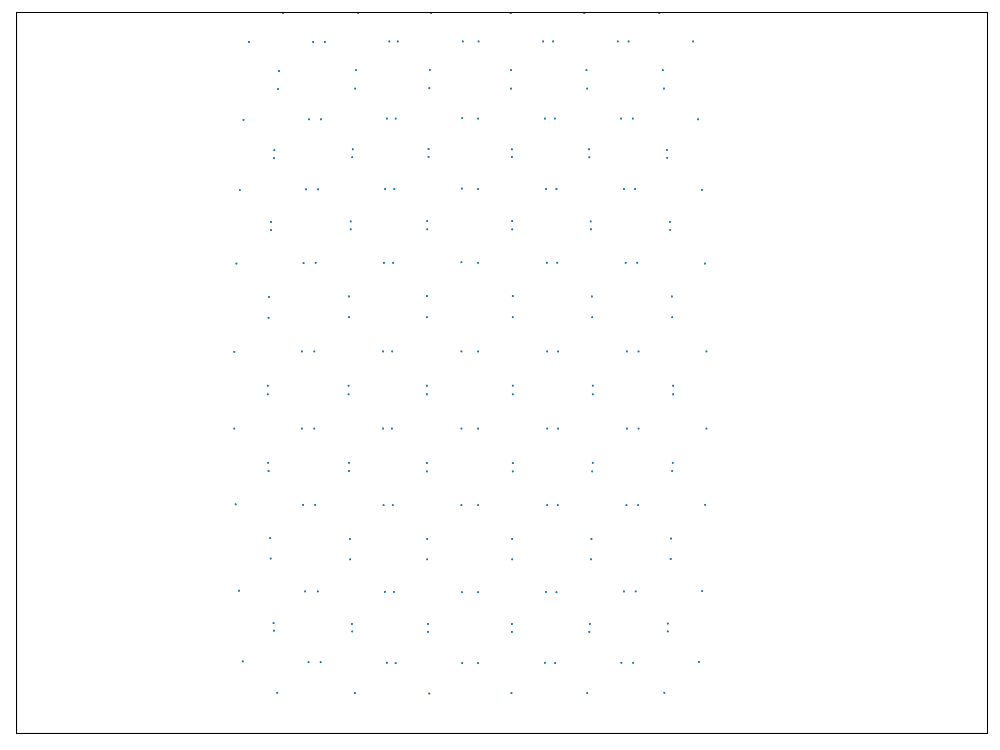

<IPython.core.display.Javascript object>


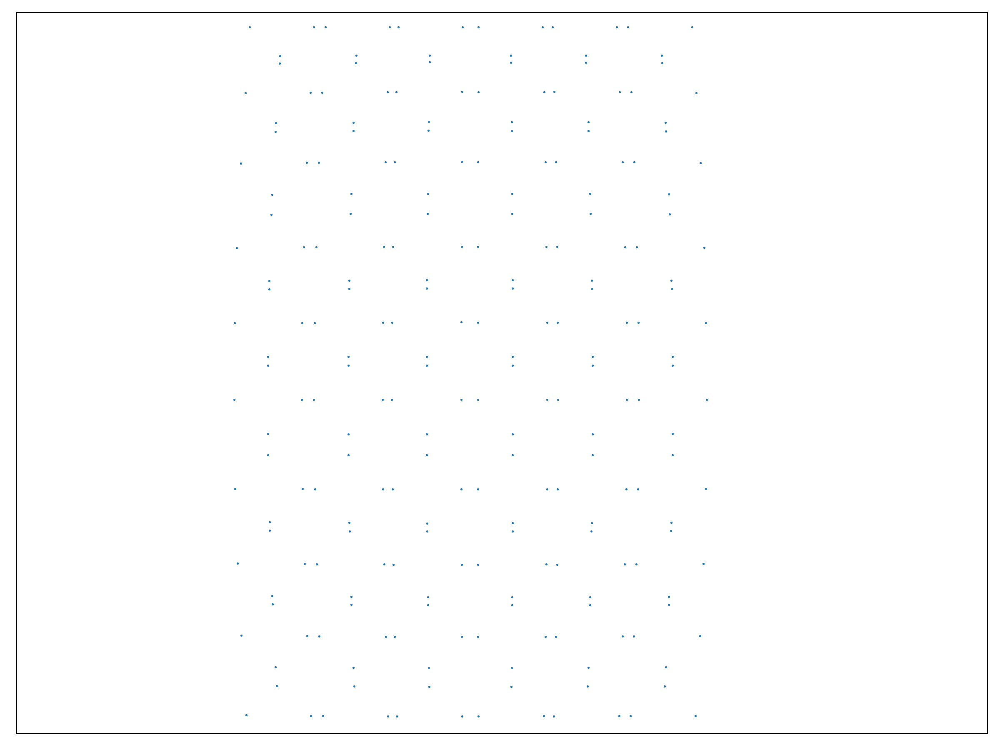

<IPython.core.display.Javascript object>


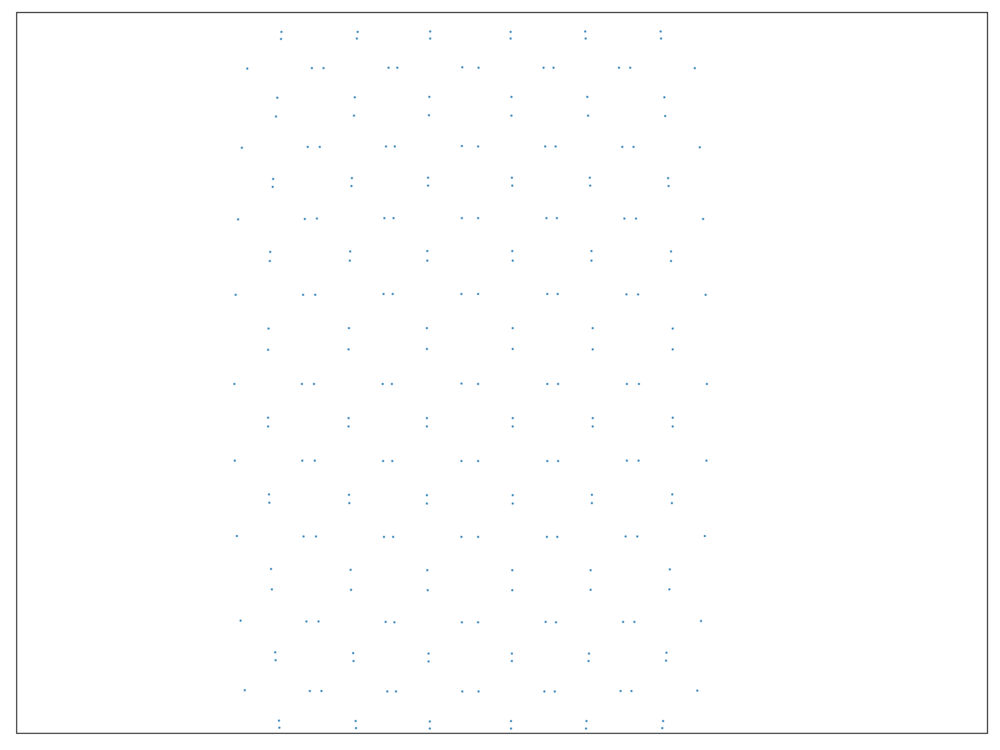

<IPython.core.display.Javascript object>


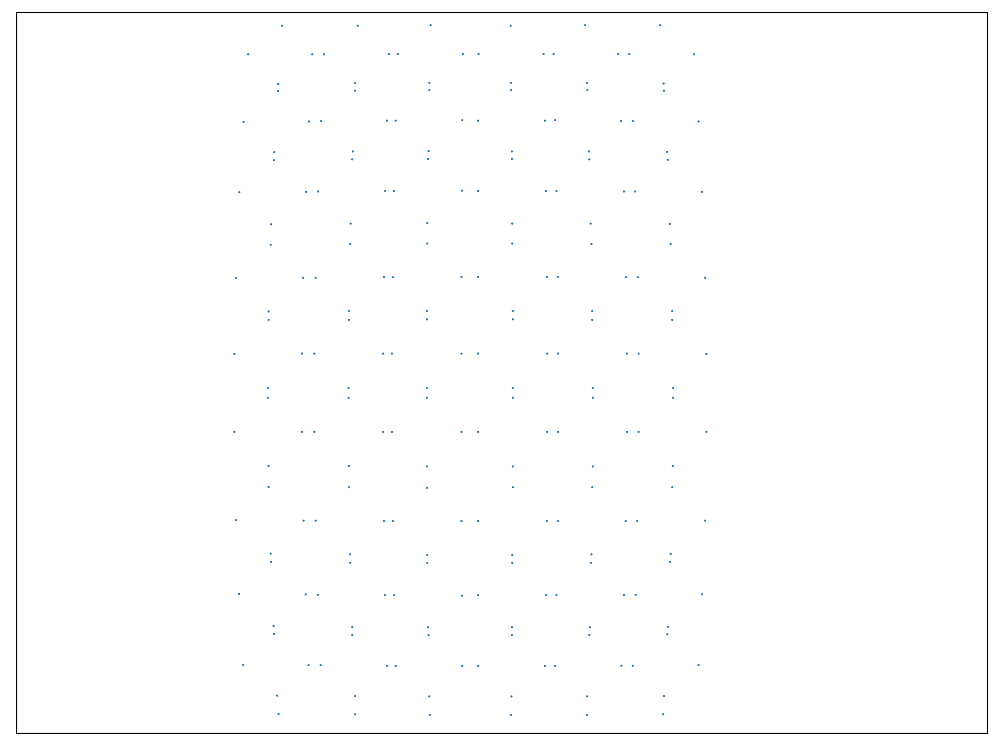

<IPython.core.display.Javascript object>


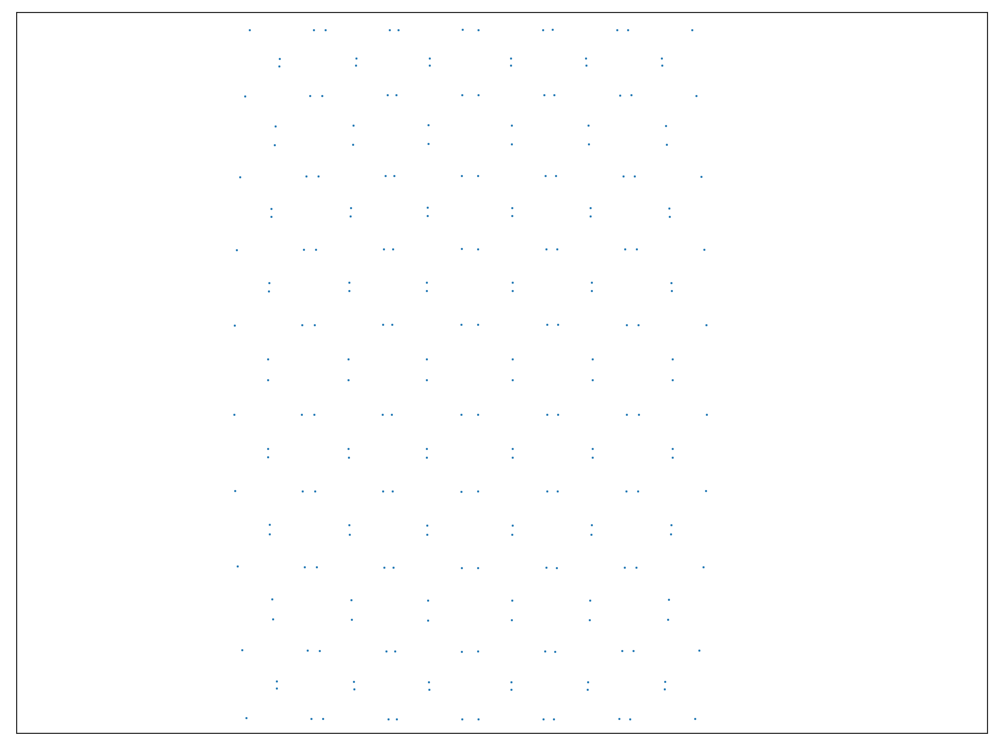

<IPython.core.display.Javascript object>


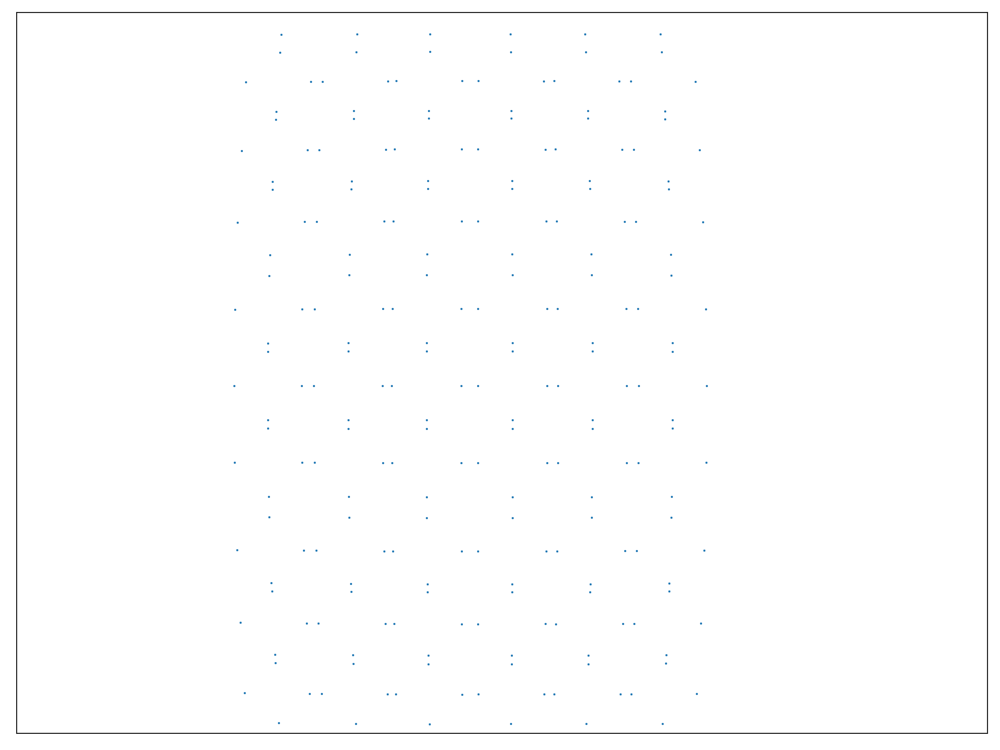

<IPython.core.display.Javascript object>


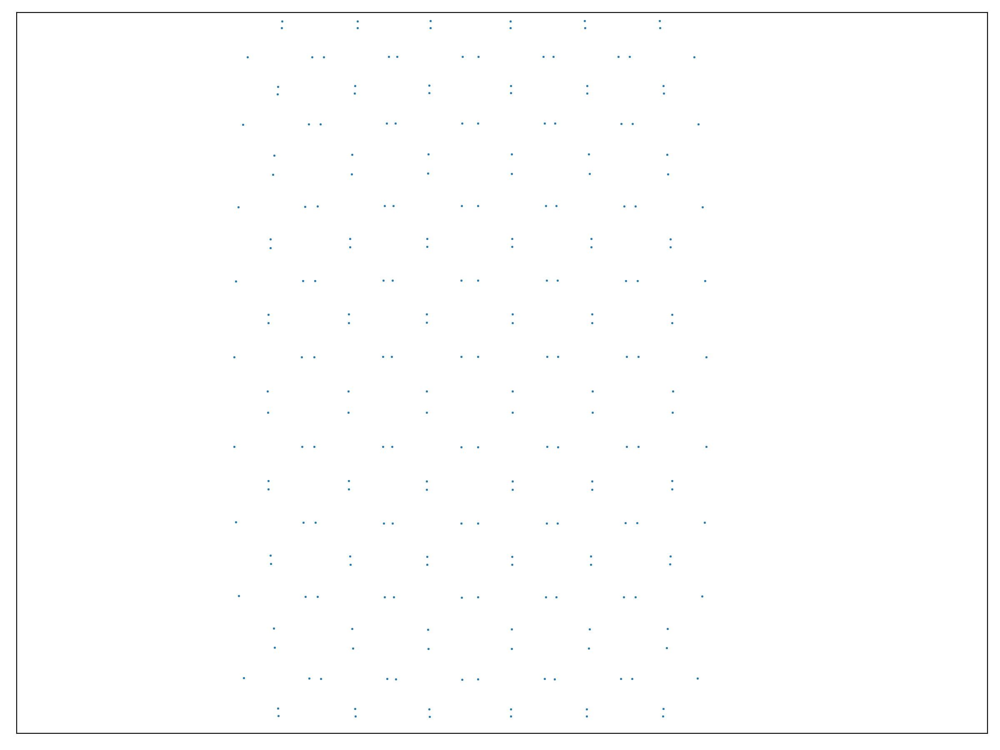

<IPython.core.display.Javascript object>


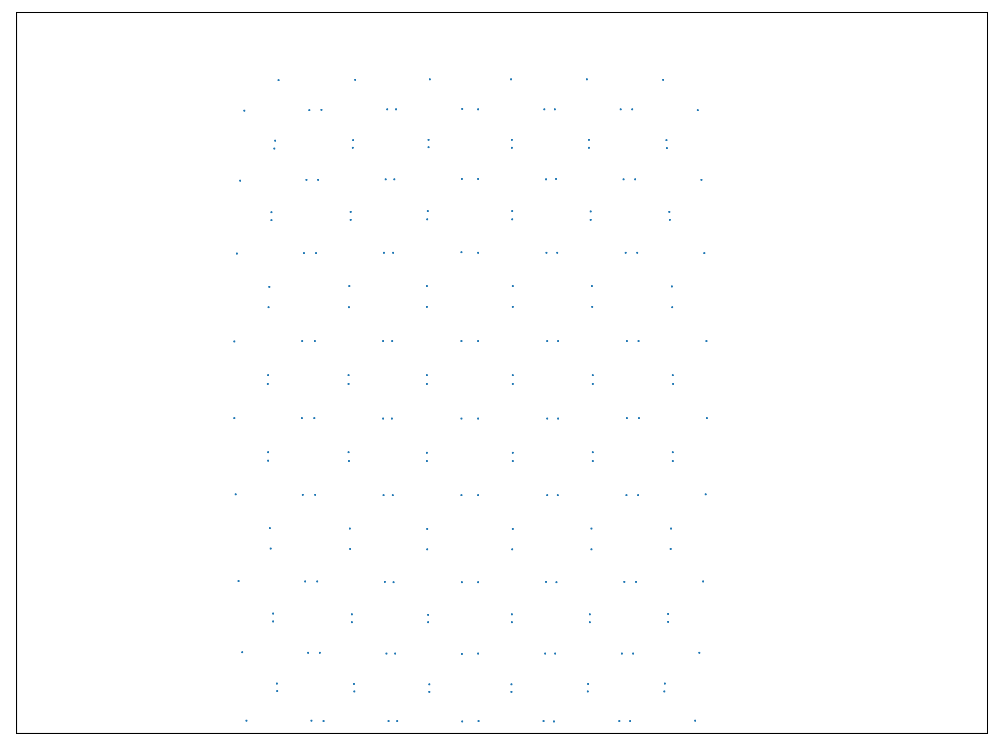

In [27]:
bolt_count = 4
bolt_positions = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = get_ring_positions(bolt_positions, pmt_locations.keys(), bolt_count)
ring_orientations = get_ring_orientations(bolt_positions, pmt_locations.keys(), bolt_count)
image_feature_locations = get_image_feature_locations(bolt_positions, camera_matrix, distortion, camera_rotations, camera_translations)
plot_images(image_feature_locations)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


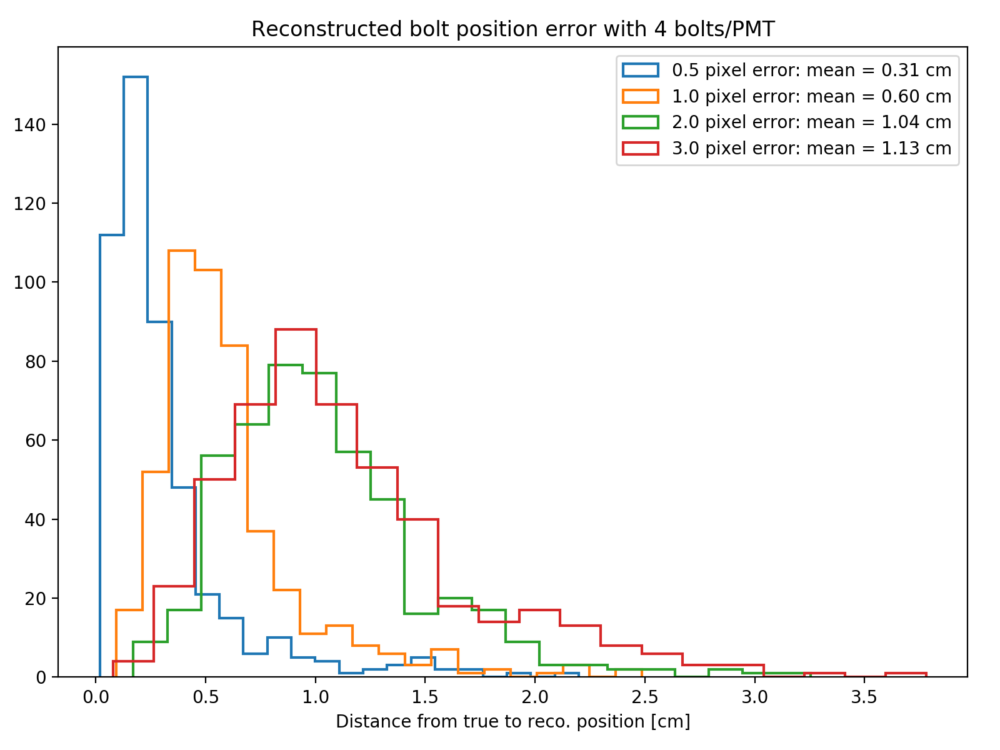

<IPython.core.display.Javascript object>


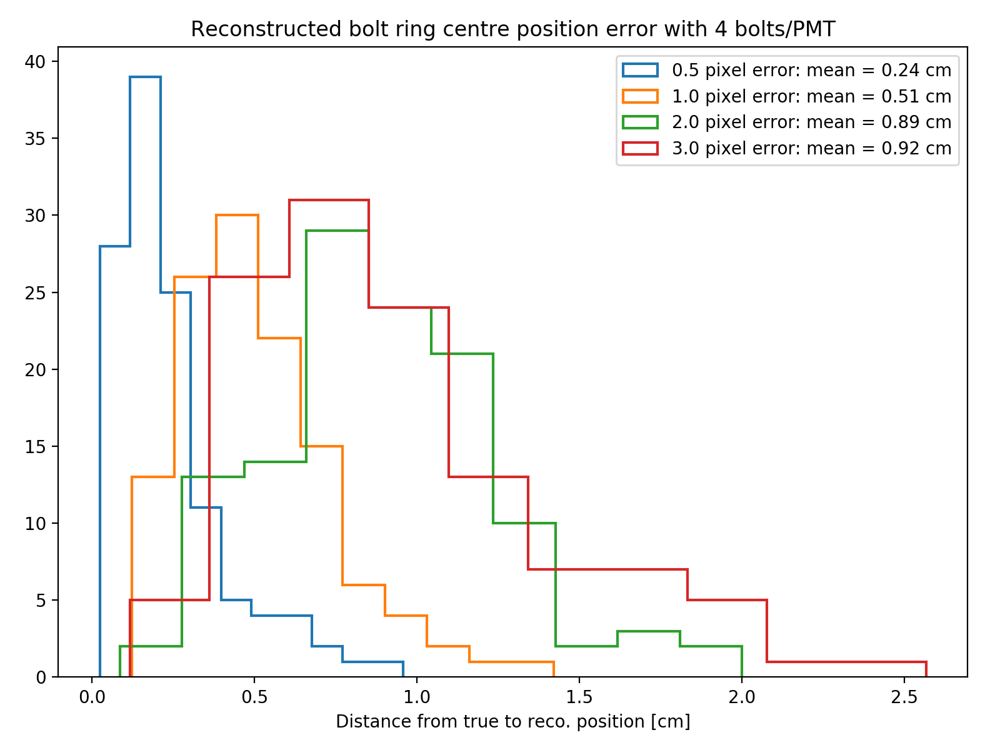

<IPython.core.display.Javascript object>


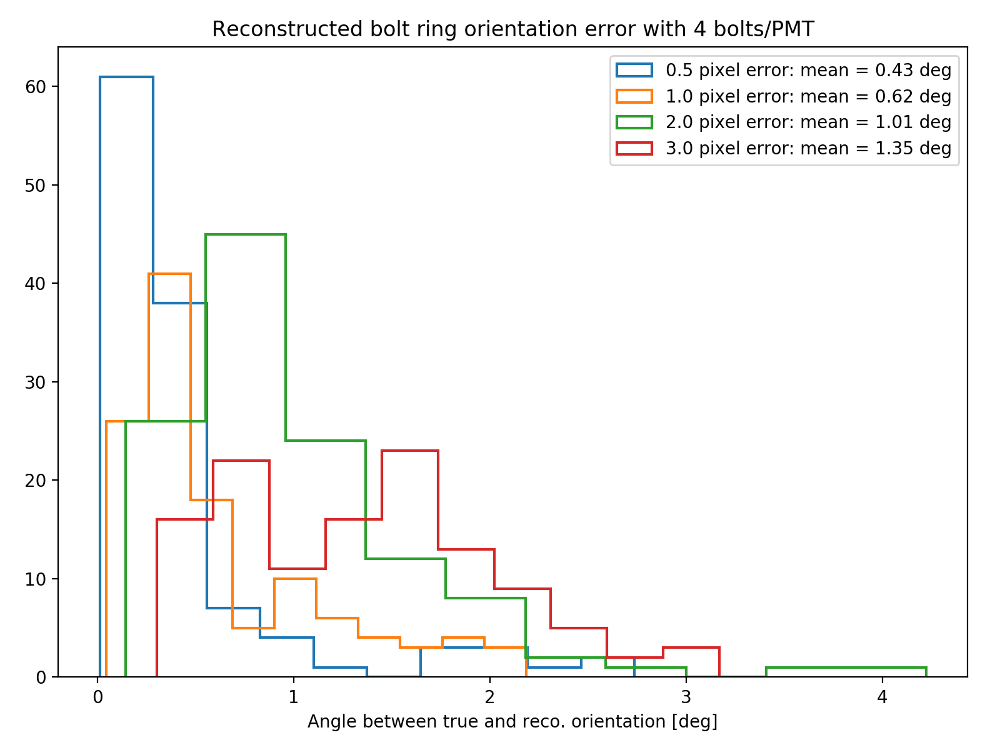

=== Gaussian errors on feature image locations: 0.5 ===
Smeared feature in image counts: Counter({5: 150, 6: 120, 4: 78, 3: 66, 2: 48, 1: 18})
image 0 reprojection errors:    average: 6.313346434479329    max: 17.10027813282145
image 1 reprojection errors:    average: 6.177940030384123    max: 17.197082333414514
image 2 reprojection errors:    average: 6.4301461507216295    max: 17.423265526255587
image 3 reprojection errors:    average: 6.034697000896075    max: 17.13508779036005
image 4 reprojection errors:    average: 6.088455832905075    max: 15.408067068449826
image 5 reprojection errors:    average: 6.075587164688119    max: 14.43887545694797
image 6 reprojection errors:    average: 6.375752578423897    max: 16.624830259297216
image 7 reprojection errors:    average: 6.258807895385307    max: 17.348853994320436
image 8 reprojection errors:    average: 6.029857173007742    max: 16.003337538893547
image 9 reprojection errors:    average: 6.273695892039001    max: 16.000528953769592

<IPython.core.display.Javascript object>


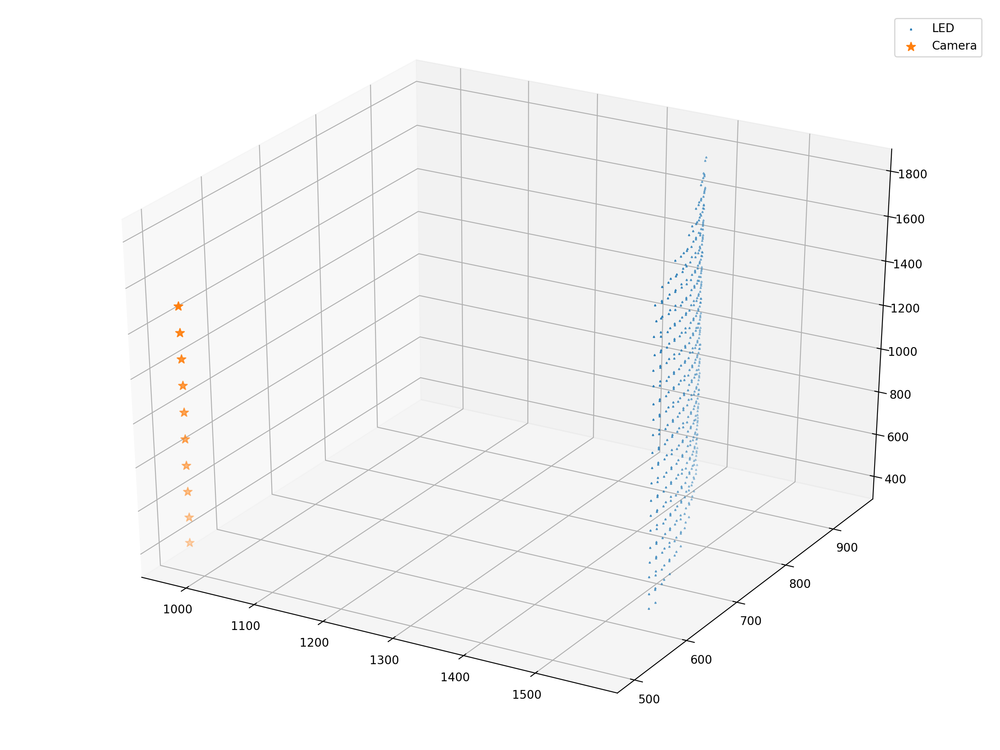

=== Gaussian errors on feature image locations: 1.0 ===
Smeared feature in image counts: Counter({5: 150, 6: 120, 4: 78, 3: 66, 2: 48, 1: 18})
image 0 reprojection errors:    average: 6.378991874509847    max: 15.637783733639942
image 1 reprojection errors:    average: 6.508499364470433    max: 17.06364041728038
image 2 reprojection errors:    average: 7.42160705884863    max: 18.836470950618974
image 3 reprojection errors:    average: 7.735332637327869    max: 18.86147615421525
image 4 reprojection errors:    average: 6.62374828069781    max: 17.125900104880696
image 5 reprojection errors:    average: 6.513772223324616    max: 18.511916028857083
image 6 reprojection errors:    average: 6.50272041483836    max: 16.874106430010396
image 7 reprojection errors:    average: 6.0713565820763815    max: 19.225988666971094
image 8 reprojection errors:    average: 5.743547985381924    max: 18.426095550343433
image 9 reprojection errors:    average: 5.870471444555415    max: 20.25057526862356
  

      80             81         8.6239e+02      7.19e-01       5.66e-02       4.40e+02    
      81             82         8.6168e+02      7.14e-01       5.20e-02       4.33e+02    
      82             83         8.6097e+02      7.10e-01       5.63e-02       4.19e+02    
      83             84         8.6026e+02      7.06e-01       5.17e-02       4.12e+02    
      84             85         8.5956e+02      7.02e-01       5.60e-02       3.99e+02    
      85             86         8.5886e+02      6.98e-01       5.14e-02       3.92e+02    
      86             87         8.5817e+02      6.94e-01       5.57e-02       3.81e+02    
      87             88         8.5748e+02      6.90e-01       5.11e-02       3.73e+02    
      88             89         8.5679e+02      6.86e-01       5.54e-02       3.63e+02    
      89             90         8.5611e+02      6.83e-01       5.08e-02       3.55e+02    
      90             91         8.5543e+02      6.79e-01       5.51e-02       3.46e+02    

<IPython.core.display.Javascript object>


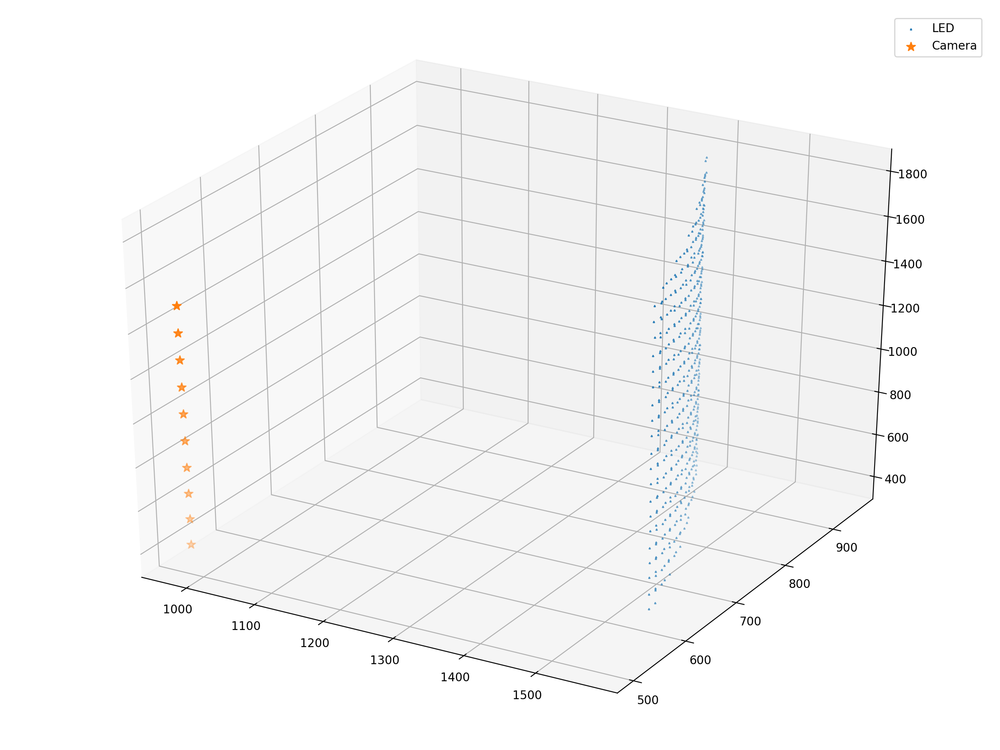

=== Gaussian errors on feature image locations: 2.0 ===
Smeared feature in image counts: Counter({5: 152, 6: 118, 4: 78, 3: 66, 2: 48, 1: 18})
image 0 reprojection errors:    average: 5.816684639403974    max: 15.399676844346475
image 1 reprojection errors:    average: 6.328122413397178    max: 14.586231634723116
image 2 reprojection errors:    average: 7.001450896245559    max: 24.129078337262392
image 3 reprojection errors:    average: 7.323995898907655    max: 24.047186497979563
image 4 reprojection errors:    average: 7.129864915190491    max: 18.3615503896082
image 5 reprojection errors:    average: 6.847646606693189    max: 19.439290944124796
image 6 reprojection errors:    average: 7.698246445931827    max: 18.648049742891274
image 7 reprojection errors:    average: 6.496048186412214    max: 18.66912396197561
image 8 reprojection errors:    average: 6.00419855278608    max: 16.445737644297015
image 9 reprojection errors:    average: 6.059898094242099    max: 17.663100695726545
 

<IPython.core.display.Javascript object>


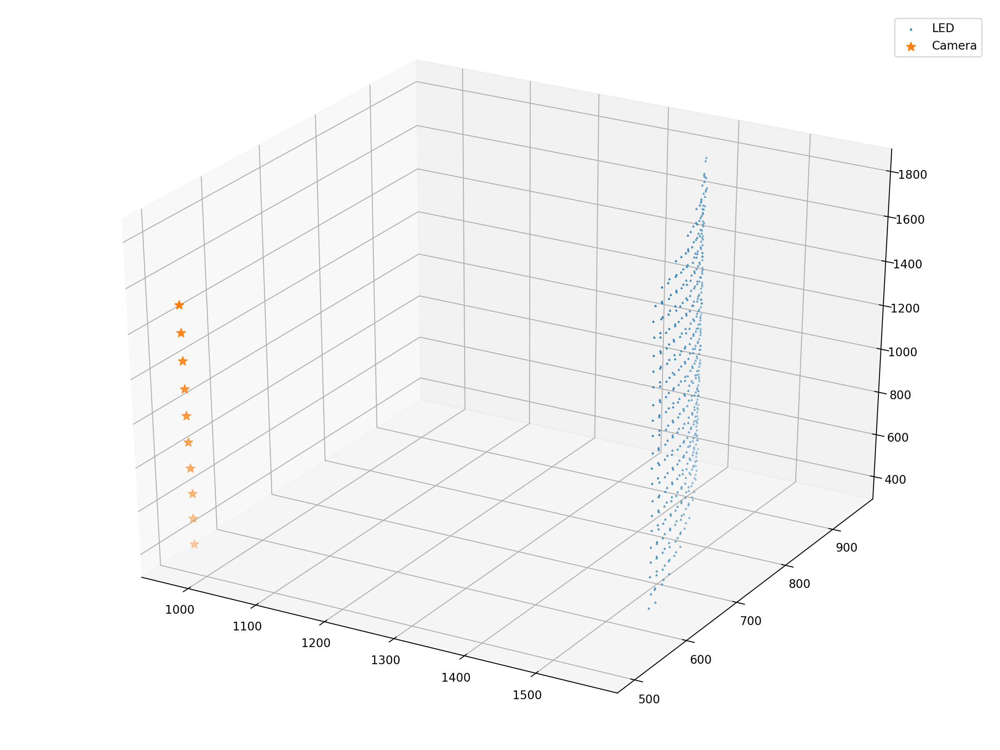

=== Gaussian errors on feature image locations: 3.0 ===
Smeared feature in image counts: Counter({5: 153, 6: 117, 4: 78, 3: 66, 2: 48, 1: 18})
image 0 reprojection errors:    average: 6.463148419804366    max: 17.519468440257526
image 1 reprojection errors:    average: 7.036427682629165    max: 14.548869161513855
image 2 reprojection errors:    average: 6.581003809757428    max: 15.161849738022433
image 3 reprojection errors:    average: 6.533718311763786    max: 16.734869399548842
image 4 reprojection errors:    average: 7.118983081619897    max: 17.778515200658823
image 5 reprojection errors:    average: 8.190119069035493    max: 21.61160943564752
image 6 reprojection errors:    average: 7.428746002098072    max: 19.812600000909526
image 7 reprojection errors:    average: 7.607048970256766    max: 18.71511343303155
image 8 reprojection errors:    average: 7.975246468697648    max: 20.441722366556103
image 9 reprojection errors:    average: 6.920169417852208    max: 17.528099746001725

<IPython.core.display.Javascript object>


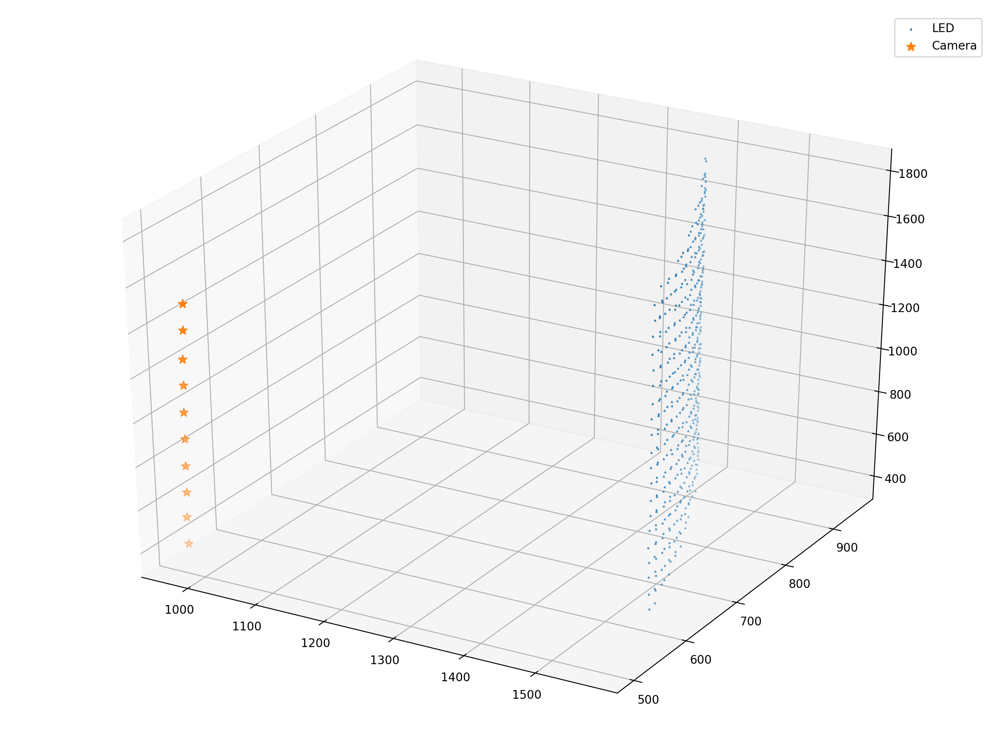

In [28]:
fig_bolt_pos, ax_bolt_pos = make_fig("Reconstructed bolt position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_pos, ax_ring_pos = make_fig("Reconstructed bolt ring centre position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_ang, ax_ring_ang = make_fig("Reconstructed bolt ring orientation error with {} bolts/PMT".format(bolt_count), "Angle between true and reco. orientation [deg]")
for pixel_error in [0.5, 1.0, 2.0, 3.0]:
    print("=== Gaussian errors on feature image locations:", pixel_error, "===")
    smeared_feature_locations = get_smeared_feature_locations(image_feature_locations, pixel_error)
    fitter = setup_bolt_simulation(bolt_positions, smeared_feature_locations, focal_length, principle_point, radial_distortion)    
    reco_bolt_positions, position_errors = run_bolt_fit(fitter, bolt_positions)
    centre_errors = get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count)
    orientation_errors = get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count)
    ax_bolt_pos.hist(position_errors, bins=20, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, position_errors.mean()))
    ax_ring_pos.hist(centre_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, centre_errors.mean()))
    ax_ring_ang.hist(orientation_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} deg".format(pixel_error, orientation_errors.mean()))
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_bolt_positions)
    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(fitter.camera_rotations, fitter.camera_translations)
    plot_reconstruction(reco_transformed, reco_cam_positions)
ax_bolt_pos.legend(loc='upper right')
ax_ring_pos.legend(loc='upper right')
ax_ring_ang.legend(loc='upper right')

# Simulation with 3 bolts

Feature in image counts: Counter({5: 110, 6: 94, 4: 60, 3: 54, 2: 24, 1: 18})


/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


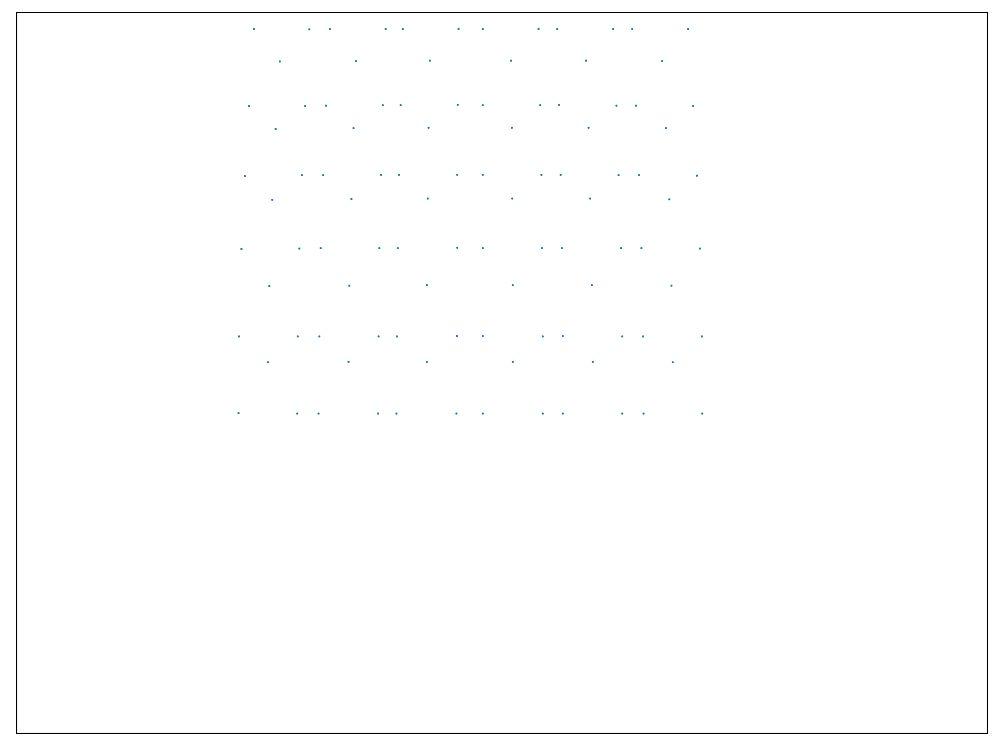

<IPython.core.display.Javascript object>


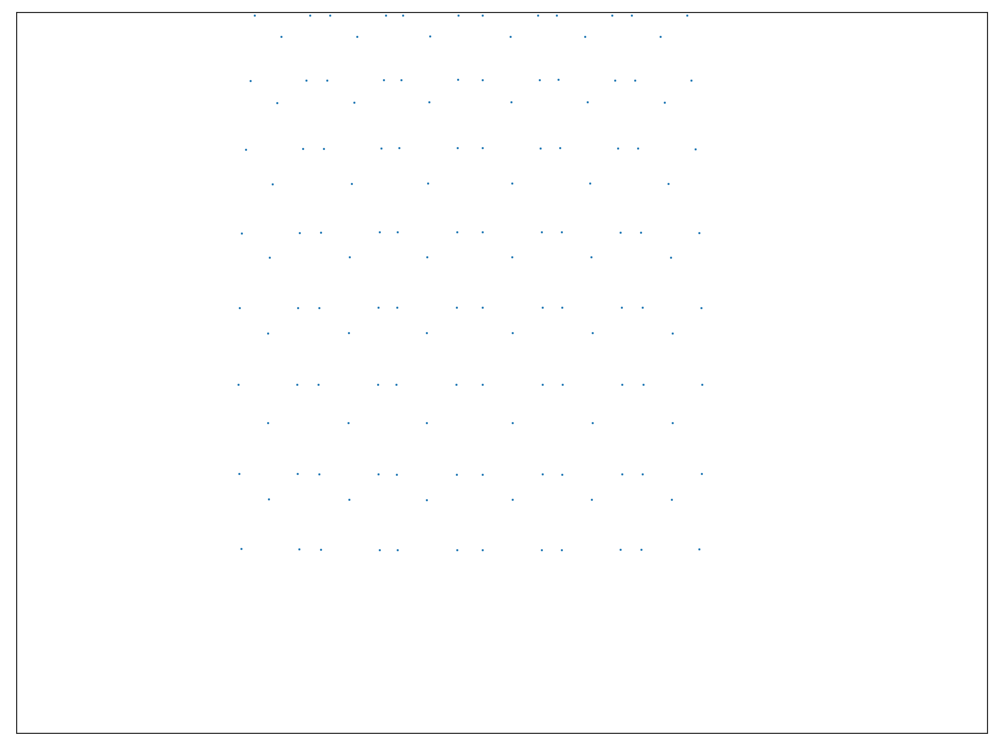

<IPython.core.display.Javascript object>


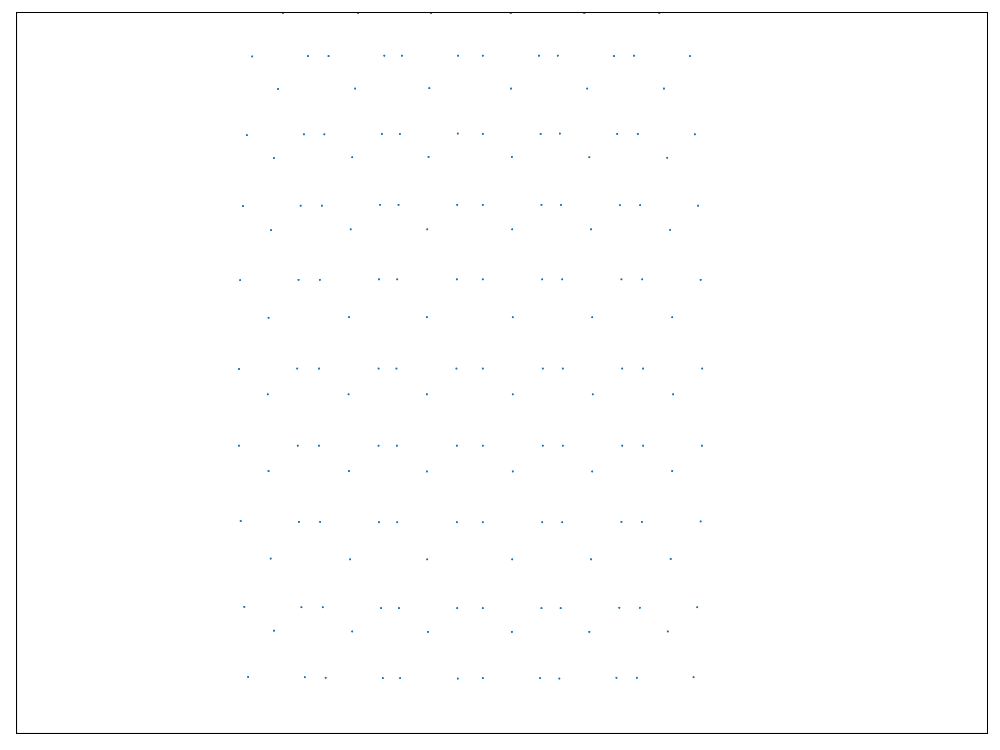

<IPython.core.display.Javascript object>


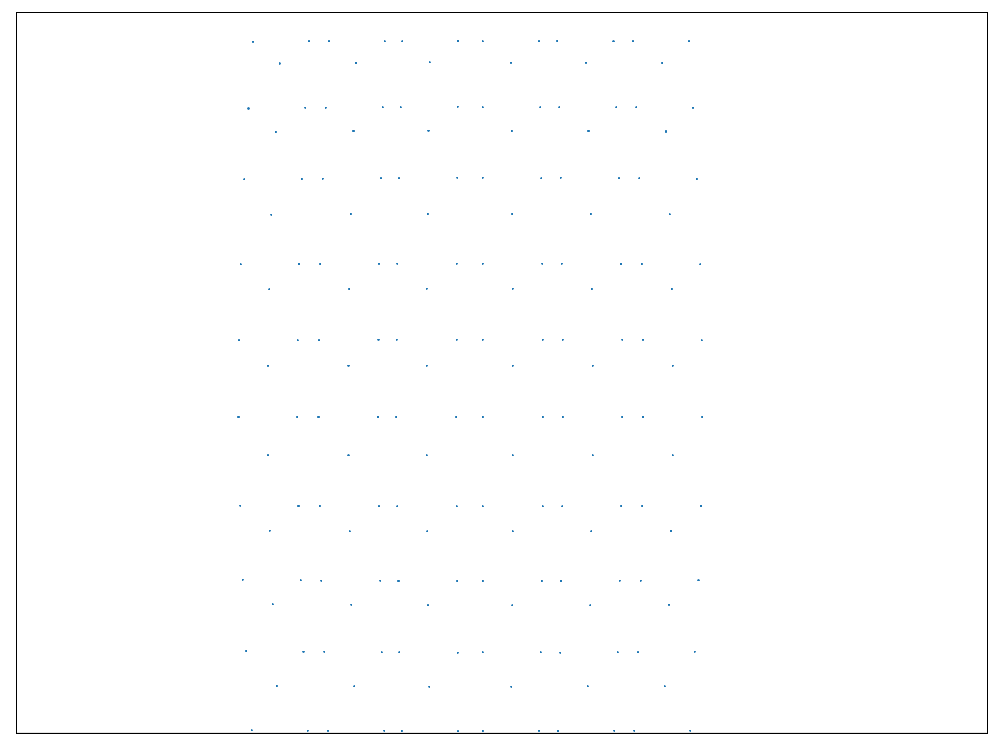

<IPython.core.display.Javascript object>


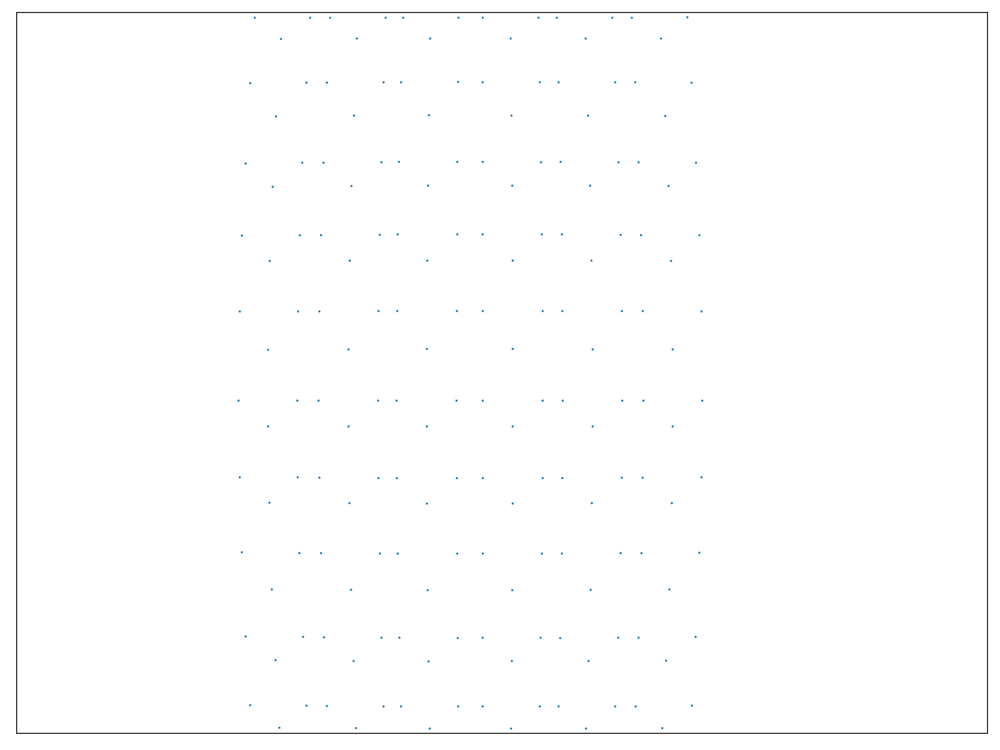

<IPython.core.display.Javascript object>


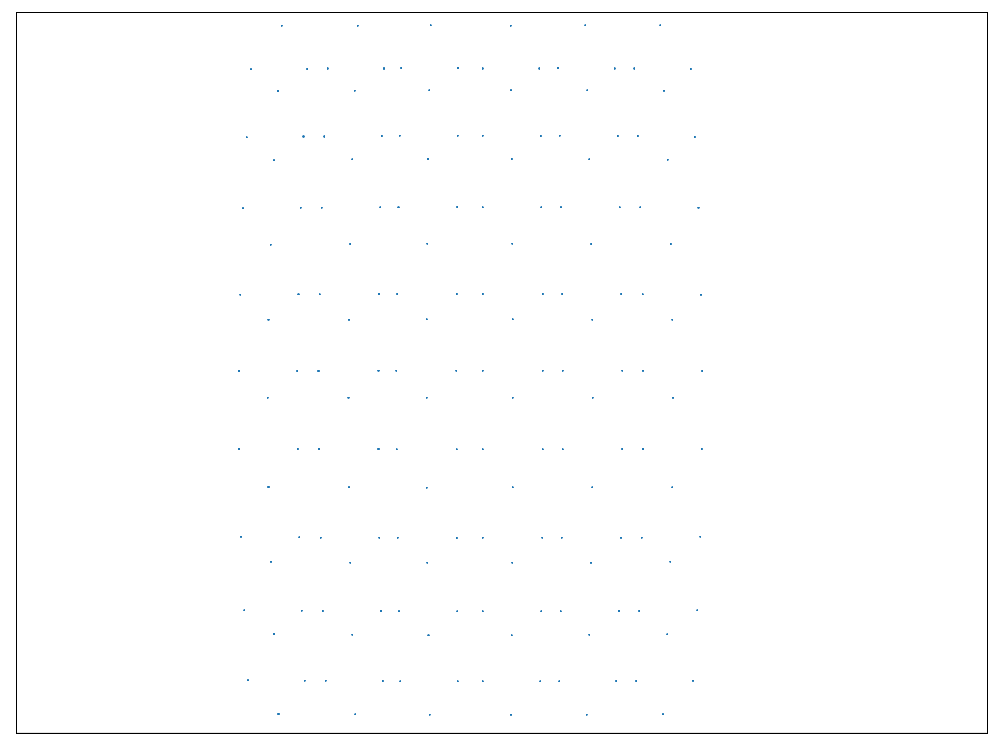

<IPython.core.display.Javascript object>


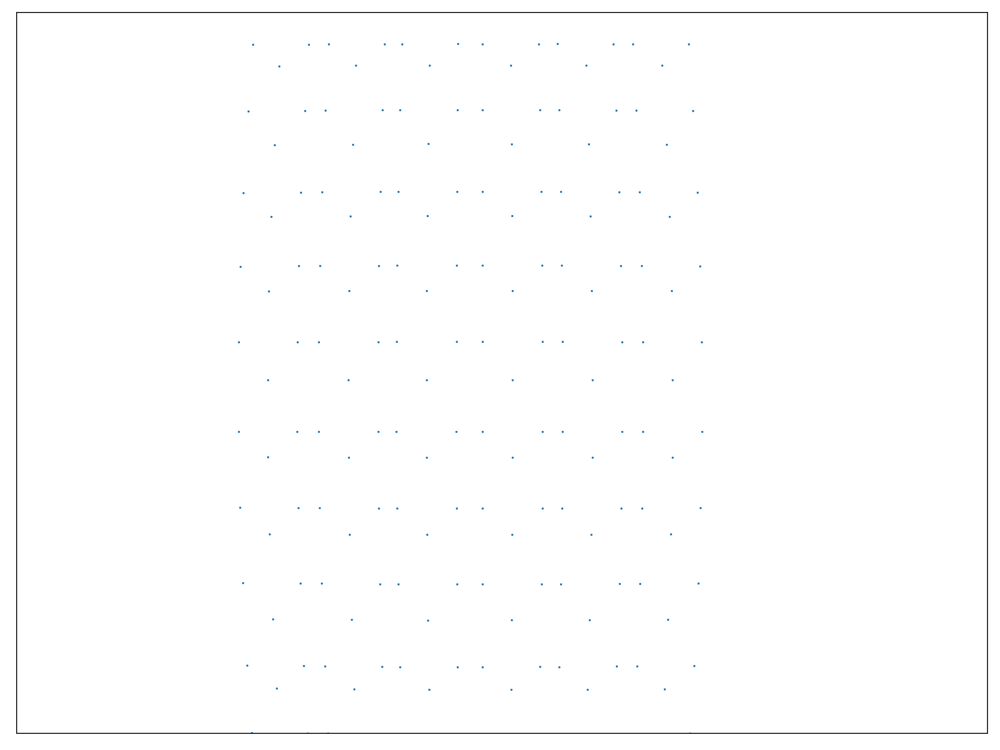

<IPython.core.display.Javascript object>


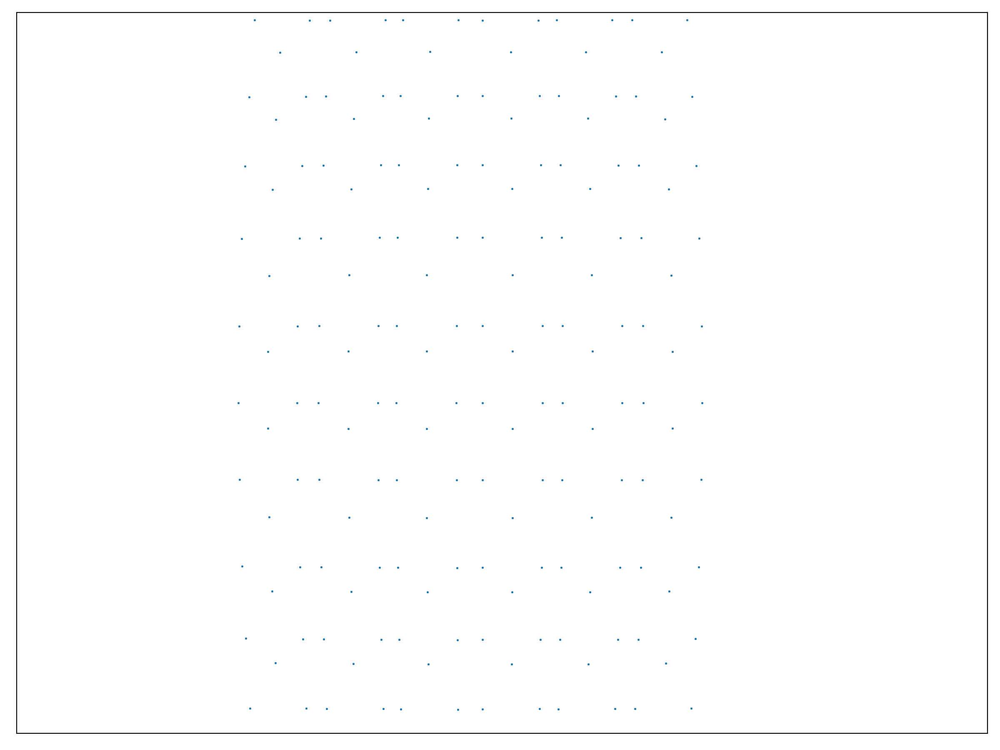

<IPython.core.display.Javascript object>


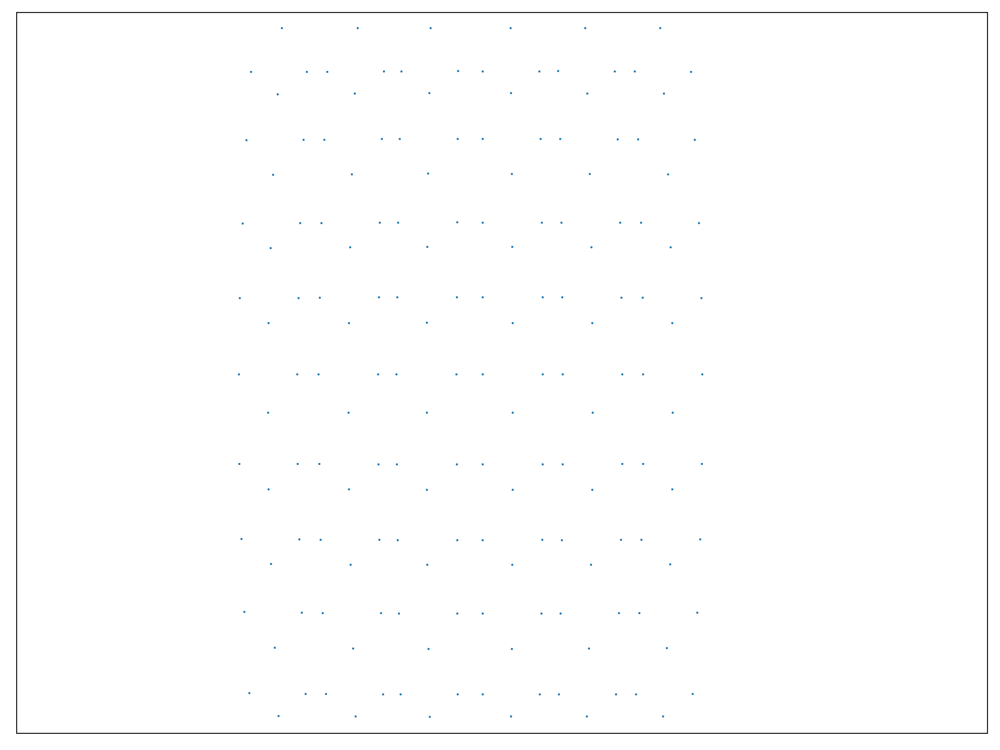

<IPython.core.display.Javascript object>


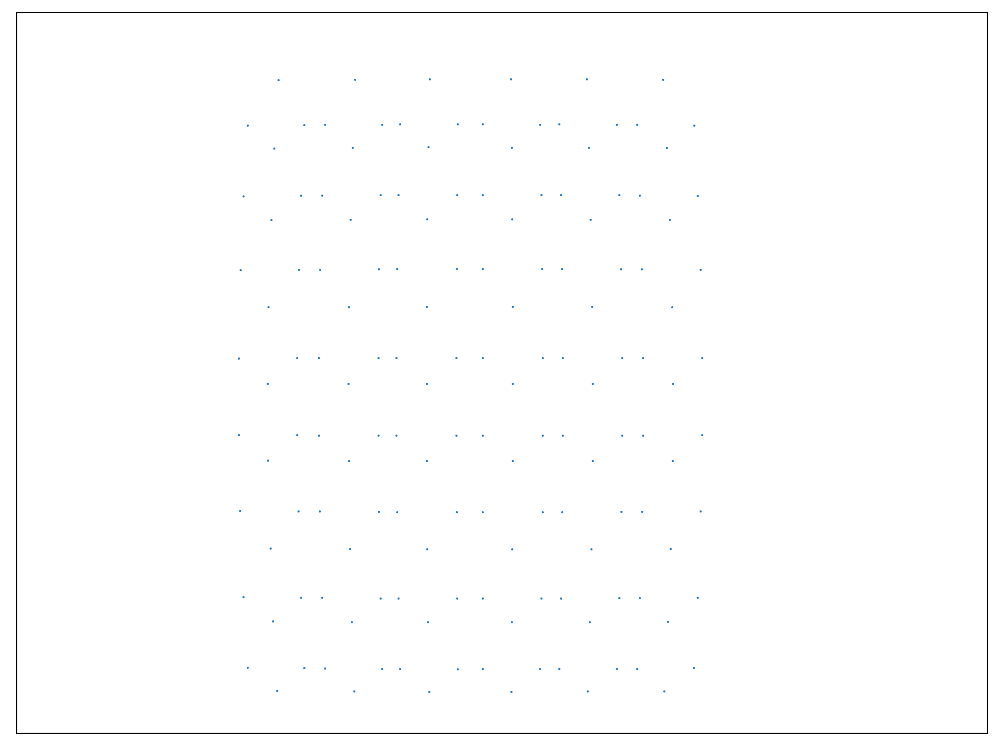

In [29]:
bolt_count = 3
bolt_positions = geo.get_bolt_locations_barrel(pmt_locations, bolt_count)
ring_positions = get_ring_positions(bolt_positions, pmt_locations.keys(), bolt_count)
ring_orientations = get_ring_orientations(bolt_positions, pmt_locations.keys(), bolt_count)
image_feature_locations = get_image_feature_locations(bolt_positions, camera_matrix, distortion, camera_rotations, camera_translations)
plot_images(image_feature_locations)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


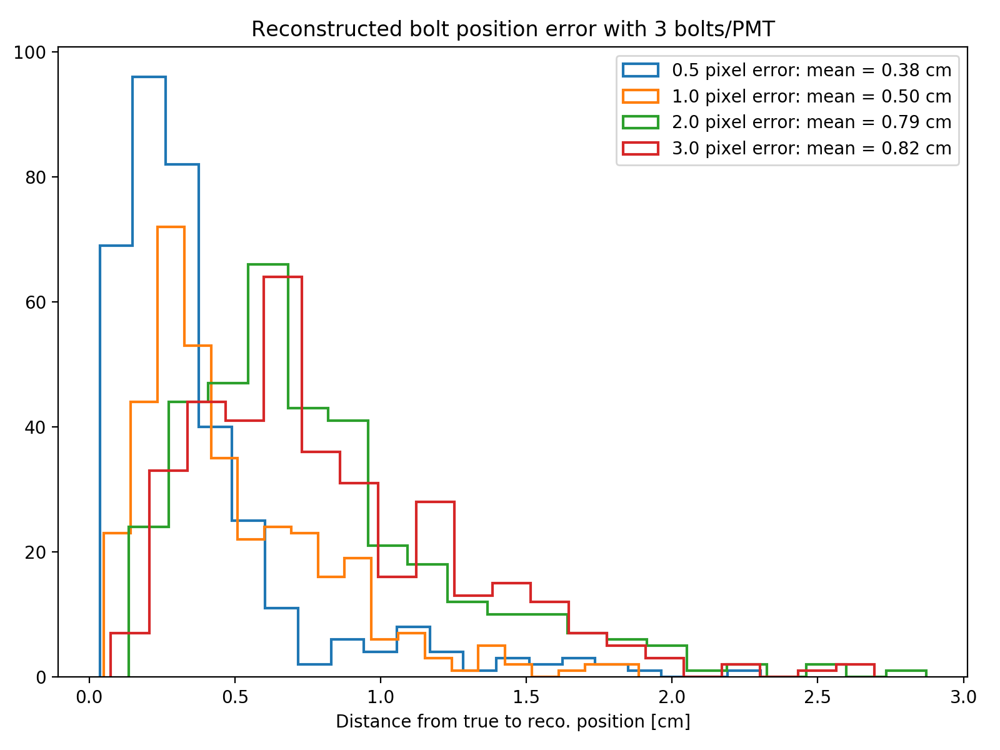

<IPython.core.display.Javascript object>


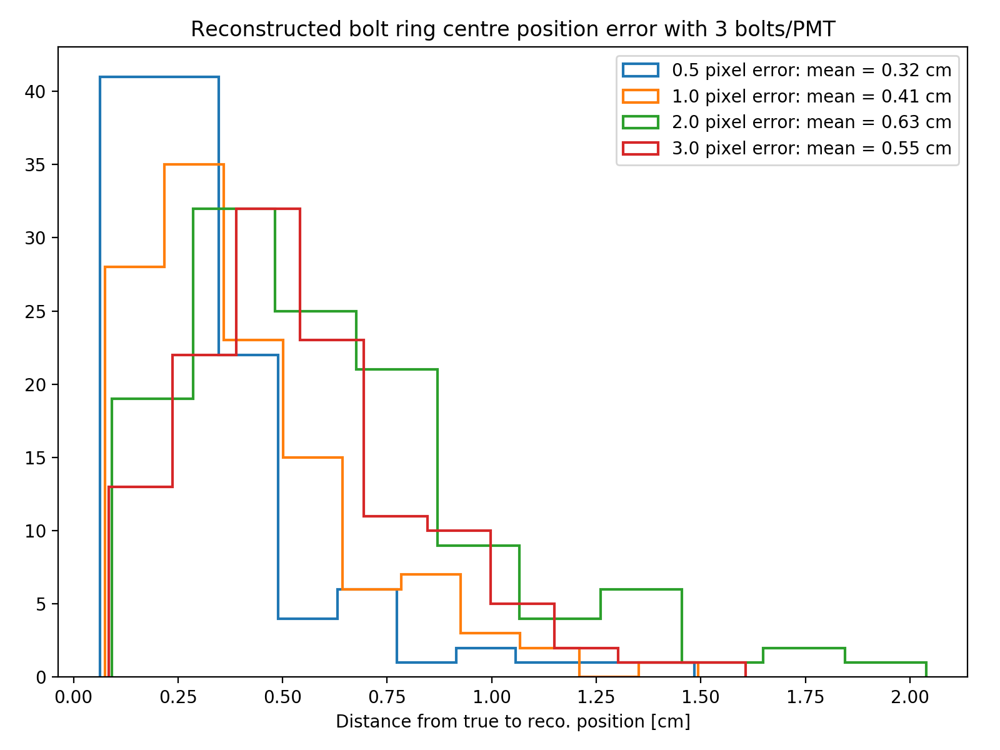

<IPython.core.display.Javascript object>


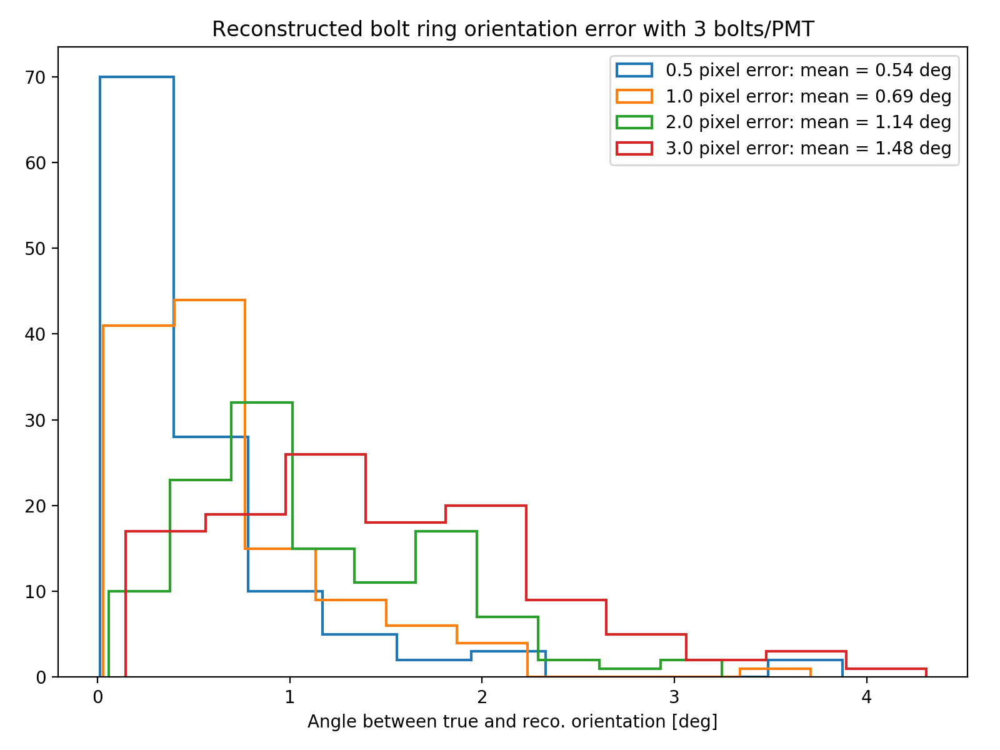

=== Gaussian errors on feature image locations: 0.5 ===
Smeared feature in image counts: Counter({5: 110, 6: 94, 4: 60, 3: 54, 2: 24, 1: 18})
image 0 reprojection errors:    average: 5.9563693857391025    max: 14.884733510773632
image 1 reprojection errors:    average: 5.777833809839893    max: 14.378897099885288
image 2 reprojection errors:    average: 6.172873744345604    max: 15.049908315299342
image 3 reprojection errors:    average: 6.118683257697495    max: 17.3057060691591
image 4 reprojection errors:    average: 5.9437258068307735    max: 19.168204629352807
image 5 reprojection errors:    average: 5.937670857399913    max: 18.59411028450785
image 6 reprojection errors:    average: 6.128007200730839    max: 17.531318790138247
image 7 reprojection errors:    average: 6.64857182426647    max: 15.293569306922961
image 8 reprojection errors:    average: 6.774675324932813    max: 16.66879742174466
image 9 reprojection errors:    average: 6.419095275250043    max: 14.536272752644896
 

<IPython.core.display.Javascript object>


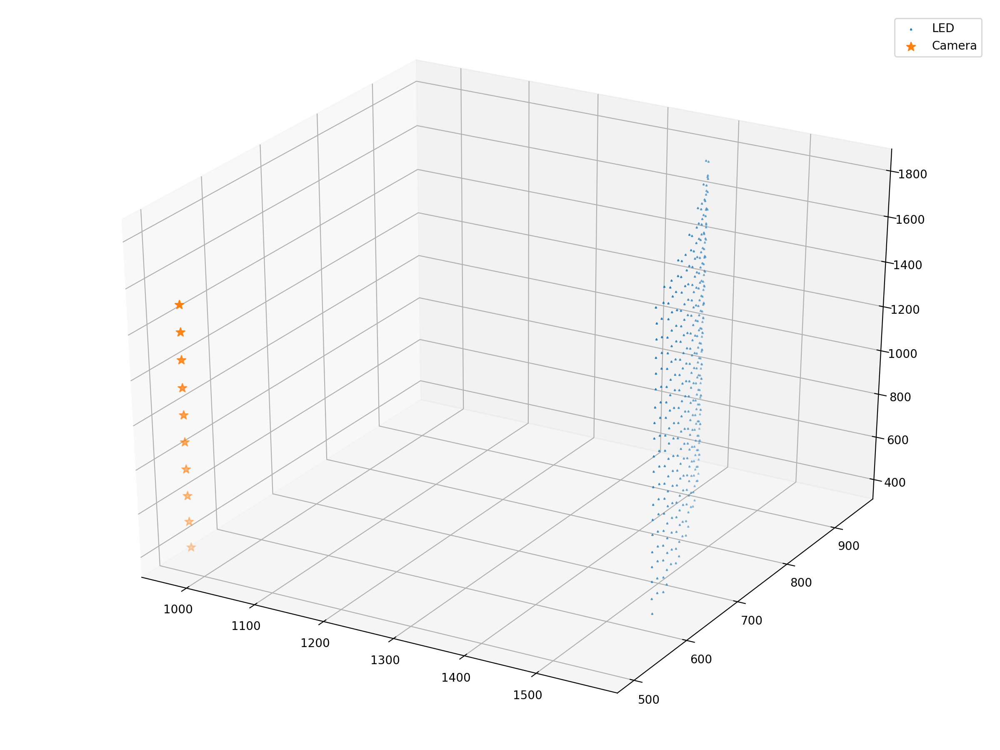

=== Gaussian errors on feature image locations: 1.0 ===
Smeared feature in image counts: Counter({5: 110, 6: 94, 4: 60, 3: 54, 2: 24, 1: 18})
image 0 reprojection errors:    average: 6.759796470775173    max: 18.071074535328677
image 1 reprojection errors:    average: 6.9175036360184965    max: 19.180199784936395
image 2 reprojection errors:    average: 6.949177246356764    max: 17.73181417132589
image 3 reprojection errors:    average: 7.148146858623884    max: 19.00667450181156
image 4 reprojection errors:    average: 6.465541000685511    max: 18.612696608729
image 5 reprojection errors:    average: 6.087078352604034    max: 16.248065394582756
image 6 reprojection errors:    average: 6.462713506538414    max: 22.711476692065947
image 7 reprojection errors:    average: 5.927162617497105    max: 18.256854430550117
image 8 reprojection errors:    average: 6.258866905653964    max: 15.153342748009285
image 9 reprojection errors:    average: 6.050972651217621    max: 13.697788294037966
  

      79             80         6.8933e+02      5.40e-01       4.93e-02       9.66e+02    
      80             81         6.8879e+02      5.33e-01       5.71e-02       1.94e+03    
      81             82         6.8829e+02      5.02e-01       4.45e-02       2.05e+03    
      82             83         6.8797e+02      3.21e-01       2.80e-02       4.33e+03    
`xtol` termination condition is satisfied.
Function evaluations 83, initial cost 4.2494e+04, final cost 6.8797e+02, first-order optimality 4.33e+03.
mean reprojection error: 0.8134849529368565
max reprojection error: 2.9284089887720195
mean reconstruction error: 0.4988549017030285
max reconstruction error: 1.8856468915234756


<IPython.core.display.Javascript object>


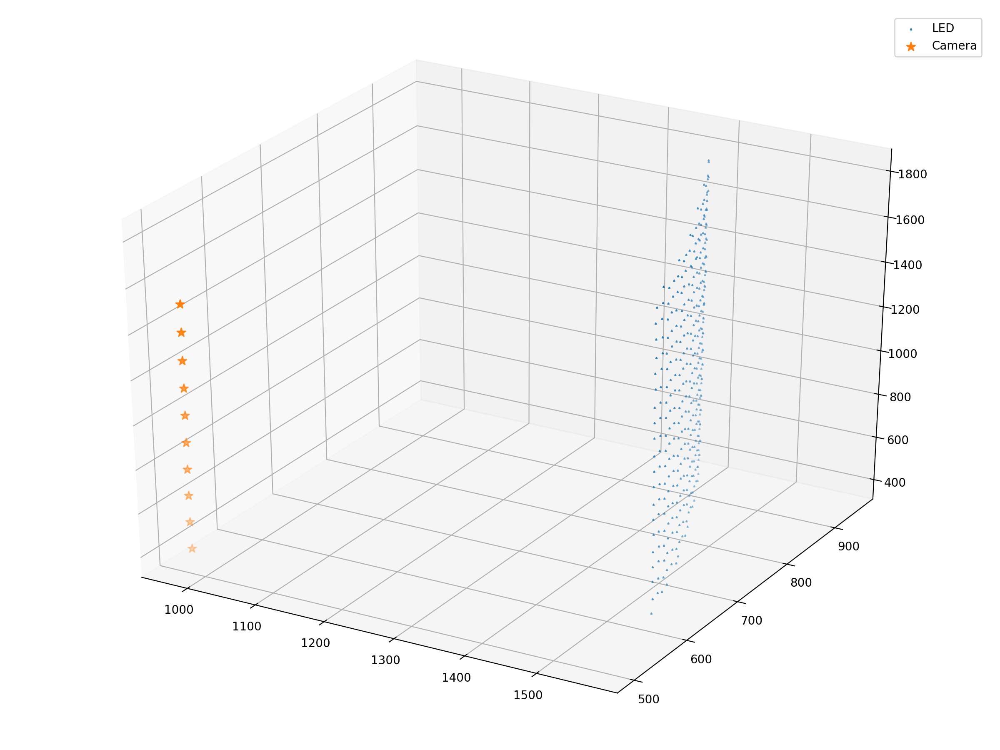

=== Gaussian errors on feature image locations: 2.0 ===
Smeared feature in image counts: Counter({5: 110, 6: 94, 4: 60, 3: 54, 2: 24, 1: 18})
image 0 reprojection errors:    average: 6.369082252367033    max: 19.89126121735406
image 1 reprojection errors:    average: 6.211281058505613    max: 16.69068872219294
image 2 reprojection errors:    average: 6.988769360757446    max: 17.521461779513352
image 3 reprojection errors:    average: 6.854133902177438    max: 16.753675547602683
image 4 reprojection errors:    average: 6.678887145431572    max: 17.388729442323605
image 5 reprojection errors:    average: 6.570750967954149    max: 16.838324093664315
image 6 reprojection errors:    average: 6.920348687365698    max: 17.486689318901107
image 7 reprojection errors:    average: 6.5970406669824415    max: 15.826899162192365
image 8 reprojection errors:    average: 6.595447909295848    max: 18.453255647395995
image 9 reprojection errors:    average: 6.776162390598603    max: 18.81137151845388


<IPython.core.display.Javascript object>


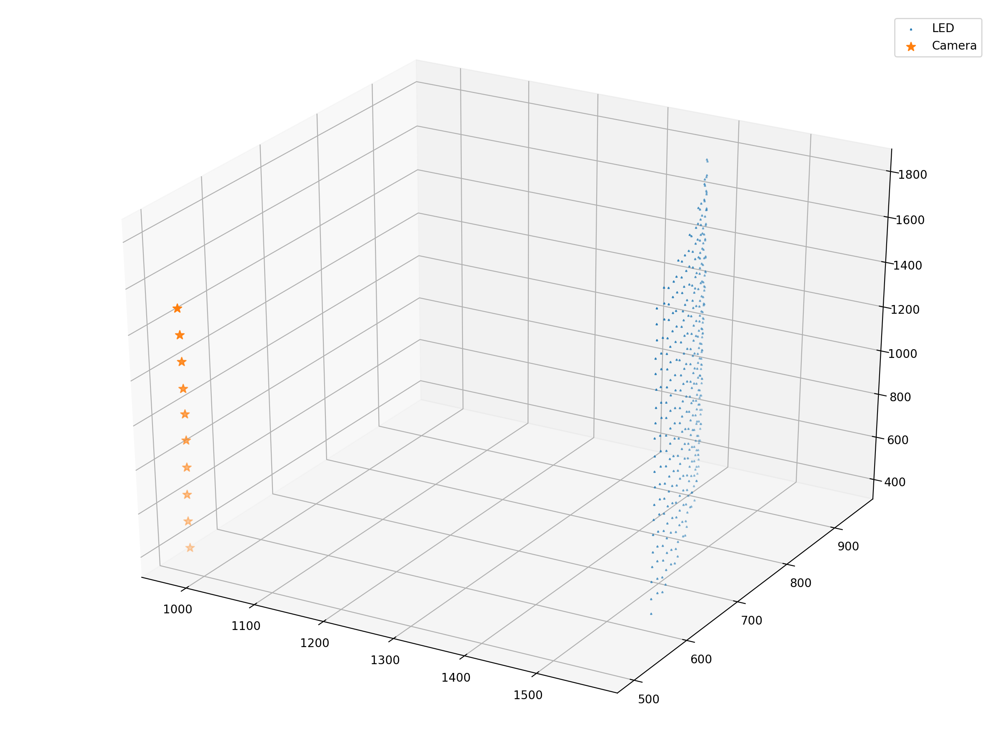

=== Gaussian errors on feature image locations: 3.0 ===
Smeared feature in image counts: Counter({5: 111, 6: 93, 4: 60, 3: 54, 2: 24, 1: 18})
image 0 reprojection errors:    average: 6.0322971268046075    max: 16.092299438292955
image 1 reprojection errors:    average: 6.613434251454759    max: 14.994917650215179
image 2 reprojection errors:    average: 6.743166102690687    max: 18.925874567040783
image 3 reprojection errors:    average: 7.165963841523501    max: 15.786320611726216
image 4 reprojection errors:    average: 7.041155967837274    max: 16.74569335046606
image 5 reprojection errors:    average: 6.388500575676884    max: 15.668658437002266
image 6 reprojection errors:    average: 7.196479987383964    max: 19.34613169500236
image 7 reprojection errors:    average: 6.437889835928923    max: 17.480111626265813
image 8 reprojection errors:    average: 6.113682992069873    max: 14.7855194753195
image 9 reprojection errors:    average: 6.477256444711788    max: 16.397284811675743
 

<IPython.core.display.Javascript object>


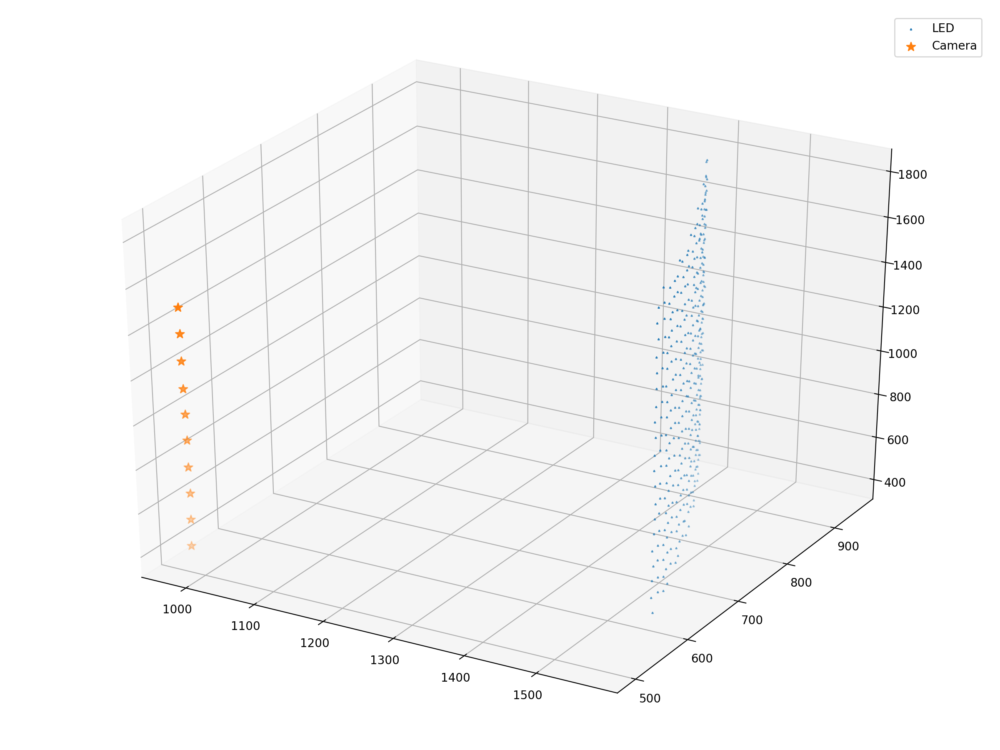

In [30]:
fig_bolt_pos, ax_bolt_pos = make_fig("Reconstructed bolt position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_pos, ax_ring_pos = make_fig("Reconstructed bolt ring centre position error with {} bolts/PMT".format(bolt_count), "Distance from true to reco. position [cm]")
fig_ring_ang, ax_ring_ang = make_fig("Reconstructed bolt ring orientation error with {} bolts/PMT".format(bolt_count), "Angle between true and reco. orientation [deg]")
for pixel_error in [0.5, 1.0, 2.0, 3.0]:
    print("=== Gaussian errors on feature image locations:", pixel_error, "===")
    smeared_feature_locations = get_smeared_feature_locations(image_feature_locations, pixel_error)
    fitter = setup_bolt_simulation(bolt_positions, smeared_feature_locations, focal_length, principle_point, radial_distortion)    
    reco_bolt_positions, position_errors = run_bolt_fit(fitter, bolt_positions)
    centre_errors = get_ring_centre_errors(reco_bolt_positions, ring_positions, bolt_count)
    orientation_errors = get_ring_orientation_errors(reco_bolt_positions, ring_orientations, bolt_count)
    ax_bolt_pos.hist(position_errors, bins=20, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, position_errors.mean()))
    ax_ring_pos.hist(centre_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} cm".format(pixel_error, centre_errors.mean()))
    ax_ring_ang.hist(orientation_errors, bins=10, histtype='step', lw=1.5, label="{} pixel error: mean = {:.2f} deg".format(pixel_error, orientation_errors.mean()))
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(bolt_positions, reco_bolt_positions)
    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(fitter.camera_rotations, fitter.camera_translations)
    plot_reconstruction(reco_transformed, reco_cam_positions)
ax_bolt_pos.legend(loc='upper right')
ax_ring_pos.legend(loc='upper right')
ax_ring_ang.legend(loc='upper right')